# Functions

## imports

In [14]:
from malab import *
from malab.datamanagement import SlabFile
from os.path import join
from glob import glob
from malab.dsfit import *
import os 
import datetime
from numpy import *
from tempfile import TemporaryFile
%matplotlib inline
from matplotlib.pyplot import *
from scipy.signal import savgol_filter
import scipy.constants as constants

font = {'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

from malab.instruments.voltsource import *
from malab.instruments.instrumenttypes import *
from malab.instruments.PNAX import N5242A
from malab.dsfit import fithanger_new_withQc
from time import sleep
from copy import *

## Instrument setup

In [ ]:
### YOKO setup
YOKO_4 = "192.168.1.77"
YOKO_2 = "192.168.1.57"
YOKO_5 = "192.168.1.141"

dcflux2 = YokogawaGS200(address=YOKO_5) # dc coil
dcflux2.recv_length = 1024
print(dcflux2.recv_length)
print(dcflux2.get_id())
print(dcflux2.get_id())
dcflux2.set_mode('current')
dcflux2.set_range(0.01)  # 10mA range
dcflux2.set_output(True)

### NWA (PNAX) setup
nwa = N5242A("N5242A", address="192.168.1.44", timeout=10e3) # pnax
print(nwa.get_id())

print('Deviced Connected')

# initial NWA configuration values
num_qubits = int(8)

# read_power = [-60, -65, -60, -60, -60, -60, -55, -55]
read_power = [-60]*num_qubits
read_freq_start = [6.11e9, 6.140e9, 6.16e9, 6.19e9, 6.215e9, 6.235e9, 6.272e9, 6.29e9]
read_freq_stop = [6.136e9, 6.16e9, 6.18e9, 6.215e9, 6.234e9, 6.252e9, 6.282e9, 6.312e9]

# drive_power = [-15, -15, -15, -15, -15, -20, -20, -20] 
drive_power = [-15]*num_qubits # -25 w 10 attenuation
drive_freq_start = [3.2e9, 3.2e9, 3.2e9, 3.2e9, 3.2e9, 3.2e9, 3.2e9, 3.2e9]
drive_freq_stop = [5.7e9, 5.7e9, 5.7e9, 5.7e9, 5.7e9, 5.7e9, 5.7e9, 5.7e9]

# single tone
sweep_pts = 2001 #601
ifbw = [2000]*num_qubits
avgs = 3 #10

# two tone
sweep_pts2 = 4001  #1001 #501|
ifbw2 = [1000]*num_qubits
avgs2 = 10

delay = 0

### DACs setup
'''
labelled by flux lines
C5: Q0, C6: Q1, C7: Q2, C8: Q3
D1: Q4, D2: Q5, D3: Q6, D4: D4
'''
dac_C5toC8 = AD5780(address='192.168.1.66')
dac_D1toD4 = AD5780(address='192.168.1.156')
# dacs[qubit index][dac address or channel number]
dacs = [[dac_C5toC8, 1], [dac_C5toC8, 2],[dac_C5toC8, 3],[dac_C5toC8, 4],
        [dac_D1toD4, 1], [dac_D1toD4, 2],[dac_D1toD4, 3],[dac_D1toD4, 4]]
# initialize when power to DACs is reset
# dac_C5toC8.initialize()
# dac_D1toD4.initialize()
time.sleep(1)

#V/s or mA/s
dac_rate = 0.05

# converts DAC units to current value
def digit_to_curr(x):
    return 20*x/(2**18)-10

# initial offset of DAC channels, measured with volt meter
dac_offset = array([-0.002, -0.004, -0.003, -0.003, -0.004, -0.009, -0.02, -0.024])
diag_offset = dac_offset # set so background is zero, not needed here
#!!!! need to double check units here, w/o crosstalk matrix it should be V
flux_sweep = linspace(-0.1,0.1,11) # in unit not flux quantu, but V w/o correction

# numpts = [41]*num_qubits
# diag_offset = [0.0]*num_qubits
# diag_range = [1e-3]*num_qubits # yoko is in Ampere

# offdiag_range = diag_range
# offdiag_offset = diag_offset




1024
YOKOGAWA,GS210,90Z317691,2.02
YOKOGAWA,GS210,90Z317691,2.02
Keysight Technologies,N5242B,MY58422393,A.13.60.06

Deviced Connected


## Data functions

In [16]:
### drive flux lines

In [17]:
def drive_YOKO(pt):

    print("Driving YOKO at (%.3f) mA" % (pt[0]))
    dcflux2.ramp_current(pt[0]*1e-3, 0.0005) # second argument is rate?
    time.sleep(0.2)

def drive_DACs(pt):

    # I'm leaving this hardcoded for 8 qubits for now - Hebah 2024 12 16
    print("Driving DAC at ( %.3f, %.3f, %.3f, %.3f,%.3f, %.3f, %.3f, %.3f ) mA" %(pt[1], pt[2], pt[3], pt[4], pt[5], pt[6], pt[7], pt[8]))

    for ii in range(len(dacs)):
        print('\n')
        print('Flux line for qubit ', ii)
        print(dacs[ii][0])
        print("Driving DAC at (%.3f) mA" % (pt[ii+1]-dac_offset[ii]))
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])
        dac_old = digit_to_curr(int(dacs[ii][0].get_voltage(dacs[ii][1])[:-2]))
        print('old reading = ', dac_old)
        dacs[ii][0].ramp(dacs[ii][1], pt[ii+1], dac_rate)
        time.sleep(1.5 * abs(dac_old - pt[ii+1]) / dac_rate + 5)
        time.sleep(5.0)
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])
        dacs[ii][0].get_voltage(dacs[ii][1])  # to clear the readout queue

def drive_DAC(pt, index):
    ii = index
    print('Driving DAC ' + str(index) + ' at ( %.3f ) mA' %(pt[ii+1]))

    
    print('\n')
    print('Flux line for qubit ', ii)
    print(dacs[ii][0])
    print("Driving DAC at (%.3f) mA" % (pt[ii+1]-dac_offset[ii]))
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])
    dac_old = digit_to_curr(int(dacs[ii][0].get_voltage(dacs[ii][1])[:-2]))
    print('old reading = ', dac_old)
    dacs[ii][0].ramp(dacs[ii][1], pt[ii+1], dac_rate)
    time.sleep(1.5 * abs(dac_old - pt[ii+1]) / dac_rate + 5)
    time.sleep(5.0)
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])
    dacs[ii][0].get_voltage(dacs[ii][1])  # to clear the readout queue

def drive_Yoko_and_DACs(pt):
    drive_YOKO(pt)
    drive_DACs(pt)


### Single

In [18]:
# pt_target = [dc coil, f0, f1, f2, f3, f4, f5, f6, f7]
def flux_msmt(pt_target, fname_tag, msmt_index=0):
    

    print("Configuring the PNAX")
    # turning off the pulses
    nwa.write("SENS:PULS0 0")  # automatically sync ADC to pulse gen
    nwa.write("SENS:PULS1 0")
    nwa.write("SENS:PULS2 0")
    nwa.write("SENS:PULS3 0")
    nwa.write("SENS:PULS4 0")
    # turning on the inverting
    nwa.write("SENS:PULS1:INV 1")
    nwa.write("SENS:PULS2:INV 1")
    nwa.write("SENS:PULS3:INV 1")
    nwa.write("SENS:PULS4:INV 1")

    nwa.set_timeout(10E3)
    nwa.clear_traces()
    nwa.setup_measurement("S21")
    # nwa.set_ifbw(ifbw[Res_index])
    # nwa.set_sweep_points(sweep_pts)
    # nwa.setup_take(averages_state=True)
    # nwa.set_averages_and_group_count(avgs, True)
    # print "PNAX Configured. IFBW = %f Hz, NumPts = %d, Avgs = %d " %(ifbw[Res_index],sweep_pts,avgs)

    dummy_freq = 5.0e9
    dummy_power = -50

    if isTakeData:

        vary_param = "flux"
        print("Swept Parameter: %s" % (vary_param))

        fname_list = []
        for jj in range(num_qubits):
            Qind = jj
            prefix = "flux_map-" + str(datetime.date.today()) + "_r" + str(Qind) + fname_tag

            fname = get_next_filename(expt_path, prefix, suffix='.h5')
            print(fname)
            fname = os.path.join(expt_path, fname)
            fname_list = np.append(fname_list,fname)



        print('\n\n')
        print('flux target =', pt_target)
        pt = (pt_target)
        print('No crosstalk matrix here!')
        print('flux actual =', pt)
        print('\n\n')

        if set_YOKO:
            drive_YOKO(pt)
        
        if set_DACs:
            drive_DACs(pt)

        print('\n\n')

        # sweep all qubits
        if measureAllQubits:
            for jj in range(num_qubits):

                Qind = jj

                with SlabFile(fname_list[jj], 'a') as f:
                    print("ISD:LJFJF")
                    print(nwa.get_settings())
                    f.save_settings(nwa.get_settings())

                print("Set up for a Single Tone Sweep")
                nwa.set_ifbw(ifbw[Qind])
                nwa.set_sweep_points(sweep_pts)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs, True)
                nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                probe_start=read_freq_start[Qind],
                                                probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                two_tone=0)

                data = nwa.take_one_in_mag_phase()

                fpoints = data[0]
                mags = data[1]
                phases = data[2]
                print("finished downloading")
                #time.sleep(na.get_query_sleep())

                freq_peak = fpoints[argmin(mags)]

                print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                nwa.set_ifbw(ifbw2[Qind])
                nwa.set_sweep_points(sweep_pts2)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs2, True)
                nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                read_power=read_power[Qind],
                                                probe_start=drive_freq_start[Qind],
                                                probe_stop=drive_freq_stop[Qind],
                                                probe_power=drive_power[Qind], two_tone=1)

                data = nwa.take_one_in_mag_phase()

                fpoints2 = data[0]
                mags2 = data[1]
                phases2 = data[2]
                print("finished downloading")
                print('\n')
                # time.sleep(na.get_query_sleep())

                #freq_peak_q = fpoints2[argmax(mags2)]
                #print "QubitFreq =", freq_peak_q

                with SlabFile(fname_list[Qind], 'a') as f:
                    f.append_pt((vary_param + 'dc_pts'), pt_target[0])
                    f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                    for ii in range(num_qubits):
                        f.append_pt((vary_param + str(ii) + '_pts'), pt_target[ii+1])
                        f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                    f.append_line('fpts-r', fpoints)
                    f.append_line('mags-r', mags)
                    f.append_line('phases-r', phases)
                    f.append_line('fpts-q', fpoints2)
                    f.append_line('mags-q', mags2)
                    f.append_line('phases-q', phases2)
                    # f.append_line('read_freq',read_freqs)
                    f.append_pt('read_power', read_power[Qind])
                    f.append_pt('probe_power', drive_power[Qind])
                    f.append_pt('read_freq', freq_peak)
        else: 
            jj = msmt_index
            Qind = jj

            with SlabFile(fname_list[jj], 'a') as f:
                print("ISD:LJFJF")
                print(nwa.get_settings())
                f.save_settings(nwa.get_settings())

            print("Set up for a Single Tone Sweep")
            nwa.set_ifbw(ifbw[Qind])
            nwa.set_sweep_points(sweep_pts)
            nwa.setup_take(averages_state=True)
            nwa.set_averages_and_group_count(avgs, True)
            nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                            probe_start=read_freq_start[Qind],
                                            probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                            two_tone=0)

            data = nwa.take_one_in_mag_phase()

            fpoints = data[0]
            mags = data[1]
            phases = data[2]
            print("finished downloading")
            #time.sleep(na.get_query_sleep())

            freq_peak = fpoints[argmin(mags)]

            print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
            nwa.set_ifbw(ifbw2[Qind])
            nwa.set_sweep_points(sweep_pts2)
            nwa.setup_take(averages_state=True)
            nwa.set_averages_and_group_count(avgs2, True)
            nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                            read_power=read_power[Qind],
                                            probe_start=drive_freq_start[Qind],
                                            probe_stop=drive_freq_stop[Qind],
                                            probe_power=drive_power[Qind], two_tone=1)

            data = nwa.take_one_in_mag_phase()

            fpoints2 = data[0]
            mags2 = data[1]
            phases2 = data[2]
            print("finished downloading")
            print('\n')
            # time.sleep(na.get_query_sleep())

            #freq_peak_q = fpoints2[argmax(mags2)]
            #print "QubitFreq =", freq_peak_q

            with SlabFile(fname_list[Qind], 'a') as f:
                f.append_pt((vary_param + 'dc_pts'), pt_target[0])
                f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                for ii in range(num_qubits):
                    f.append_pt((vary_param + str(ii) + '_pts'), pt_target[ii+1])
                    f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                f.append_line('fpts-r', fpoints)
                f.append_line('mags-r', mags)
                f.append_line('phases-r', phases)
                f.append_line('fpts-q', fpoints2)
                f.append_line('mags-q', mags2)
                f.append_line('phases-q', phases2)
                # f.append_line('read_freq',read_freqs)
                f.append_pt('read_power', read_power[Qind])
                f.append_pt('probe_power', drive_power[Qind])
                f.append_pt('read_freq', freq_peak)


        print(fname)

### Sweep

In [19]:
# pt_target = [dc coil, f0, f1, f2, f3, f4, f5, f6, f7]
def flux_msmt_sweep(pt_target, pt_target_sweep, fname_tag, sweep_index, msmt_index=0):
    

    print("Configuring the PNAX")
    # turning off the pulses
    nwa.write("SENS:PULS0 0")  # automatically sync ADC to pulse gen
    nwa.write("SENS:PULS1 0")
    nwa.write("SENS:PULS2 0")
    nwa.write("SENS:PULS3 0")
    nwa.write("SENS:PULS4 0")
    # turning on the inverting
    nwa.write("SENS:PULS1:INV 1")
    nwa.write("SENS:PULS2:INV 1")
    nwa.write("SENS:PULS3:INV 1")
    nwa.write("SENS:PULS4:INV 1")

    nwa.set_timeout(10E3)
    nwa.clear_traces()
    nwa.setup_measurement("S21")
    # nwa.set_ifbw(ifbw[Res_index])
    # nwa.set_sweep_points(sweep_pts)
    # nwa.setup_take(averages_state=True)
    # nwa.set_averages_and_group_count(avgs, True)
    # print "PNAX Configured. IFBW = %f Hz, NumPts = %d, Avgs = %d " %(ifbw[Res_index],sweep_pts,avgs)

    dummy_freq = 5.0e9
    dummy_power = -50
    pt_target_temp = copy(pt_target)

    if isTakeData:

        vary_param = "flux"
        print("Swept Parameter: %s" % (vary_param))

        fname_list = []
        for jj in range(num_qubits):
            Qind = jj
            prefix = "flux_map-" + str(datetime.date.today()) + "_r" + str(Qind) + "_f" + str(sweep_index) + fname_tag

            fname = get_next_filename(expt_path, prefix, suffix='.h5')
            print(fname)
            fname = os.path.join(expt_path, fname)
            fname_list = np.append(fname_list,fname)

        
        for ii,sweep_target in enumerate(pt_target_sweep):
            print('\n\n')
            print('flux target =', sweep_target)
            pt_target_temp[sweep_index+1] = sweep_target
            pt = (pt_target_temp) * np.ones((num_qubits+1,num_qubits+1))[:, sweep_index+1]
            print('No crosstalk matrix here!')
            print('flux actual =', pt)
            print('\n\n')

            if sweep_index == -1:
                drive_YOKO(pt_target_temp)
            else:
                drive_DAC(pt_target_temp, sweep_index)

            print('\n\n')

            # sweep all qubits
            if measureAllQubits:
                for jj in range(num_qubits):

                    Qind = jj

                    with SlabFile(fname_list[jj], 'a') as f:
                        print("ISD:LJFJF")
                        print(nwa.get_settings())
                        f.save_settings(nwa.get_settings())

                    print("Set up for a Single Tone Sweep")
                    nwa.set_ifbw(ifbw[Qind])
                    nwa.set_sweep_points(sweep_pts)
                    nwa.setup_take(averages_state=True)
                    nwa.set_averages_and_group_count(avgs, True)
                    nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                    probe_start=read_freq_start[Qind],
                                                    probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                    two_tone=0)

                    data = nwa.take_one_in_mag_phase()

                    fpoints = data[0]
                    mags = data[1]
                    phases = data[2]
                    print("finished downloading")
                    #time.sleep(na.get_query_sleep())

                    freq_peak = fpoints[argmin(mags)]

                    print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                    nwa.set_ifbw(ifbw2[Qind])
                    nwa.set_sweep_points(sweep_pts2)
                    nwa.setup_take(averages_state=True)
                    nwa.set_averages_and_group_count(avgs2, True)
                    nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                    read_power=read_power[Qind],
                                                    probe_start=drive_freq_start[Qind],
                                                    probe_stop=drive_freq_stop[Qind],
                                                    probe_power=drive_power[Qind], two_tone=1)

                    data = nwa.take_one_in_mag_phase()

                    fpoints2 = data[0]
                    mags2 = data[1]
                    phases2 = data[2]
                    print("finished downloading")
                    print('\n')
                    # time.sleep(na.get_query_sleep())

                    #freq_peak_q = fpoints2[argmax(mags2)]
                    #print "QubitFreq =", freq_peak_q

                    with SlabFile(fname_list[Qind], 'a') as f:
                        f.append_pt((vary_param + 'dc_pts'), pt_target_temp[0])
                        f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                        for ii in range(num_qubits):
                            f.append_pt((vary_param + str(ii) + '_pts'), pt_target_temp[ii+1])
                            f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                        f.append_line('fpts-r', fpoints)
                        f.append_line('mags-r', mags)
                        f.append_line('phases-r', phases)
                        f.append_line('fpts-q', fpoints2)
                        f.append_line('mags-q', mags2)
                        f.append_line('phases-q', phases2)
                        # f.append_line('read_freq',read_freqs)
                        f.append_pt('read_power', read_power[Qind])
                        f.append_pt('probe_power', drive_power[Qind])
                        f.append_pt('read_freq', freq_peak)
            else: 
                jj = msmt_index
                Qind = jj

                with SlabFile(fname_list[jj], 'a') as f:
                    print("ISD:LJFJF")
                    print(nwa.get_settings())
                    f.save_settings(nwa.get_settings())

                print("Set up for a Single Tone Sweep")
                nwa.set_ifbw(ifbw[Qind])
                nwa.set_sweep_points(sweep_pts)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs, True)
                nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                probe_start=read_freq_start[Qind],
                                                probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                two_tone=0)

                data = nwa.take_one_in_mag_phase()

                fpoints = data[0]
                mags = data[1]
                phases = data[2]
                print("finished downloading")
                #time.sleep(na.get_query_sleep())

                freq_peak = fpoints[argmin(mags)]

                print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                nwa.set_ifbw(ifbw2[Qind])
                nwa.set_sweep_points(sweep_pts2)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs2, True)
                nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                read_power=read_power[Qind],
                                                probe_start=drive_freq_start[Qind],
                                                probe_stop=drive_freq_stop[Qind],
                                                probe_power=drive_power[Qind], two_tone=1)

                data = nwa.take_one_in_mag_phase()

                fpoints2 = data[0]
                mags2 = data[1]
                phases2 = data[2]
                print("finished downloading")
                print('\n')
                # time.sleep(na.get_query_sleep())

                #freq_peak_q = fpoints2[argmax(mags2)]
                #print "QubitFreq =", freq_peak_q

                with SlabFile(fname_list[Qind], 'a') as f:
                    f.append_pt((vary_param + 'dc_pts'), pt_target_temp[0])
                    f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                    for ii in range(num_qubits):
                        f.append_pt((vary_param + str(ii) + '_pts'), pt_target_temp[ii+1])
                        f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                    f.append_line('fpts-r', fpoints)
                    f.append_line('mags-r', mags)
                    f.append_line('phases-r', phases)
                    f.append_line('fpts-q', fpoints2)
                    f.append_line('mags-q', mags2)
                    f.append_line('phases-q', phases2)
                    # f.append_line('read_freq',read_freqs)
                    f.append_pt('read_power', read_power[Qind])
                    f.append_pt('probe_power', drive_power[Qind])
                    f.append_pt('read_freq', freq_peak)

        

        print(fname)

## Plotting functions

In [20]:
qubit_order = []
qubit_order.append(range(num_qubits))
qubit_order.append([4, 6, 1, 3, 5, 0, 7, 2])
qubit_order.append([5, 2, 7, 3, 0, 4, 1, 6])

print(qubit_order)

[range(0, 8), [4, 6, 1, 3, 5, 0, 7, 2], [5, 2, 7, 3, 0, 4, 1, 6]]


In [21]:
def plot_resonators(pt_target, filename_list, flux_index=0):

    figure(figsize=(20, 6), dpi=80)

    for ii,filename in enumerate(filename_list):
        # print(filename)
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    flux = array(a['flux'+str(flux_index)+'_pts'])
                    freq = array(a['fpts-'+'r'])[flux_index]
                    mags = array(a['mags-'+'r'])[flux_index]
                    
                    plot(freq/1e9,mags,color = 'C'+str(ii),label = 'Q'+str(qubit_order[1][ii])+': '+str(round(freq[np.argmin(mags)]/1e9,2)))
                    axvline(freq[np.argmin(mags)]/1e9, ls='--',color = 'C'+str(ii))
                    print("Resonator frequency for r"+str(ii)+": "+str(freq[np.argmin(mags)]/1e9))

    title("Resonators at " + str(pt_target))
    xlabel('Frequency (GHz)')
    ylabel('Power (dBm)')
    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.01,1),loc = 'upper left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')

def plot_qubits(pt_target, filename_list, flux_index=0):

    figure(figsize=(20, 6), dpi=80)

    for ii,filename in enumerate(filename_list):
    # for filename in (filename_list[0][0]):
    #     ii=0
        # print(filename)
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    flux = array(a['flux'+str(flux_index)+'_pts'])
                    freq = array(a['fpts-'+'q'])[flux_index]
                    mags = array(a['mags-'+'q'])[flux_index]
                    
                    plot(freq/1e9,mags,color = 'C'+str(ii),label = 'Q'+str(qubit_order[1][ii])+': '+str(round(freq[np.argmax(mags)]/1e9,2)))
                    axvline(freq[np.argmax(mags)]/1e9, ls='--',color = 'C'+str(ii))
                    print("Qubit frequency for r"+str(ii)+": "+str(freq[np.argmax(mags)]/1e9))

    title("Qubits at " + str(pt_target))
    xlabel('Frequency (GHz)')
    ylabel('Power (dBm)')
    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.05,1),loc = 'upper left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')

def plot_qubit(filename, qubit_index, flux_index=0):
    figure(figsize=(20, 6), dpi=80)

    # for filename in (filename_list[0][0]):
    #     ii=0
        # print(filename)

    ii = qubit_index

    if os.path.isfile(filename):
        if os.path.getsize(filename) > 1000*10:  #in bytes
            with SlabFile(filename,'r') as a:
                flux = array(a['flux'+str(flux_index)+'_pts'])
                freq = array(a['fpts-'+'q'])[flux_index]
                mags = array(a['mags-'+'q'])[flux_index]
                
                plot(freq/1e9,mags,color = 'C'+str(ii),label = 'Q'+str(qubit_order[1][ii])+': '+str(round(freq[np.argmax(mags)]/1e9,2)))
                axvline(freq[np.argmax(mags)]/1e9, ls='--',color = 'C'+str(ii))
                print("Qubit frequency for r"+str(ii)+": "+str(freq[np.argmax(mags)]/1e9))

    # title("Qubits at " + str(pt_target))
    xlabel('Frequency (GHz)')
    ylabel('Power (dBm)')
    legend()



In [59]:
expt_path = "M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test"
fname_tag = "test"

isTakeData = 1
set_YOKO = 0
set_DACs = 0
measureAllQubits = 1

pt = [0, -1, 0, 0, 0, 0, 0, 0, 0]
flux_msmt(pt, fname_tag)

Configuring the PNAX
Swept Parameter: flux
00005_flux_map-2025-01-21_r0test.h5
00005_flux_map-2025-01-21_r1test.h5
00005_flux_map-2025-01-21_r2test.h5
00005_flux_map-2025-01-21_r3test.h5
00005_flux_map-2025-01-21_r4test.h5
00005_flux_map-2025-01-21_r5test.h5
00005_flux_map-2025-01-21_r6test.h5
00005_flux_map-2025-01-21_r7test.h5



flux target = [0, -1, 0, 0, 0, 0, 0, 0, 0]
No crosstalk matrix here!
flux actual = [0, -1, 0, 0, 0, 0, 0, 0, 0]






ISD:LJFJF
{'start': 3200000000.0, 'stop': 5700000000.0, 'power': -60.0, 'ifbw': 1000.0, 'sweep_points': 4001, 'averaging': True, 'averages': 10}
Set up for a Single Tone Sweep
TWO TONE OFF
Turning off the port 3
finished downloading
Set up for Two Tone Measurement, ReadFreq = 6127667000.0
TWO TONE ON
finished downloading


ISD:LJFJF
{'start': 3200000000.0, 'stop': 5700000000.0, 'power': -60.0, 'ifbw': 1000.0, 'sweep_points': 4001, 'averaging': True, 'averages': 10}
Set up for a Single Tone Sweep
TWO TONE OFF
Turning off the port 3
finished do

['M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r0test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r1test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r2test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r3test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r4test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r5test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r6test.h5', 'M:/malab/_Data/20250120 - Santi - RFSoC tprocv2 - LL8qubit T1/data/test\\00005_flux_map-2025-01-21_r7test.h5']
Resonator frequency for r0: 6.127667
Resonator frequency for r1: 6.15084
Resonator frequency for r2: 6.

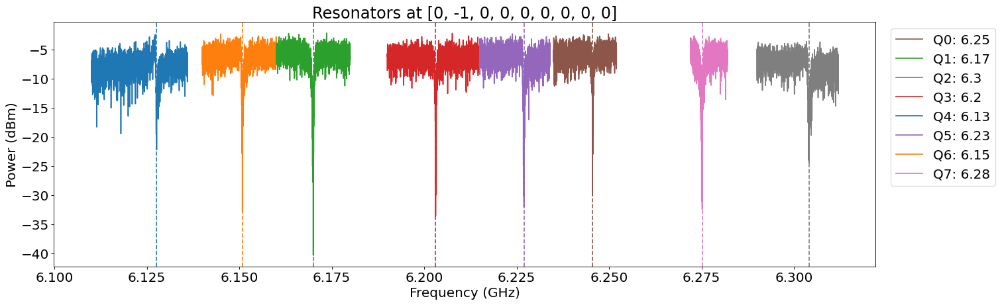

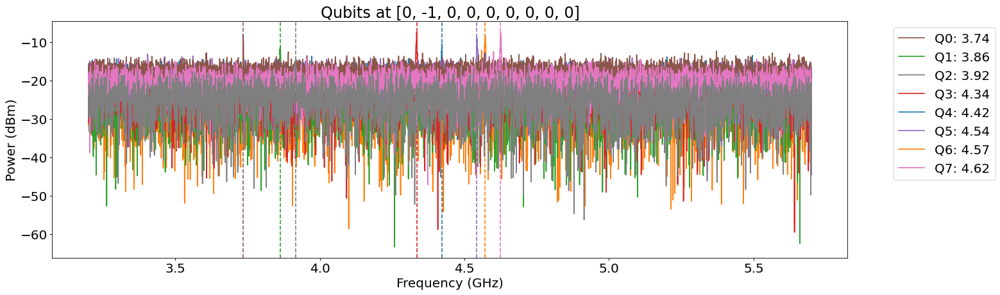

In [63]:
filename_list = []
for q in range(num_qubits):
    filename_list.append(expt_path+r'\00005_flux_map-2025-01-21_r'+str(q)+fname_tag+'.h5')
print(filename_list)

plot_resonators(pt, filename_list)
# xlim(6.12,6.13)
plot_qubits(pt, filename_list)
# xlim(3.72, 3.75)

# Crosstalk

## Data

### finding slope for each qubit

In [123]:
# flux configurations
zero_flux = [0]*(num_qubits+1) 
upper_sweet_spot = [1, 0, 0, 0, 0, 0, 0, 0, 0,]
# trying to pick a value on the slope -> targetting 4.5, 
# but this is semi difficult bc it hits the DAC range limit with the current dc coil value
slopes = [
    [1, -8.5, 0, 0, 0, 0, 0, 0, 0,], # Q0
    [1, 0, -8.5, 0, 0, 0, 0, 0, 0,], # Q1
    [1, 0, 0, -8.9, 0, 0, 0, 0, 0,], # Q2
    [1, 0, 0, 0, 6.5, 0, 0, 0, 0,], # Q3
    [1, 0, 0, 0, 0, 6.2, 0, 0, 0,], # Q4
    [1, 0, 0, 0, 0, 0, -8.8, 0, 0,], # Q5
    [1, 0, 0, 0, 0, 0, 0, -7.5, 0,], # Q6
    [1, 0, 0, 0, 0, 0, 0, 0, 4.3,]  # Q7
]

In [23]:
### export path -  this section can get reset depending on what you are doing
expt_path = os.getcwd() + '\data_crosstalk'
fname_tag = "_finding_slope"

isTakeData = 1
set_YOKO = 0
set_DACs = 1
measureAllQubits = 1

#### Q0

In [24]:
qubit_index = 0
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00000_flux_map-2025-01-17_r0_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r1_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r2_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r3_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r4_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r5_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r6_finding_slope_for_q0.h5
00000_flux_map-2025-01-17_r7_finding_slope_for_q0.h5



flux target = [1, -8.5, 0, 0, 0, 0, 0, 0, 0]
No crosstalk matrix here!
flux actual = [1, -8.5, 0, 0, 0, 0, 0, 0, 0]



Driving DAC at ( -8.500, 0.000, 0.000, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (-8.498) mA
old reading =  -8.50006103515625
target 19660
end of ramp - RAMP



Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP



Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux li

['data_crosstalk\\00000_flux_map-2025-01-17_r0_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r1_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r3_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r4_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r6_finding_slope_for_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r7_finding_slope_for_q0.h5']
Qubit frequency for r0: 5.02125
Qubit frequency for r1: 5.2175
Qubit frequency for r2: 5.21375
Qubit frequency for r3: 5.0225
Qubit frequency for r4: 4.9525
Qubit frequency for r5: 4.5275
Qubit frequency for r6: 5.07
Qubit frequency for r7: 5.17


Text(0.5, 1.0, 'Qubit 0 at -8.5 mA')

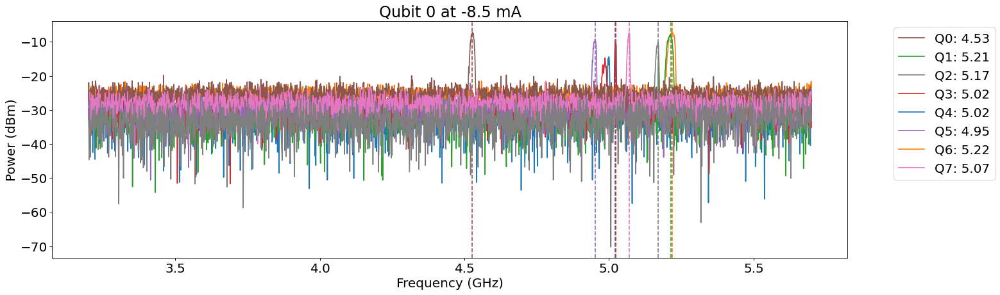

In [28]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q1

In [30]:
qubit_index = 1
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00000_flux_map-2025-01-17_r0_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r1_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r2_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r3_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r4_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r5_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r6_finding_slope_for_q1.h5
00000_flux_map-2025-01-17_r7_finding_slope_for_q1.h5



flux target = [1, 0, -8.5, 0, 0, 0, 0, 0, 0]
No crosstalk matrix here!
flux actual = [1, 0, -8.5, 0, 0, 0, 0, 0, 0]



Driving DAC at ( 0.000, -8.500, 0.000, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  -8.50006103515625
target 131072
end of ramp - None


Flux line for qubit  1
Driving DAC at (-8.496) mA
old reading =  0.0
target 19660
end of ramp - None


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line

['data_crosstalk\\00000_flux_map-2025-01-17_r0_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r1_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r3_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r4_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r6_finding_slope_for_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r7_finding_slope_for_q1.h5']
Qubit frequency for r0: 5.035
Qubit frequency for r1: 5.22625
Qubit frequency for r2: 4.49125
Qubit frequency for r3: 5.05625
Qubit frequency for r4: 4.96875
Qubit frequency for r5: 5.0875
Qubit frequency for r6: 5.0675
Qubit frequency for r7: 5.20625


Text(0.5, 1.0, 'Qubit 1 at -8.5 mA')

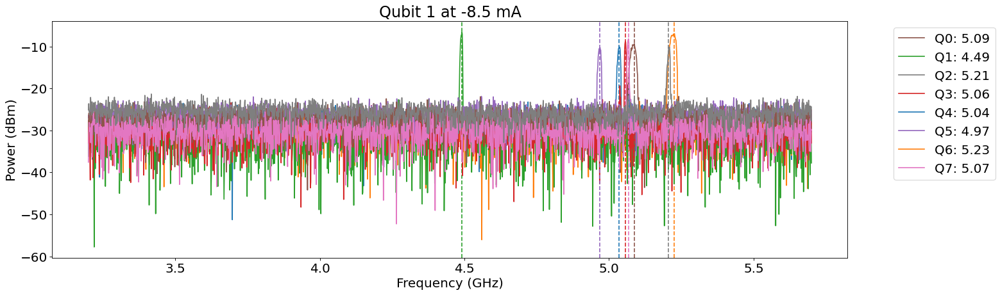

In [31]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q2
tried (in order): -8.5, -8.8, -8.9

In [124]:
qubit_index = 2
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00002_flux_map-2025-01-17_r0_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r1_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r2_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r3_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r4_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r5_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r6_finding_slope_for_q2.h5
00002_flux_map-2025-01-17_r7_finding_slope_for_q2.h5



flux target = [1, 0, 0, -8.9, 0, 0, 0, 0, 0]
No crosstalk matrix here!
flux actual = [1, 0, 0, -8.9, 0, 0, 0, 0, 0]



Driving DAC at ( 0.000, 0.000, -8.900, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  2
Driving DAC at (-8.897) mA
old reading =  -8.800048828125
target 14417
end of ramp - None


Flux line f

['data_crosstalk\\00002_flux_map-2025-01-17_r0_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r1_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r2_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r3_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r4_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r5_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r6_finding_slope_for_q2.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r7_finding_slope_for_q2.h5']
Qubit frequency for r0: 5.09125
Qubit frequency for r1: 5.22875
Qubit frequency for r2: 5.2425
Qubit frequency for r3: 5.08125
Qubit frequency for r4: 4.9825
Qubit frequency for r5: 5.045
Qubit frequency for r6: 5.06125
Qubit frequency for r7: 4.55125


Text(0.5, 1.0, 'Qubit 2 at -8.9 mA')

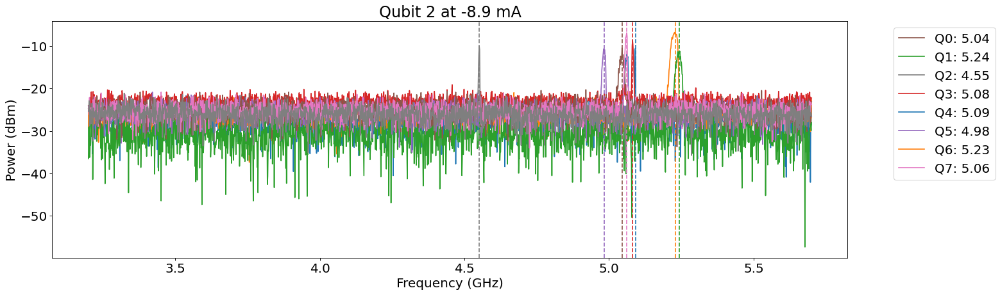

In [125]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00002_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q3
tried (in order): -4.5, -8.5, -6.5, 8.5, 6.5

In [52]:
qubit_index = 3
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00004_flux_map-2025-01-17_r0_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r1_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r2_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r3_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r4_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r5_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r6_finding_slope_for_q3.h5
00004_flux_map-2025-01-17_r7_finding_slope_for_q3.h5



flux target = [1, 0, 0, 0, 6.5, 0, 0, 0, 0]
No crosstalk matrix here!
flux actual = [1, 0, 0, 0, 6.5, 0, 0, 0, 0]



Driving DAC at ( 0.000, 0.000, 0.000, 6.500,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3
Dri

['data_crosstalk\\00004_flux_map-2025-01-17_r0_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r1_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r2_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r3_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r4_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r5_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r6_finding_slope_for_q3.h5', 'data_crosstalk\\00004_flux_map-2025-01-17_r7_finding_slope_for_q3.h5']
Qubit frequency for r0: 5.3125
Qubit frequency for r1: 5.37375
Qubit frequency for r2: 5.24375
Qubit frequency for r3: 4.50875
Qubit frequency for r4: 5.25625
Qubit frequency for r5: 5.0825
Qubit frequency for r6: 5.315
Qubit frequency for r7: 5.30625


Text(0.5, 1.0, 'Qubit 3 at 6.5 mA')

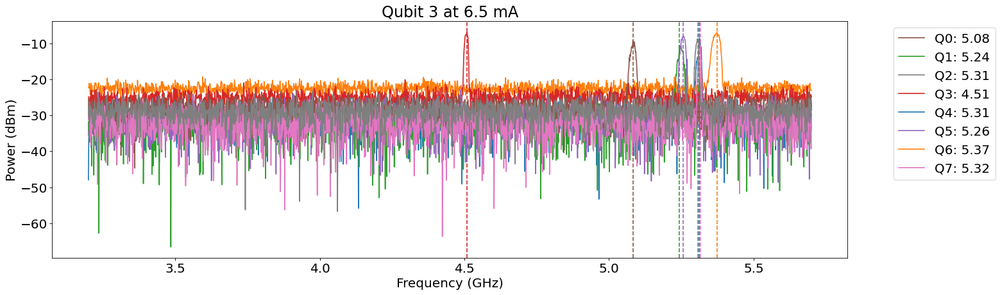

In [53]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00004_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q4
tried (in order): -5, -2.5, 3, 5, 6.5, 6, 6.2

In [77]:
qubit_index = 4
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00006_flux_map-2025-01-17_r0_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r1_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r2_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r3_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r4_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r5_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r6_finding_slope_for_q4.h5
00006_flux_map-2025-01-17_r7_finding_slope_for_q4.h5



flux target = [1, 0, 0, 0, 0, 6.2, 0, 0, 0]
No crosstalk matrix here!
flux actual = [1, 0, 0, 0, 0, 6.2, 0, 0, 0]



Driving DAC at ( 0.000, 0.000, 0.000, 0.000,6.200, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3
Dri

['data_crosstalk\\00006_flux_map-2025-01-17_r0_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r1_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r2_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r3_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r4_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r5_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r6_finding_slope_for_q4.h5', 'data_crosstalk\\00006_flux_map-2025-01-17_r7_finding_slope_for_q4.h5']
Qubit frequency for r0: 4.49375
Qubit frequency for r1: 5.36875
Qubit frequency for r2: 5.26
Qubit frequency for r3: 5.18625
Qubit frequency for r4: 5.225
Qubit frequency for r5: 5.085
Qubit frequency for r6: 5.3075
Qubit frequency for r7: 5.29625


Text(0.5, 1.0, 'Qubit 4 at 6.2 mA')

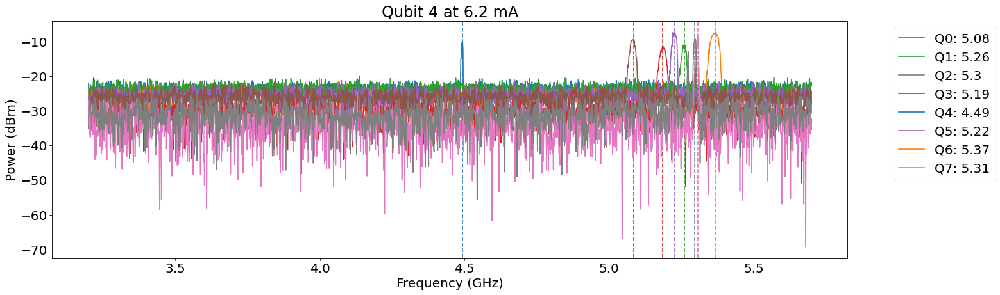

In [78]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00006_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q5
Tried (in order): -5, -8, -8.8

In [85]:
qubit_index = 5
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00002_flux_map-2025-01-17_r0_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r1_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r2_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r3_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r4_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r5_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r6_finding_slope_for_q5.h5
00002_flux_map-2025-01-17_r7_finding_slope_for_q5.h5



flux target = [1, 0, 0, 0, 0, 0, -8.8, 0, 0]
No crosstalk matrix here!
flux actual = [1, 0, 0, 0, 0, 0, -8.8, 0, 0]



Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, -8.800, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP



Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3

['data_crosstalk\\00002_flux_map-2025-01-17_r0_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r1_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r2_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r3_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r4_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r5_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r6_finding_slope_for_q5.h5', 'data_crosstalk\\00002_flux_map-2025-01-17_r7_finding_slope_for_q5.h5']
Qubit frequency for r0: 5.3475
Qubit frequency for r1: 5.35625
Qubit frequency for r2: 5.045
Qubit frequency for r3: 5.33625
Qubit frequency for r4: 4.5025
Qubit frequency for r5: 4.92125
Qubit frequency for r6: 5.24
Qubit frequency for r7: 5.20625


Text(0.5, 1.0, 'Qubit 5 at -8.8 mA')

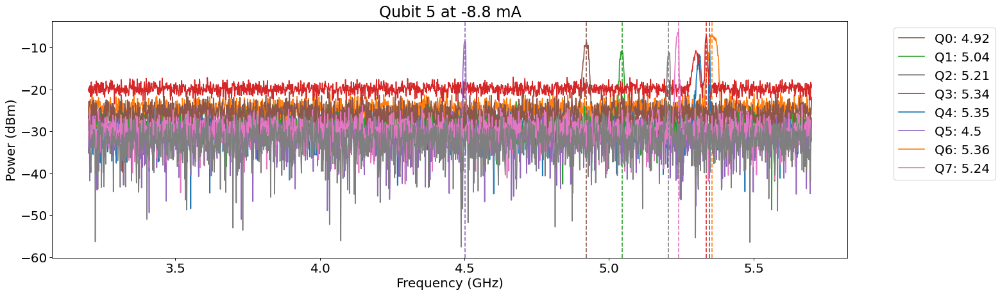

In [86]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00002_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q6
tried (in order): -4, -8, -7, -7.5

In [98]:
qubit_index = 6
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00003_flux_map-2025-01-17_r0_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r1_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r2_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r3_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r4_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r5_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r6_finding_slope_for_q6.h5
00003_flux_map-2025-01-17_r7_finding_slope_for_q6.h5



flux target = [1, 0, 0, 0, 0, 0, 0, -7.5, 0]
No crosstalk matrix here!
flux actual = [1, 0, 0, 0, 0, 0, 0, -7.5, 0]



Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, 0.000, -7.500, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP



Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3

['data_crosstalk\\00003_flux_map-2025-01-17_r0_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r1_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r2_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r3_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r4_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r5_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r6_finding_slope_for_q6.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r7_finding_slope_for_q6.h5']
Qubit frequency for r0: 5.31375
Qubit frequency for r1: 4.5275
Qubit frequency for r2: 5.07
Qubit frequency for r3: 5.33875
Qubit frequency for r4: 5.2725
Qubit frequency for r5: 4.94875
Qubit frequency for r6: 5.3025
Qubit frequency for r7: 5.21875


Text(0.5, 1.0, 'Qubit 6 at -7.5 mA')

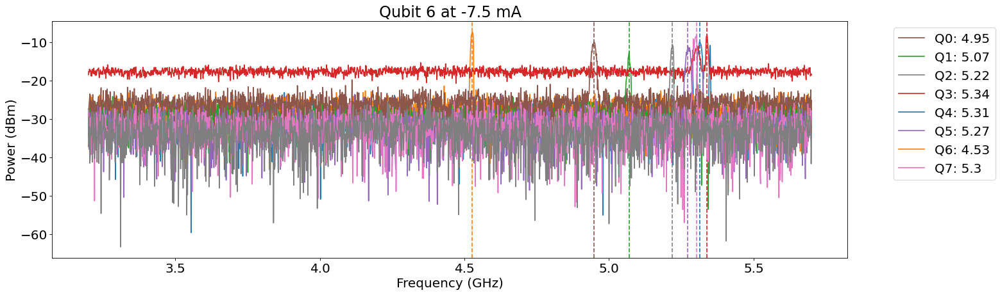

In [99]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00003_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

#### Q7
tried (in order): -4, 4, 4.5, 4.3

In [118]:
qubit_index = 7
fname_tag = "_finding_slope_for_q"+str(qubit_index)
msmt_qubit = qubit_order[2][qubit_index]
set_DACs = 1
flux_msmt(slopes[qubit_index], fname_tag, msmt_index=msmt_qubit)

Configuring the PNAX
Swept Parameter: flux
00003_flux_map-2025-01-17_r0_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r1_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r2_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r3_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r4_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r5_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r6_finding_slope_for_q7.h5
00003_flux_map-2025-01-17_r7_finding_slope_for_q7.h5



flux target = [1, 0, 0, 0, 0, 0, 0, 0, 4.3]
No crosstalk matrix here!
flux actual = [1, 0, 0, 0, 0, 0, 0, 0, 4.3]



Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, 0.000, 0.000, 4.300 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3
Dri

['data_crosstalk\\00003_flux_map-2025-01-17_r0_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r1_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r2_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r3_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r4_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r5_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r6_finding_slope_for_q7.h5', 'data_crosstalk\\00003_flux_map-2025-01-17_r7_finding_slope_for_q7.h5']
Qubit frequency for r0: 5.155
Qubit frequency for r1: 5.26
Qubit frequency for r2: 5.26125
Qubit frequency for r3: 5.18375
Qubit frequency for r4: 5.0725
Qubit frequency for r5: 5.085
Qubit frequency for r6: 4.5125
Qubit frequency for r7: 5.29875


Text(0.5, 1.0, 'Qubit 7 at 4.3 mA')

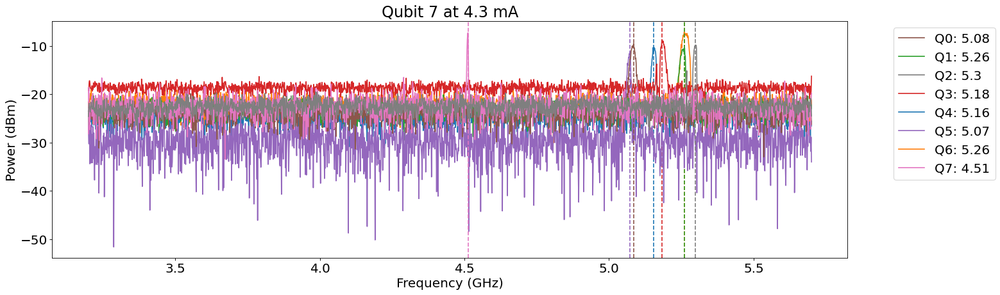

In [119]:
# filename_list = []
# filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r'+str(msmt_qubit)+fname_tag+'.h5')
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk\00003_flux_map-2025-01-17_r'+str(q)+fname_tag+'.h5')
print(filename_list)

# plot_qubit(slopes[qubit_index], filename_list[0], qubit_order[2][qubit_index])
plot_qubits(slopes[qubit_index], filename_list)
title('Qubit '+str(qubit_index)+' at '+str(slopes[qubit_index][qubit_index+1])+' mA')

### Crosstalk measurement

In [126]:
### export path -  this section can get reset depending on what you are doing
expt_path = os.getcwd() + '\data_crosstalk'

isTakeData = 1
set_YOKO = 0
set_DACs = 1
measureAllQubits = 0

In [127]:
print(upper_sweet_spot)
print(zero_flux)
print(slopes)

[1, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0]
[[1, -8.5, 0, 0, 0, 0, 0, 0, 0], [1, 0, -8.5, 0, 0, 0, 0, 0, 0], [1, 0, 0, -8.9, 0, 0, 0, 0, 0], [1, 0, 0, 0, 6.5, 0, 0, 0, 0], [1, 0, 0, 0, 0, 6.2, 0, 0, 0], [1, 0, 0, 0, 0, 0, -8.8, 0, 0], [1, 0, 0, 0, 0, 0, 0, -7.5, 0], [1, 0, 0, 0, 0, 0, 0, 0, 4.3]]


In [129]:

for msmt_qubit in qubit_order[2]:
    drive_DACs(upper_sweet_spot)
    print('Measuring qubit '+str(qubit_order[1][msmt_qubit])+' (r'+str(msmt_qubit)+')')
    for flux_line in range(num_qubits):
        pt_configuration = slopes[qubit_order[1][msmt_qubit]]
        print('pt configuration: '+str(pt_configuration))
        drive_DACs(pt_configuration)
        fname_tag = 'measuring_q'+str(qubit_order[1][msmt_qubit])+'_w_flux_q'+str(flux_line)
        print(fname_tag)
        sweep = linspace(pt_configuration[flux_line+1]-1, pt_configuration[flux_line+1]+1, 11)
        print('Sweeping flux line '+str(flux_line)+': '+str(sweep))
        flux_msmt_sweep(pt_configuration, sweep, fname_tag, flux_line, msmt_index=msmt_qubit)
        print()
    print()

drive_Yoko_and_DACs(zero_flux)

Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP



Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  -8.900070190429688
target 131072
end of ramp - None


Flux line for qubit  3
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  4
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  5
Driving DAC at (0.009) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  6
Driving DAC at (0.020) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  7
Driving DAC at (0.024) mA
old reading =  0.0
target 131072
end of ramp - RAMP

Measuring qubit 0 (r5)
pt configuration: [1, -8.5, 0, 0, 0, 0, 0, 0, 0]
Driving DAC

## Data processing

In [140]:
sup_filename_list = []

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r5_f'+str(f)+'measuring_q0_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r2_f'+str(f)+'measuring_q1_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    if f == 0:
        filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-17_r7_f'+str(f)+'measuring_q2_w_flux_q'+str(f)+'.h5')
    else: 
        filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r7_f'+str(f)+'measuring_q2_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r3_f'+str(f)+'measuring_q3_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r0_f'+str(f)+'measuring_q4_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r4_f'+str(f)+'measuring_q5_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r1_f'+str(f)+'measuring_q6_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for f in range(num_qubits):
    filename_list.append(r'data_crosstalk\00000_flux_map-2025-01-18_r6_f'+str(f)+'measuring_q7_w_flux_q'+str(f)+'.h5')
sup_filename_list.append(filename_list)

for qubit_filename in sup_filename_list:
    print(qubit_filename)

['data_crosstalk\\00000_flux_map-2025-01-17_r5_f0measuring_q0_w_flux_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f1measuring_q0_w_flux_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f2measuring_q0_w_flux_q2.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f3measuring_q0_w_flux_q3.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f4measuring_q0_w_flux_q4.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f5measuring_q0_w_flux_q5.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f6measuring_q0_w_flux_q6.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r5_f7measuring_q0_w_flux_q7.h5']
['data_crosstalk\\00000_flux_map-2025-01-17_r2_f0measuring_q1_w_flux_q0.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_f1measuring_q1_w_flux_q1.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_f2measuring_q1_w_flux_q2.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_f3measuring_q1_w_flux_q3.h5', 'data_crosstalk\\00000_flux_map-2025-01-17_r2_f4measuring_q1_w_flux_q4.h5', 'data_cros

In [145]:
M = np.zeros((num_qubits, num_qubits))

### Flux line 0

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f0measuring_q0_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f0measuring_q0_w_flux_q0.h5
minimum q freq 4.4225


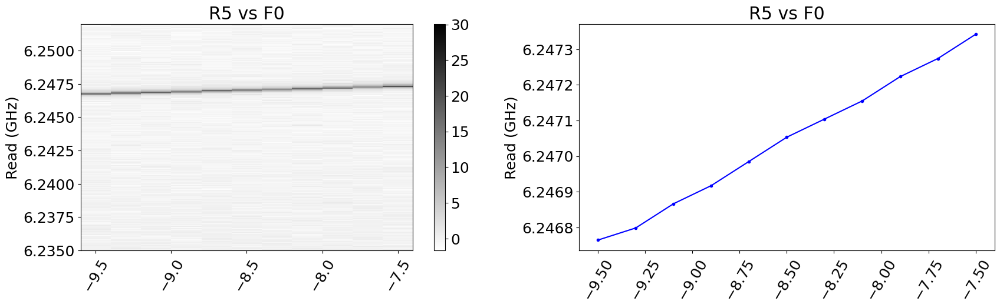

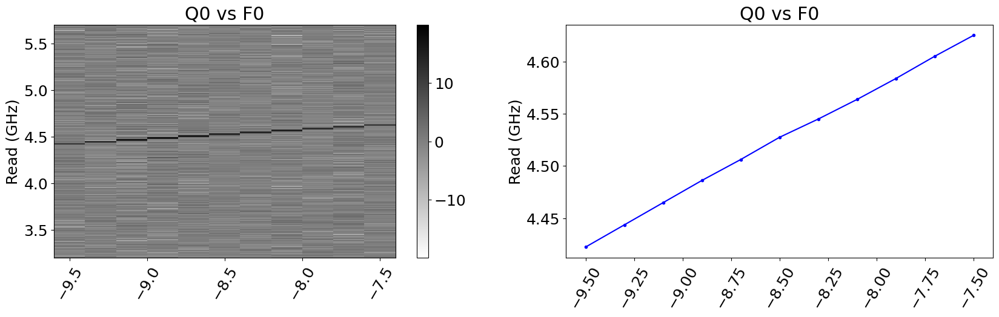

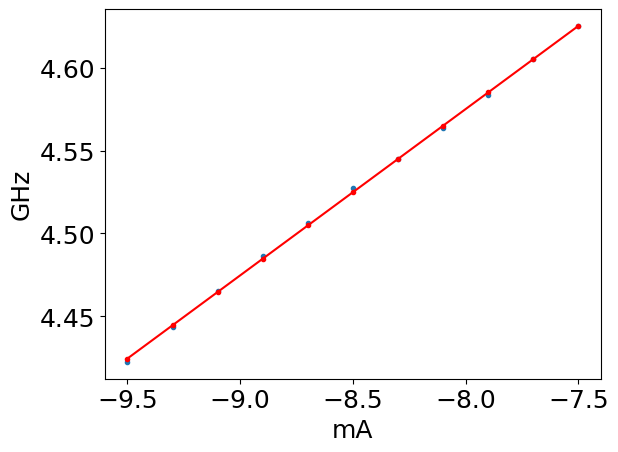

M =  0.10034090909091067
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f0measuring_q1_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f0measuring_q1_w_flux_q0.h5
minimum q freq 4.4025


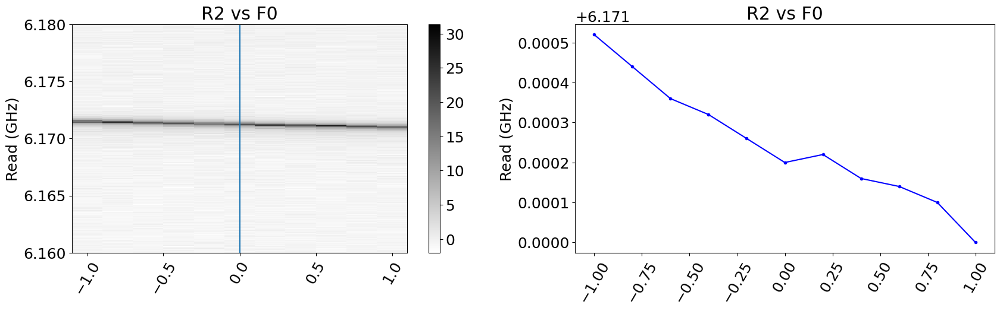

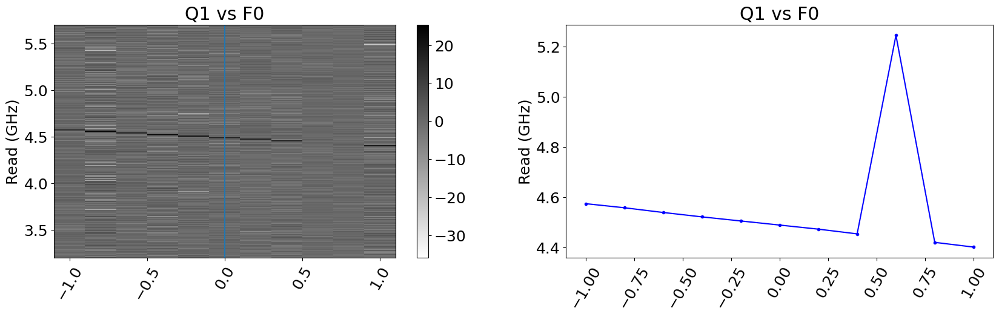

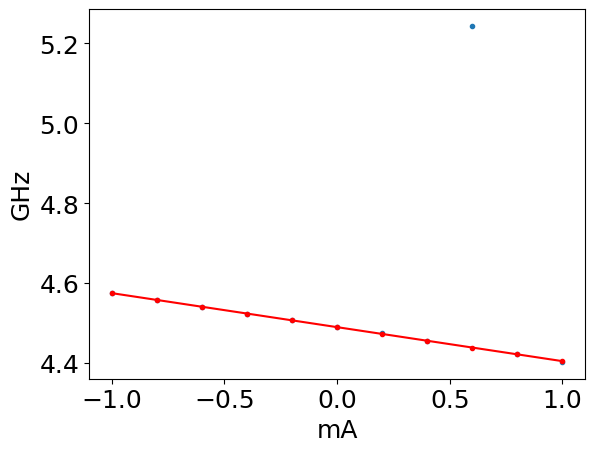

M =  -0.08519345238095488
2
data_crosstalk\00000_flux_map-2025-01-17_r7_f0measuring_q2_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r7_f0measuring_q2_w_flux_q0.h5
minimum q freq 4.48125


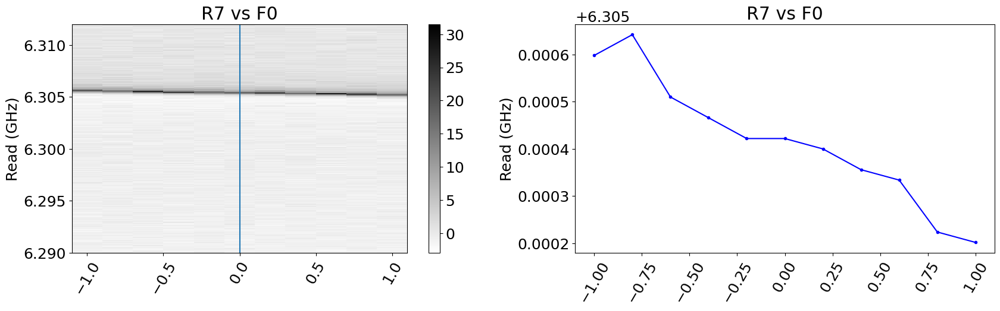

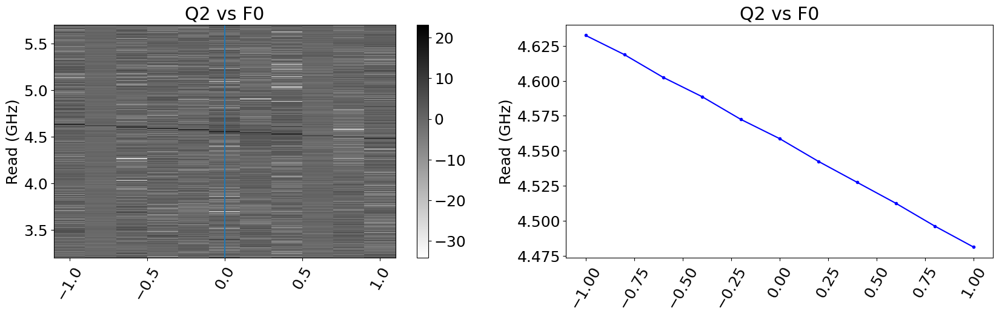

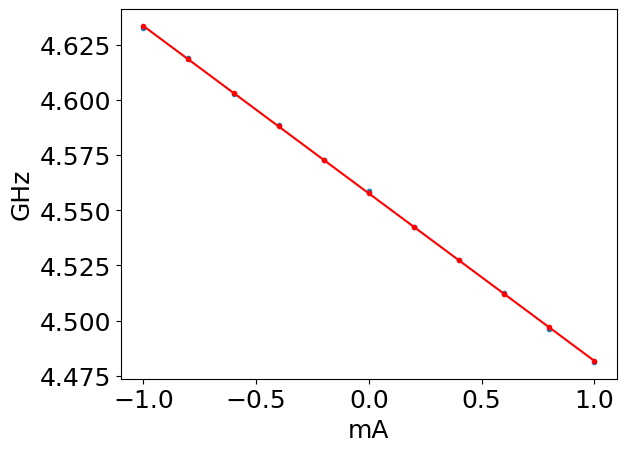

M =  -0.07585227272727235
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f0measuring_q3_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f0measuring_q3_w_flux_q0.h5
minimum q freq 4.43625


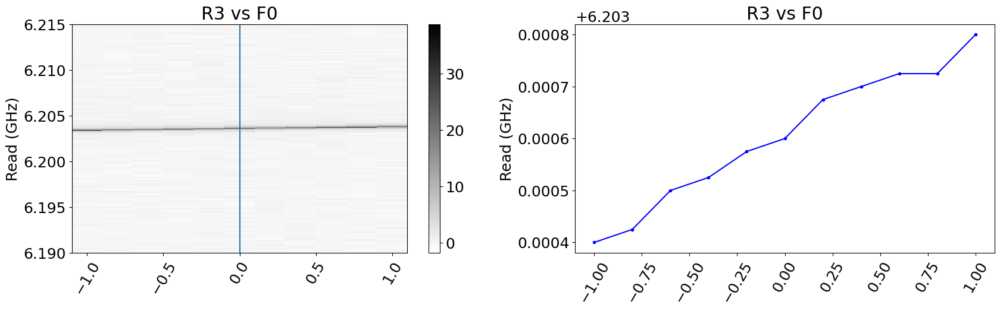

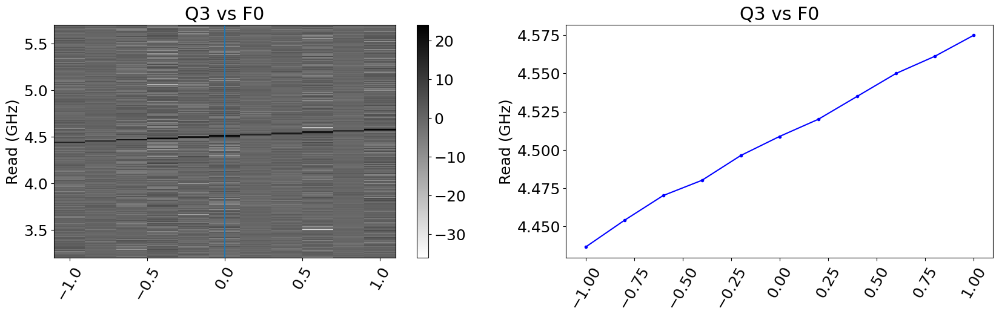

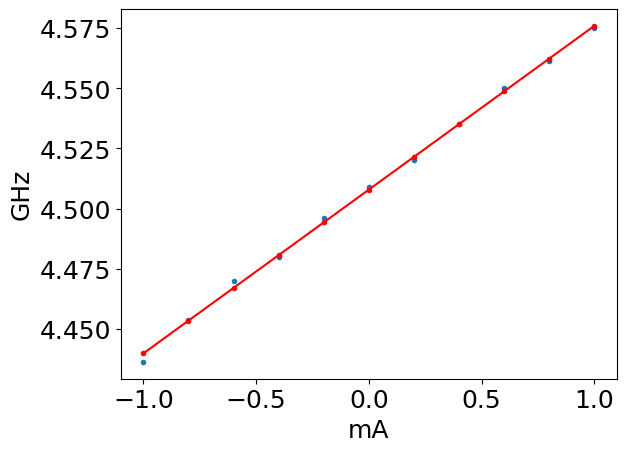

M =  0.06806818181818235
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f0measuring_q4_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f0measuring_q4_w_flux_q0.h5
minimum q freq 4.43125


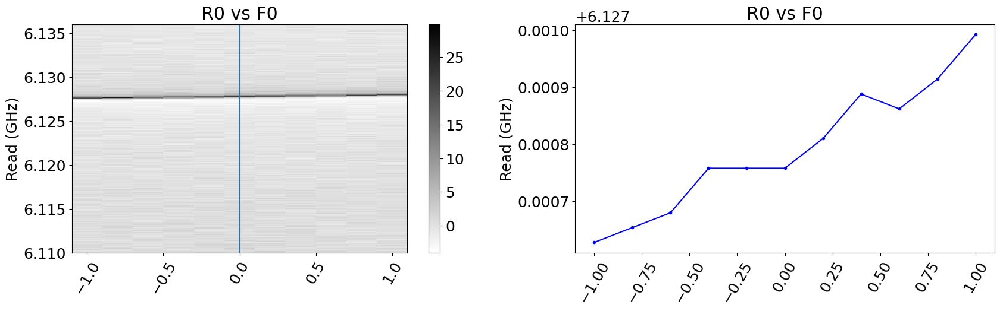

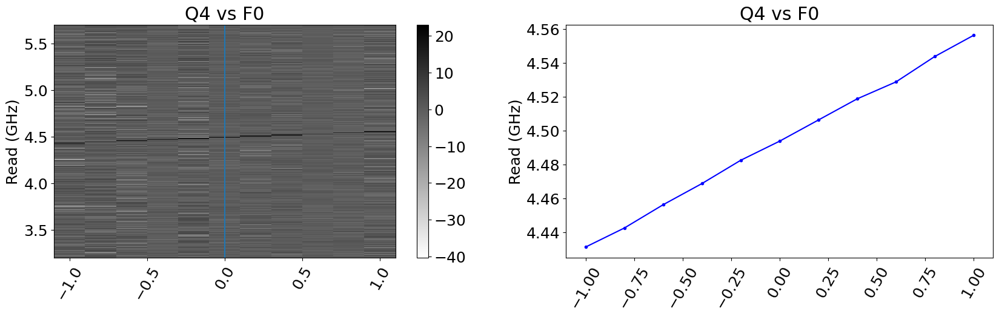

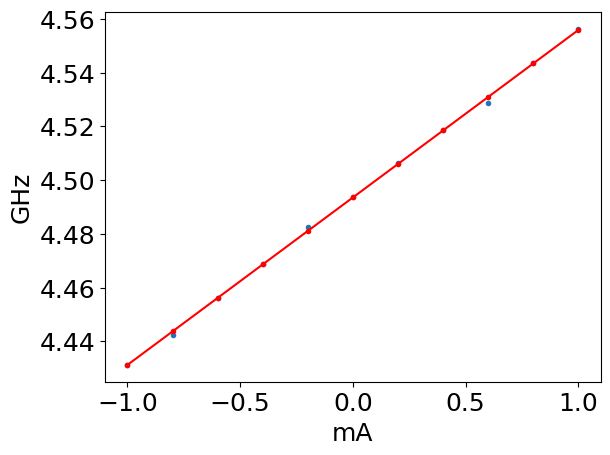

M =  0.06232954545454602
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f0measuring_q5_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f0measuring_q5_w_flux_q0.h5
minimum q freq 4.44625


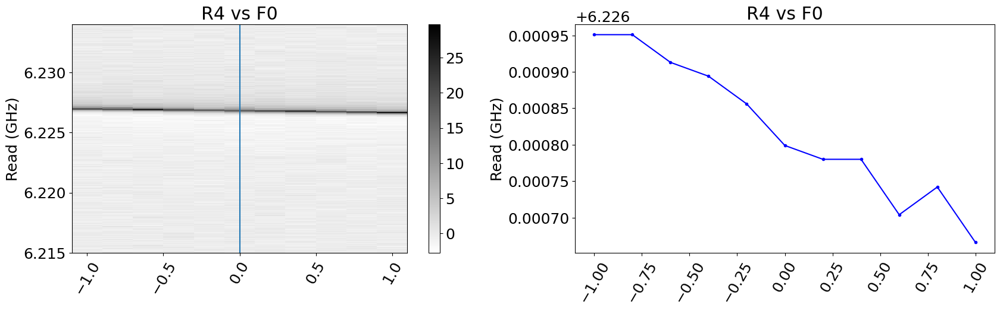

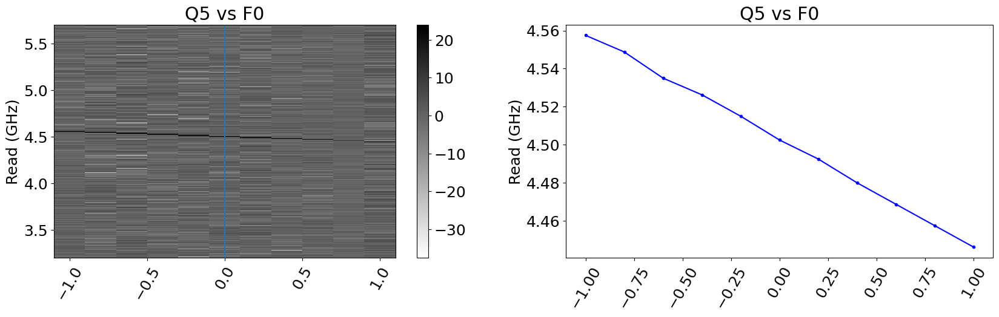

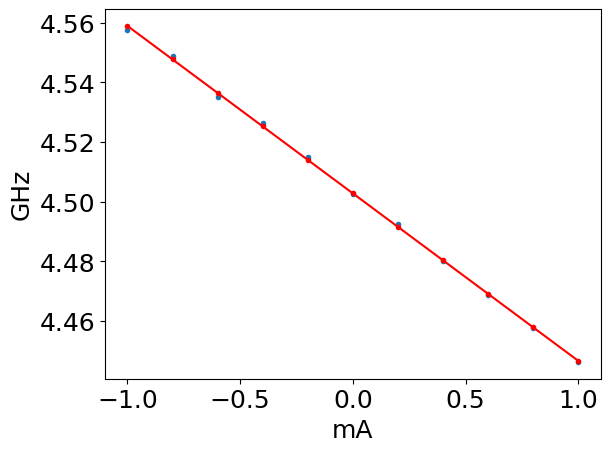

M =  -0.056136363636363214
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f0measuring_q6_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f0measuring_q6_w_flux_q0.h5
minimum q freq 4.47375


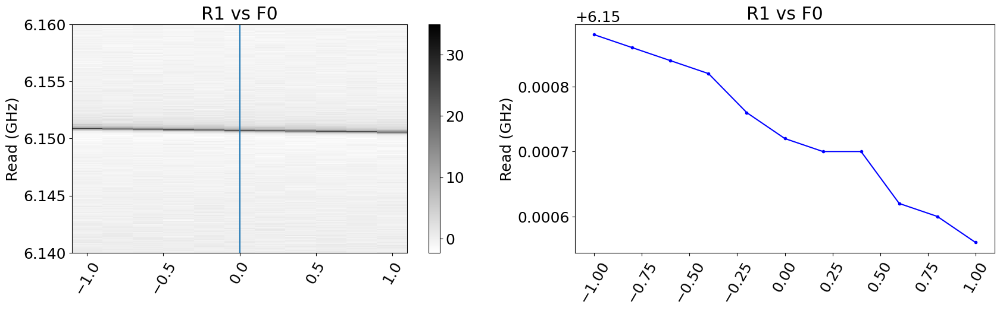

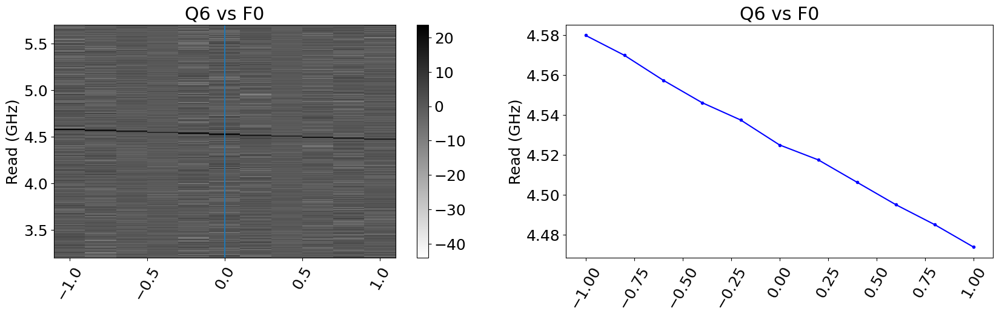

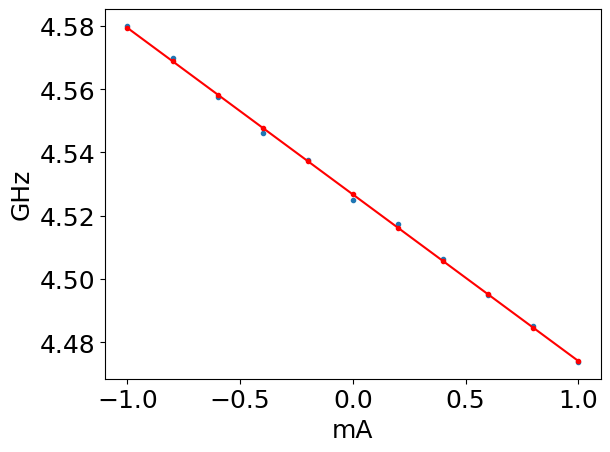

M =  -0.052670454545453896
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f0measuring_q7_w_flux_q0.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f0measuring_q7_w_flux_q0.h5
minimum q freq 4.45


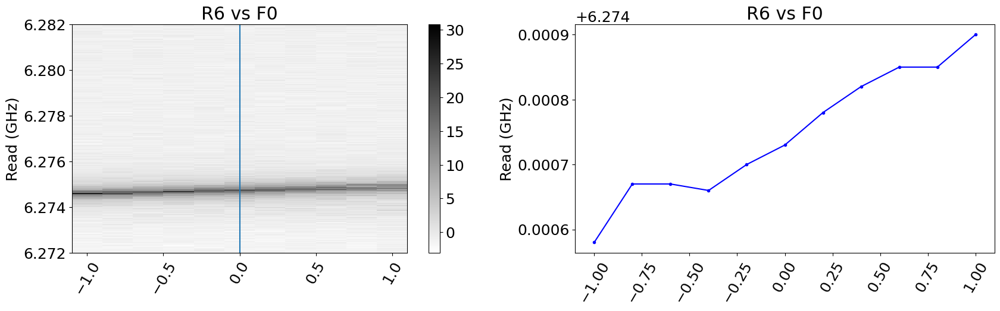

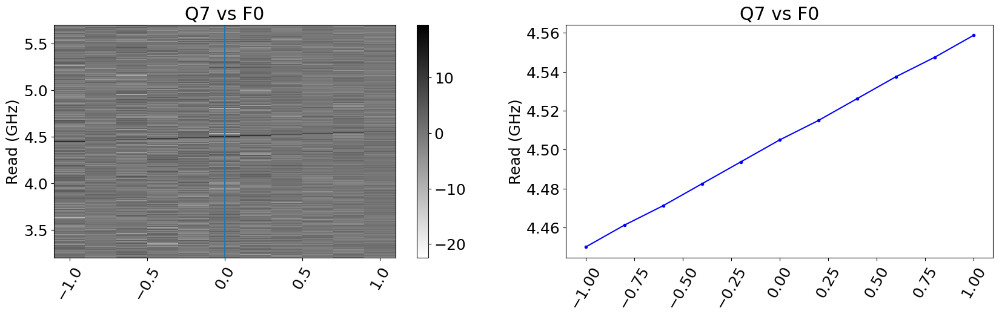

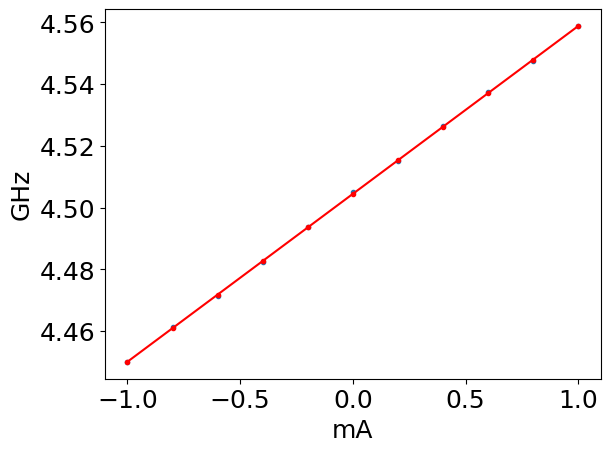

M =  0.05437500000000055


In [171]:
flux_ind = 0

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    if q_ind == 1:
        fit = np.polyfit(xdata[:8], ydata[:8], 1)
    else:
        fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 1

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f1measuring_q0_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f1measuring_q0_w_flux_q1.h5
minimum q freq 4.50625


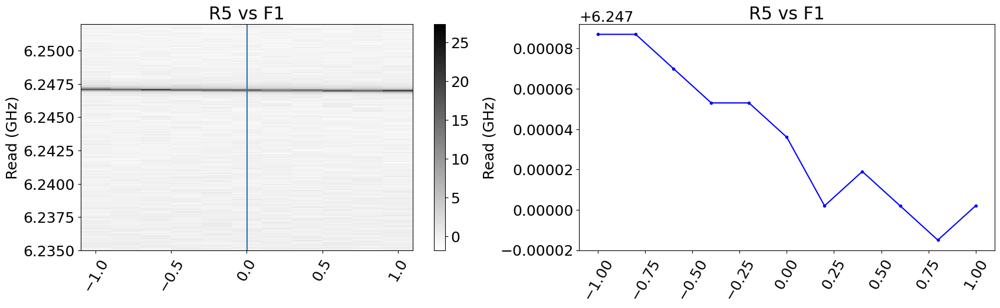

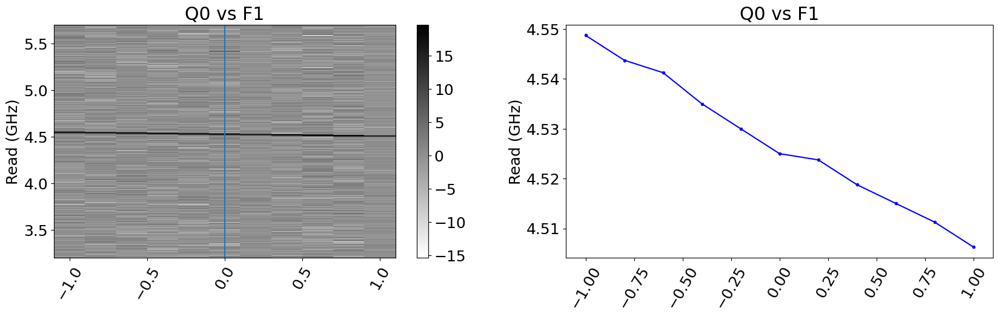

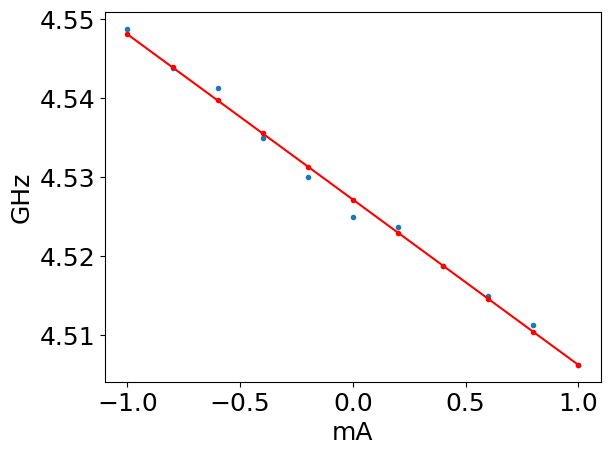

M =  -0.020909090909090284
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f1measuring_q1_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f1measuring_q1_w_flux_q1.h5
minimum q freq 3.7675


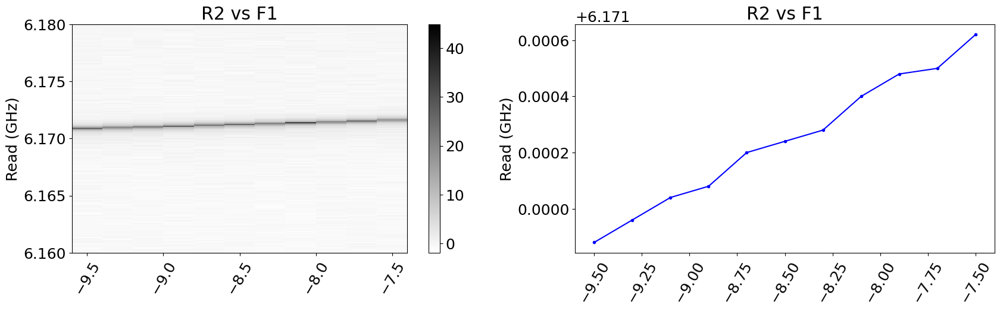

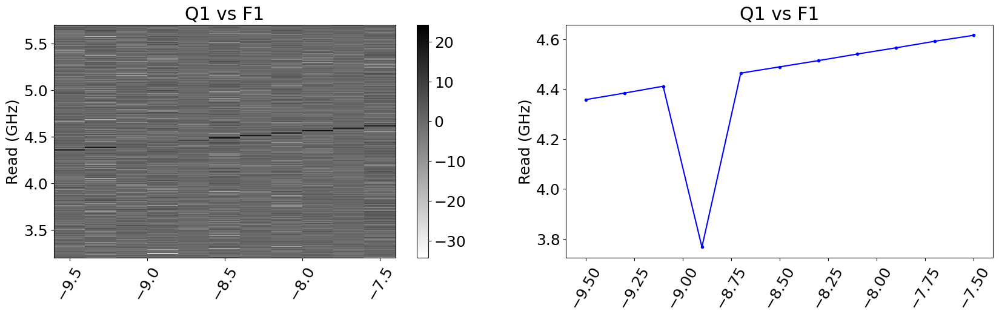

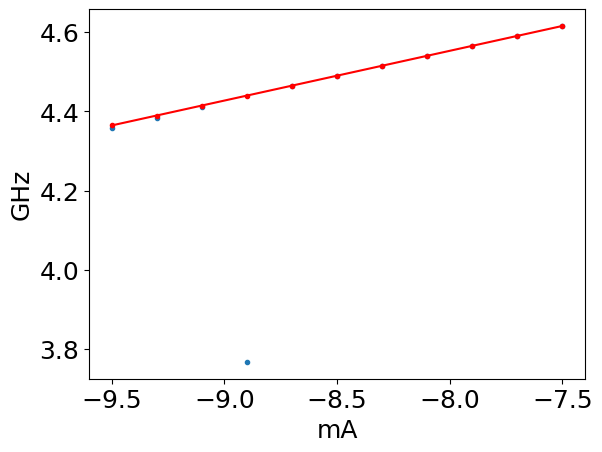

M =  0.1256250000000021
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f1measuring_q2_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f1measuring_q2_w_flux_q1.h5
minimum q freq 4.49125


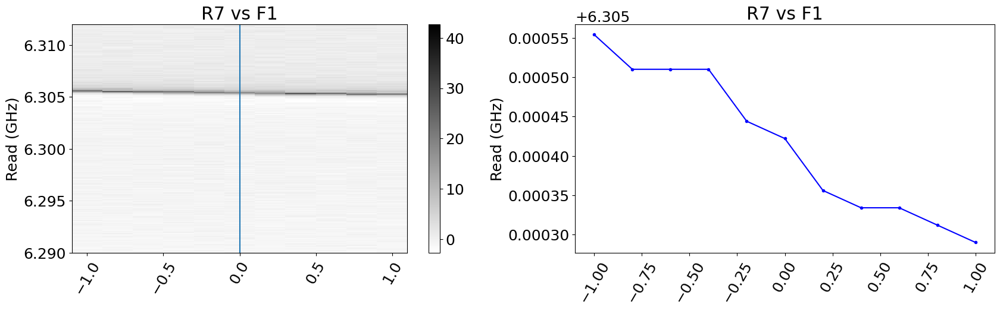

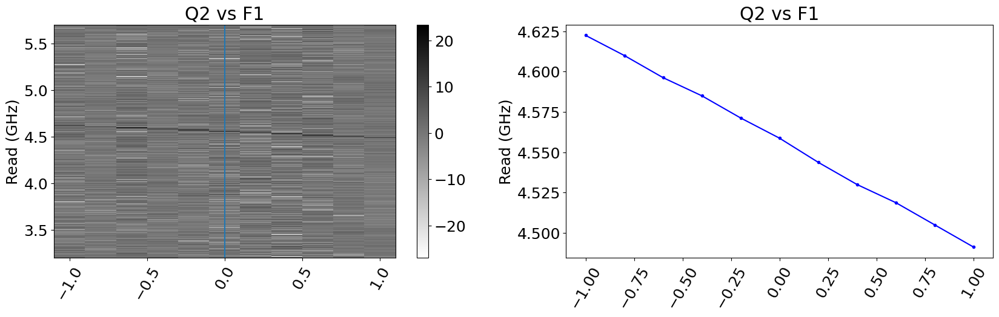

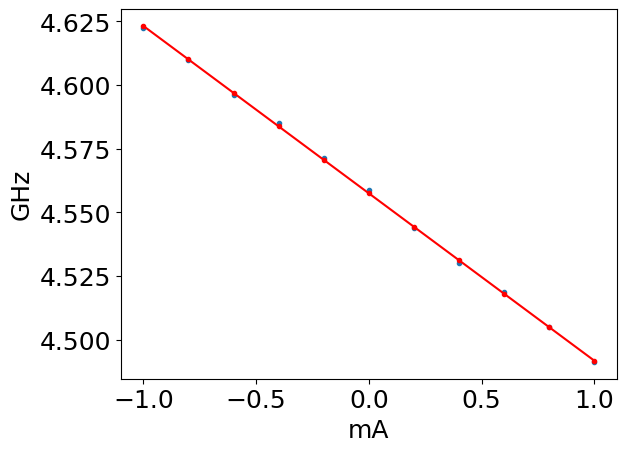

M =  -0.06573863636363587
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f1measuring_q3_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f1measuring_q3_w_flux_q1.h5
minimum q freq 4.44875


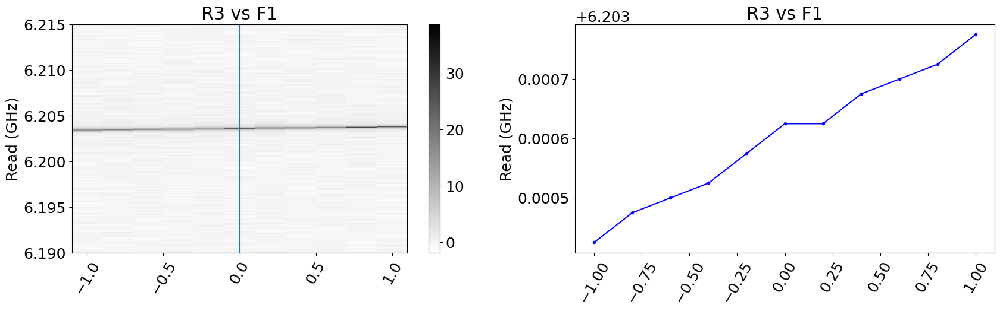

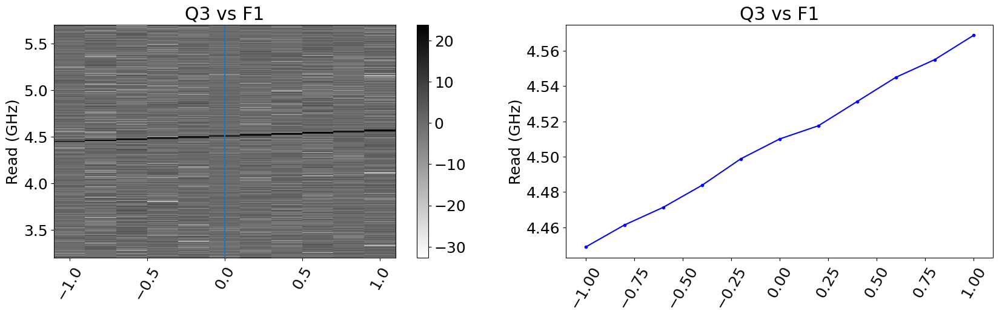

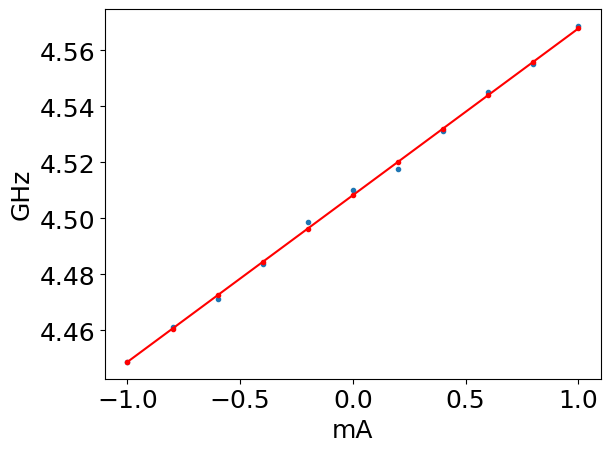

M =  0.059545454545455206
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f1measuring_q4_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f1measuring_q4_w_flux_q1.h5
minimum q freq 4.435


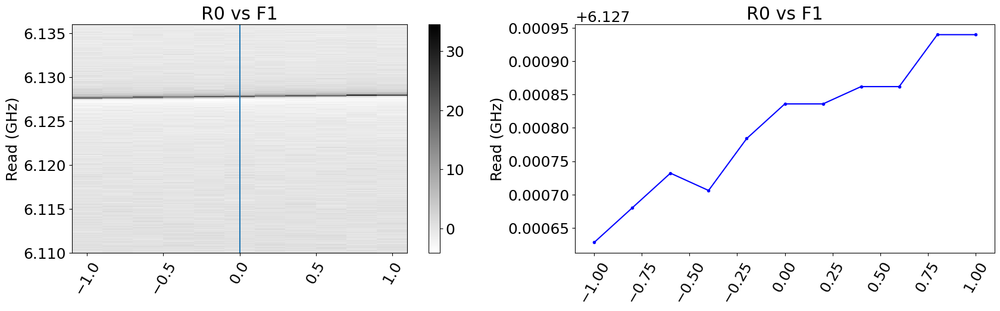

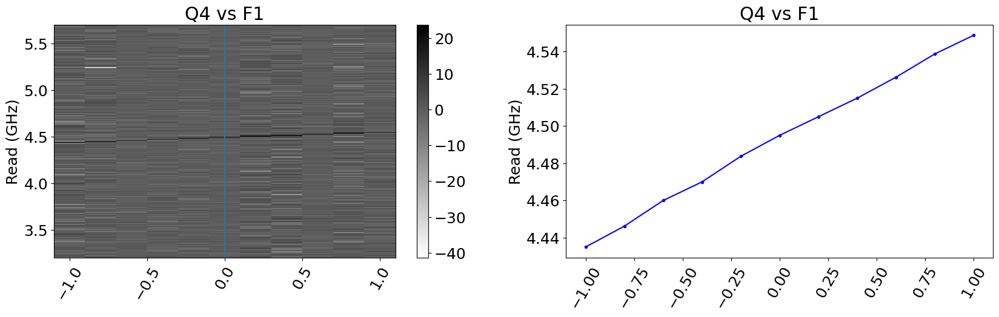

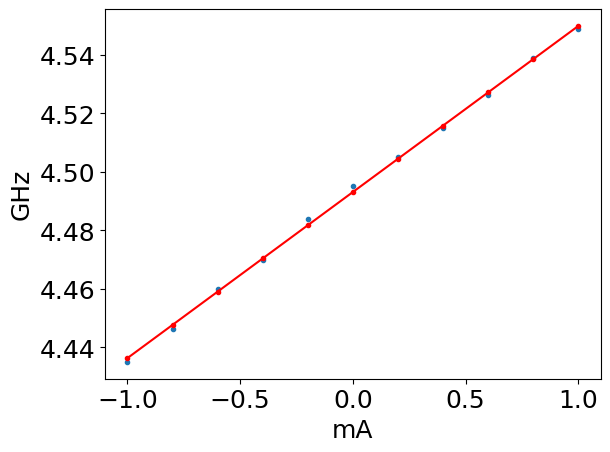

M =  0.056761363636364574
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f1measuring_q5_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f1measuring_q5_w_flux_q1.h5
minimum q freq 4.4475


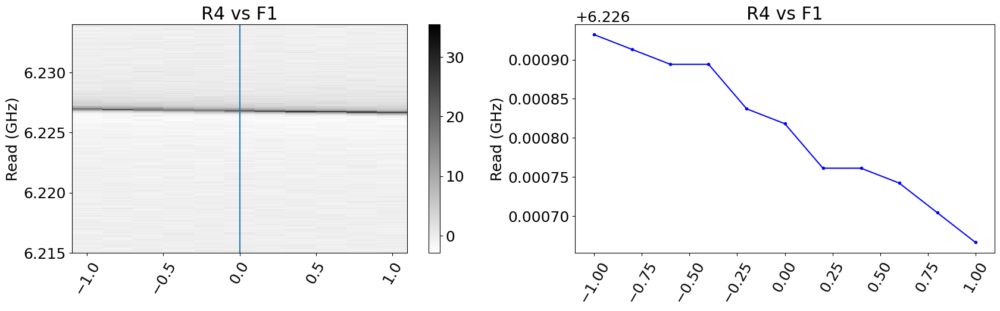

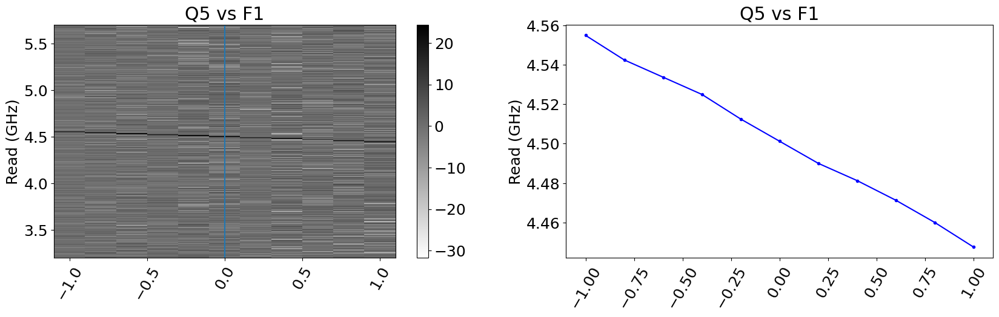

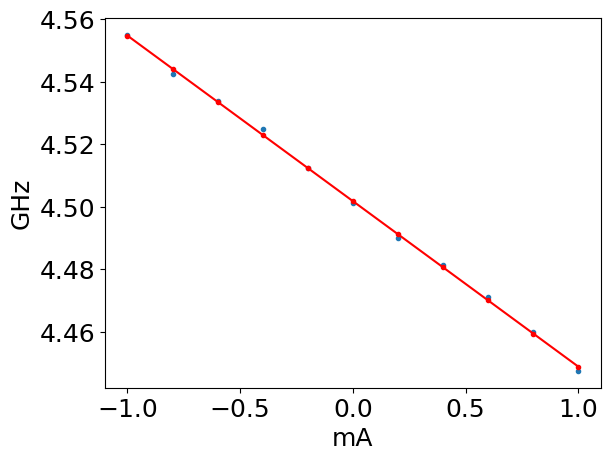

M =  -0.052954545454544956
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f1measuring_q6_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f1measuring_q6_w_flux_q1.h5
minimum q freq 4.47625


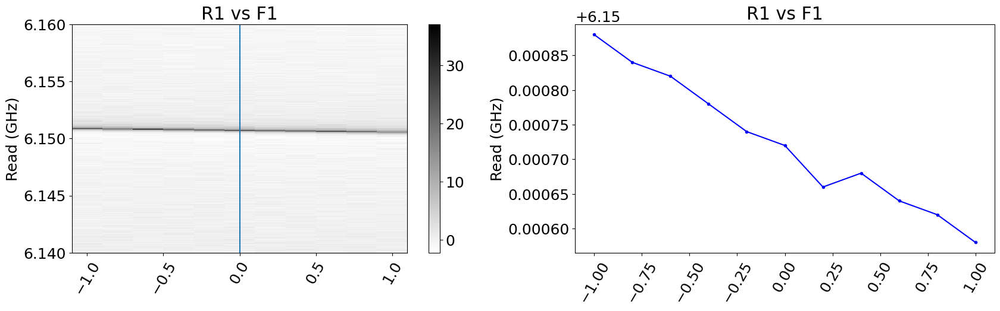

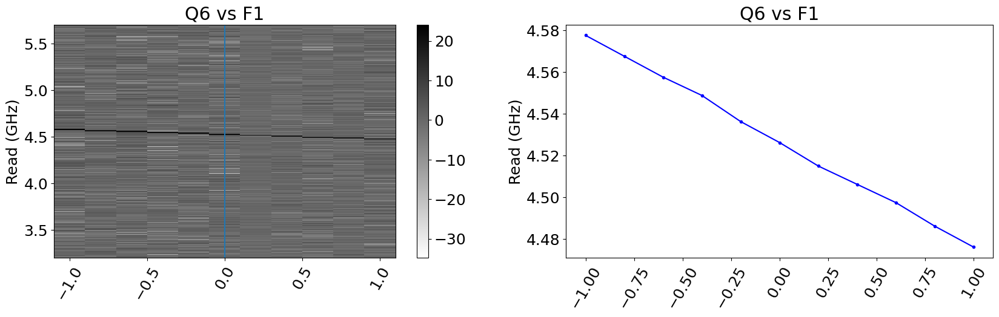

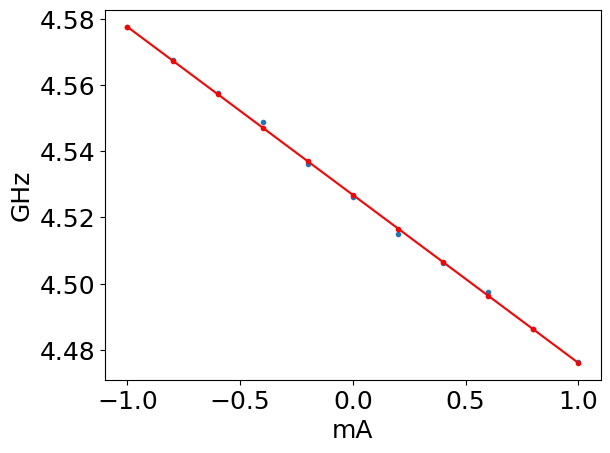

M =  -0.05079545454545397
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f1measuring_q7_w_flux_q1.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f1measuring_q7_w_flux_q1.h5
minimum q freq 4.4575


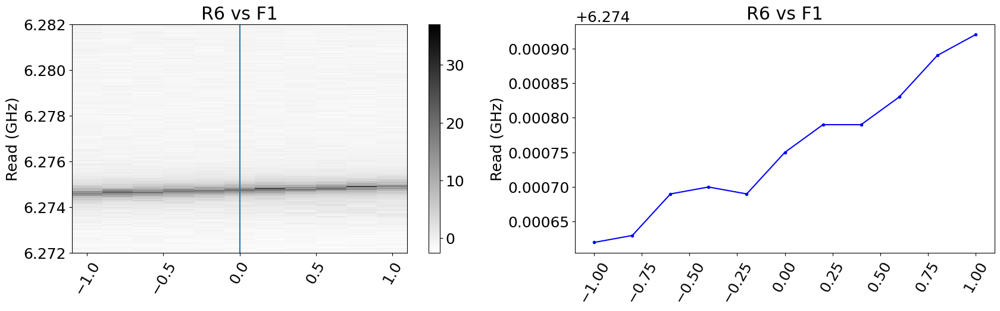

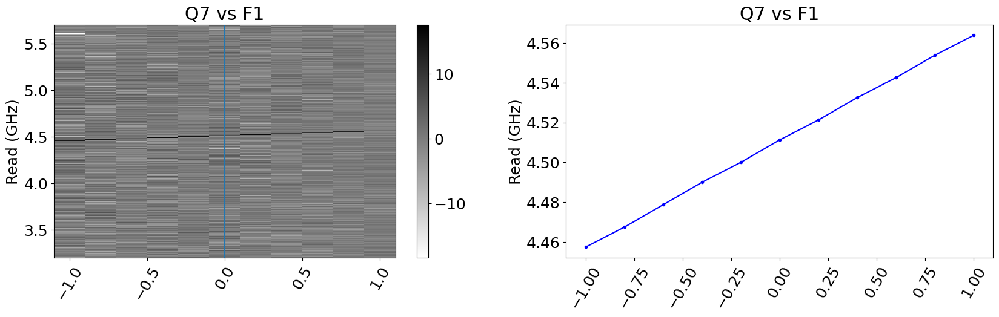

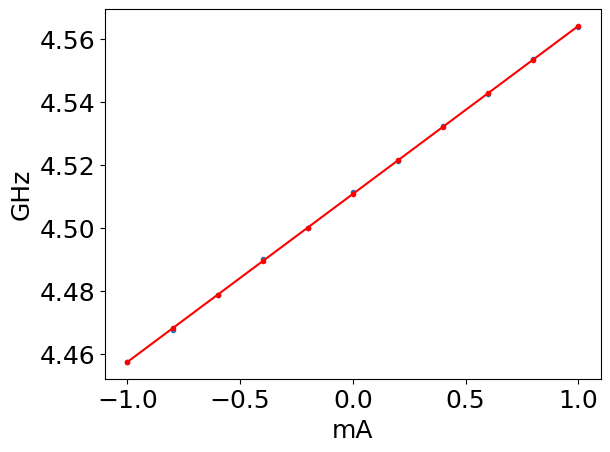

M =  0.053352272727273345


In [172]:
flux_ind = 1

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    if q_ind == 1:
        fit = np.polyfit(xdata[7:], ydata[7:], 1)
    else:
        fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 2

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f2measuring_q0_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f2measuring_q0_w_flux_q2.h5
minimum q freq 4.52


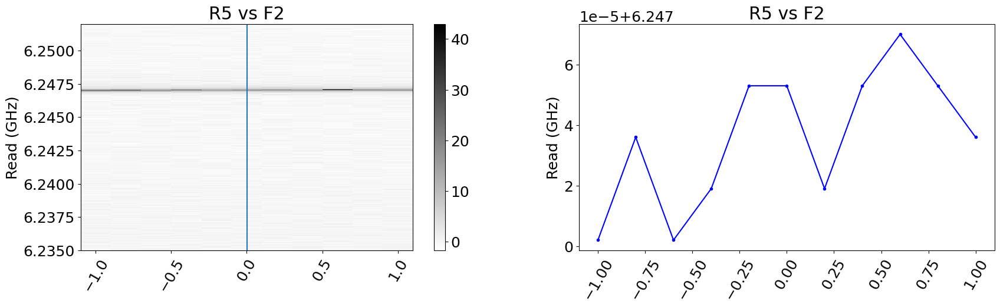

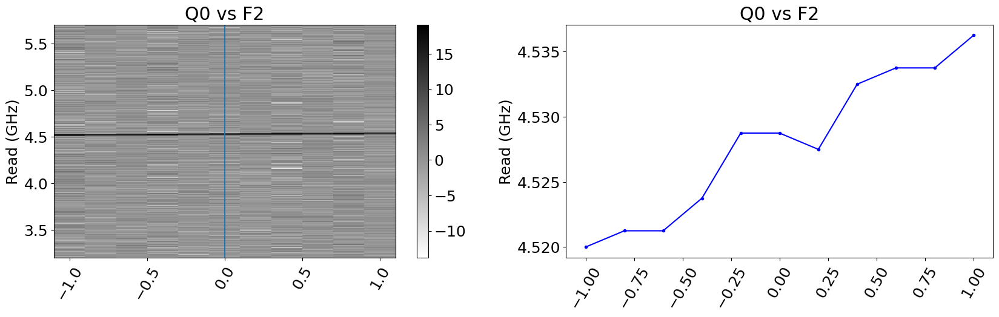

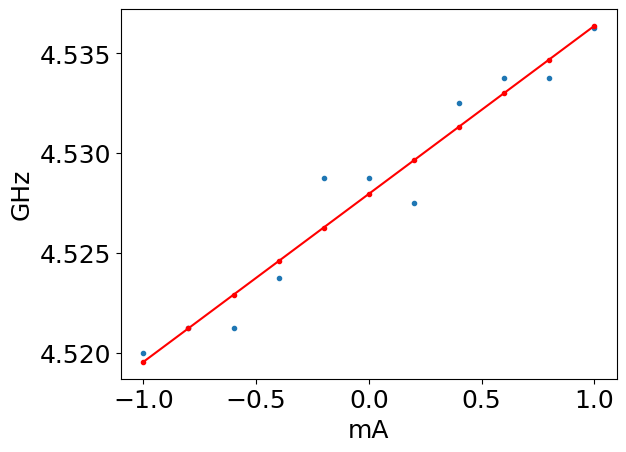

M =  0.008409090909091583
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f2measuring_q1_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f2measuring_q1_w_flux_q2.h5
minimum q freq 4.47625


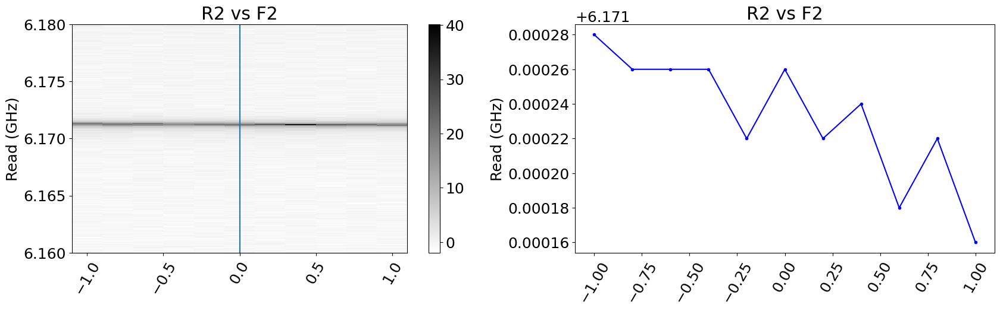

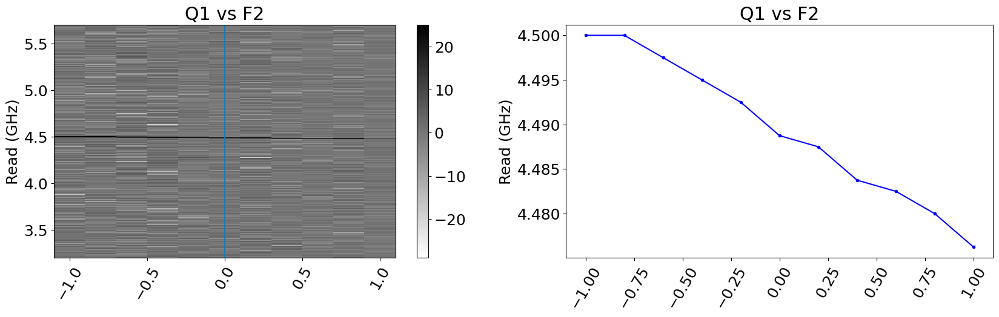

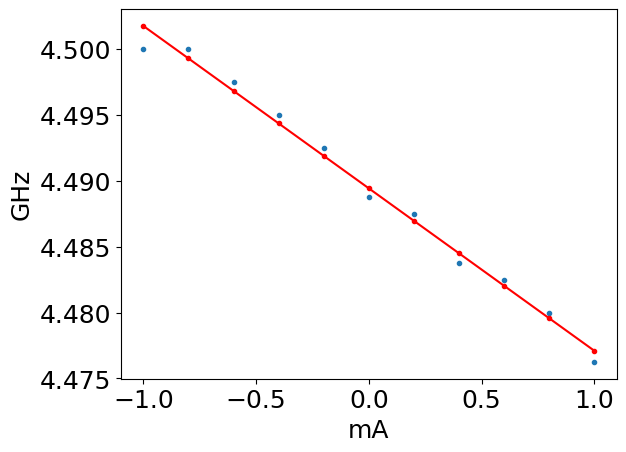

M =  -0.01232954545454476
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f2measuring_q2_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f2measuring_q2_w_flux_q2.h5
minimum q freq 4.39875


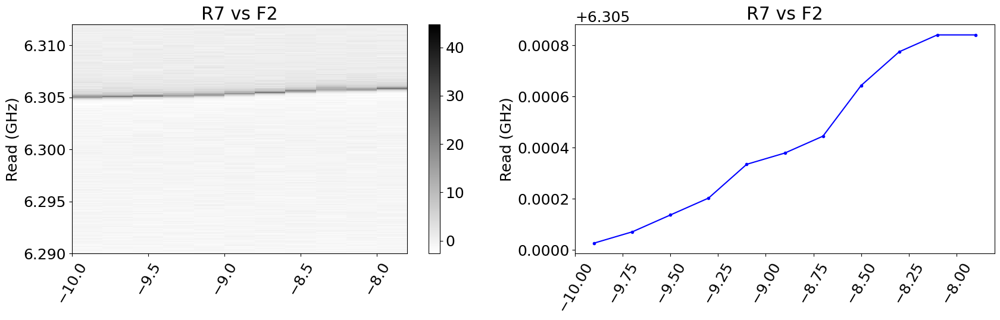

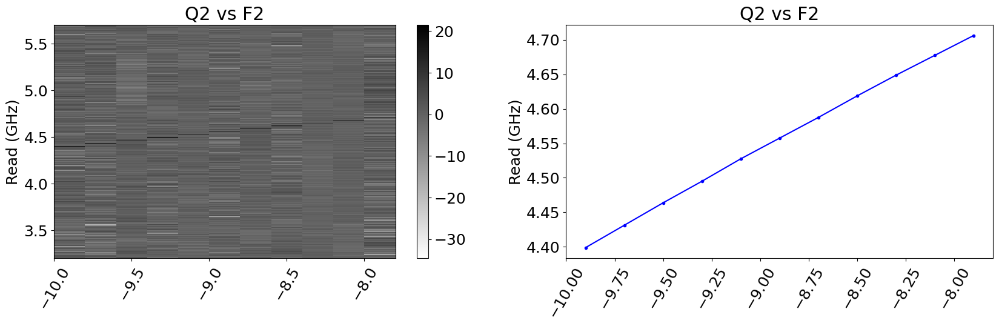

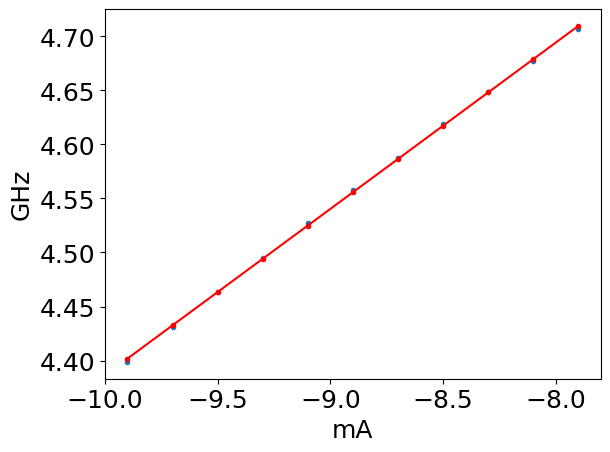

M =  0.15386363636363679
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f2measuring_q3_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f2measuring_q3_w_flux_q2.h5
minimum q freq 4.455


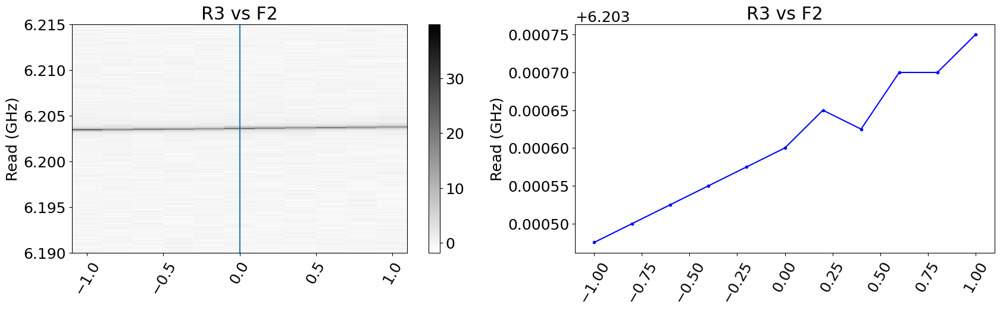

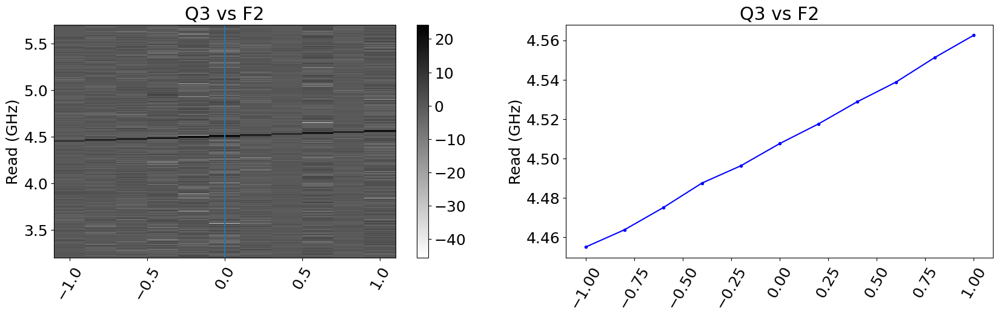

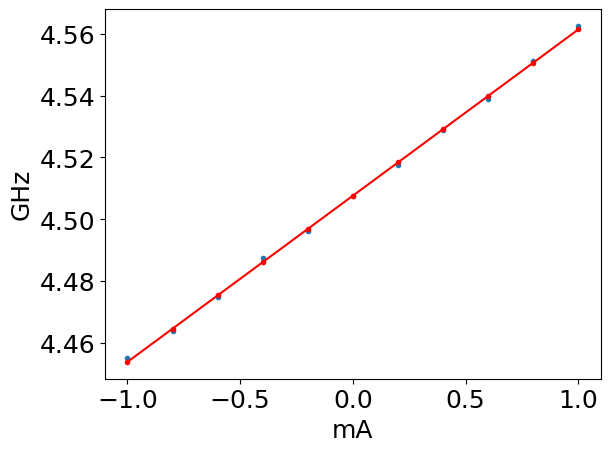

M =  0.053750000000000756
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f2measuring_q4_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f2measuring_q4_w_flux_q2.h5
minimum q freq 4.44125


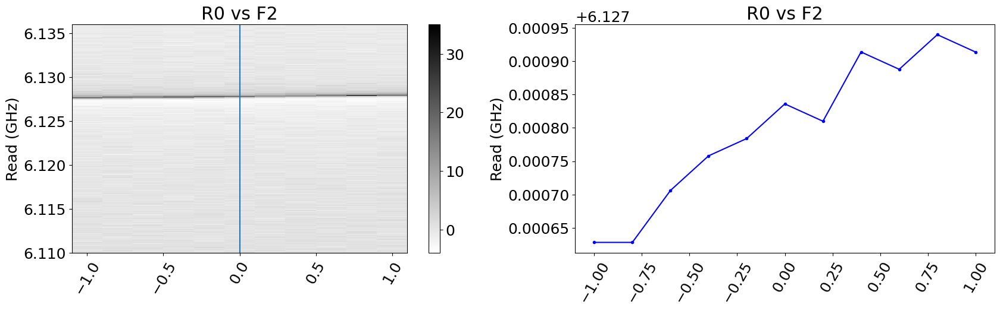

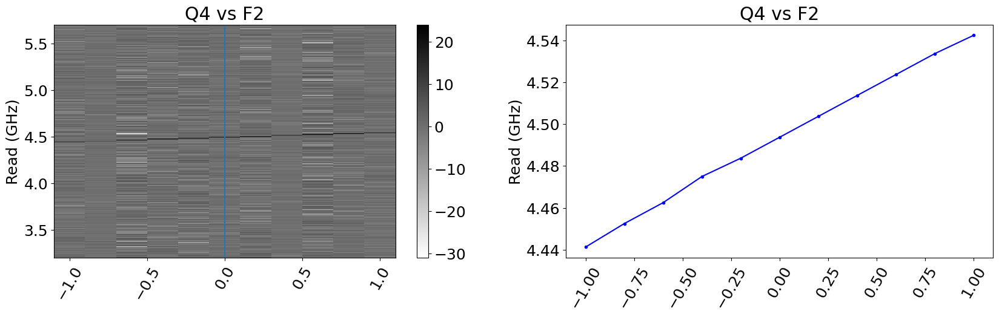

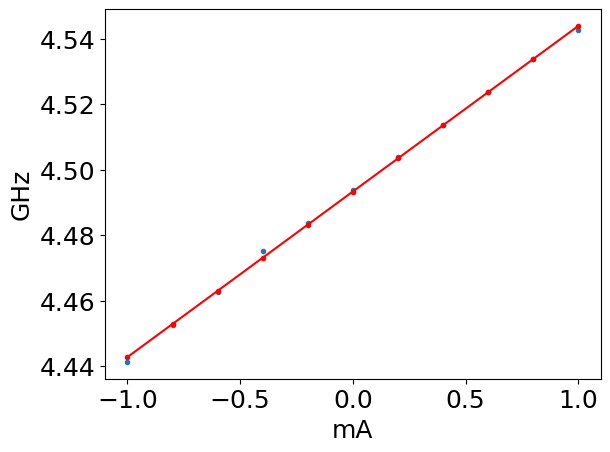

M =  0.05056818181818252
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f2measuring_q5_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f2measuring_q5_w_flux_q2.h5
minimum q freq 4.4525


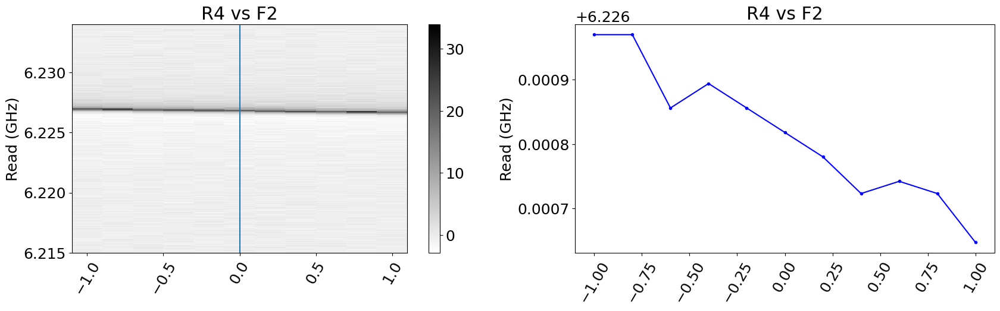

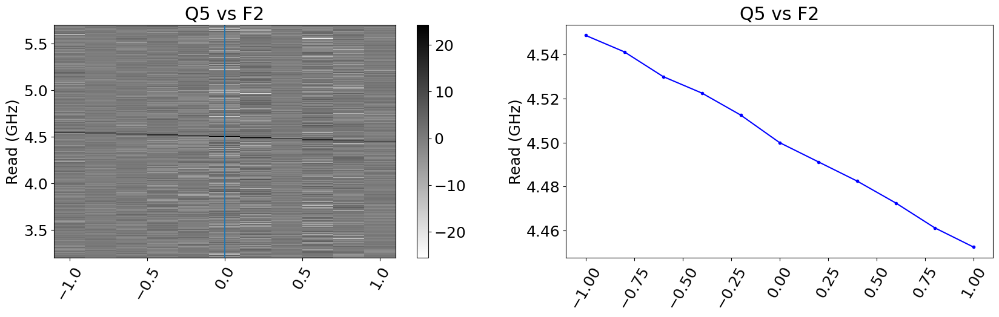

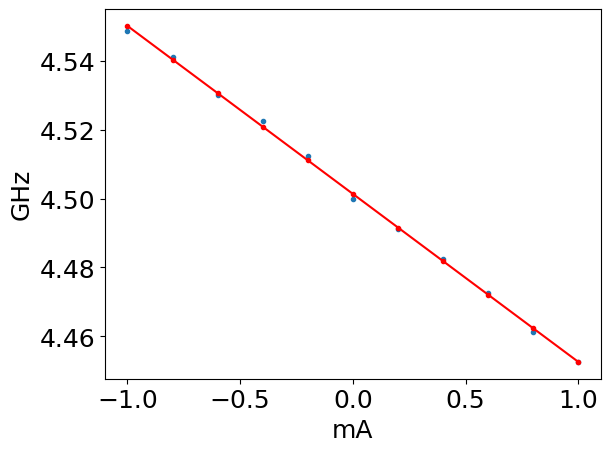

M =  -0.04886363636363595
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f2measuring_q6_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f2measuring_q6_w_flux_q2.h5
minimum q freq 4.4775


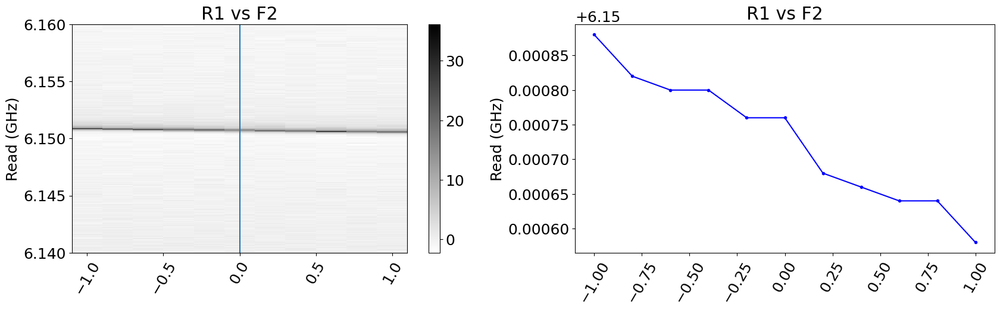

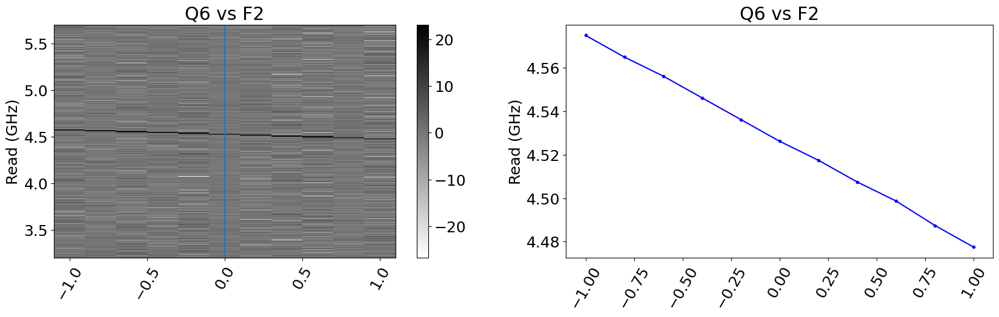

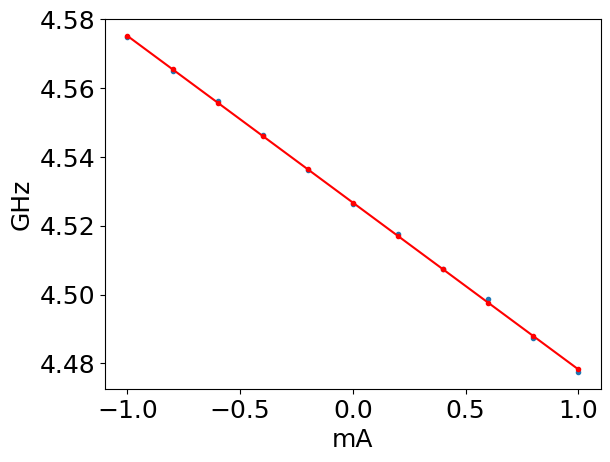

M =  -0.048465909090908636
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f2measuring_q7_w_flux_q2.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f2measuring_q7_w_flux_q2.h5
minimum q freq 4.46125


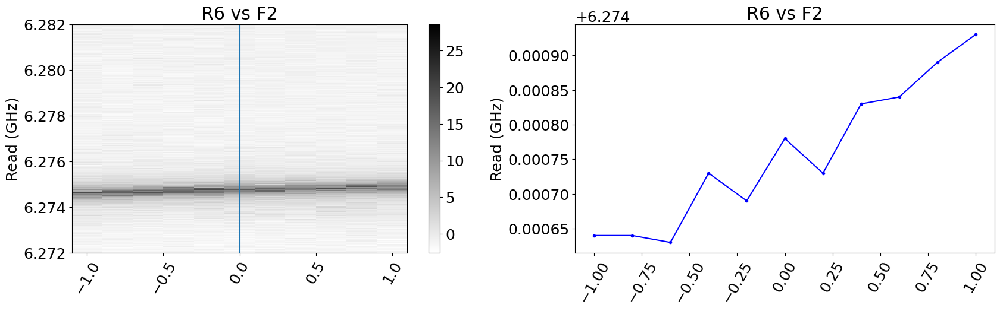

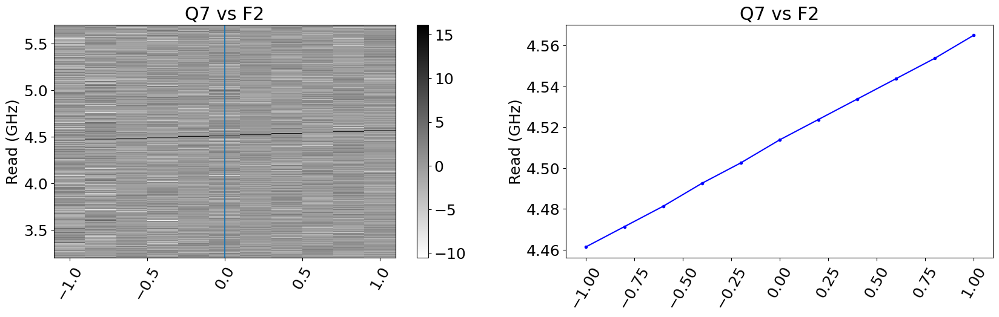

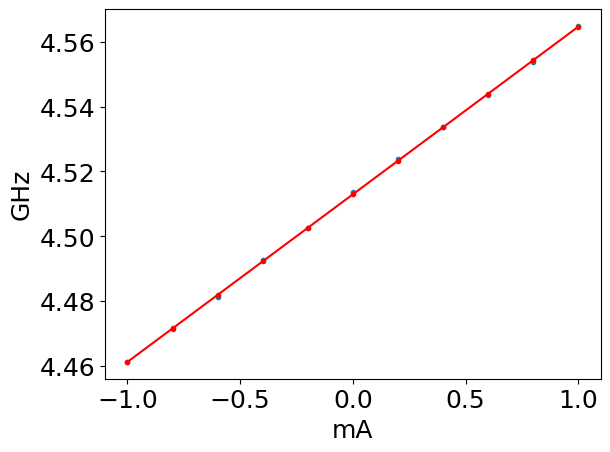

M =  0.05181818181818247


In [173]:
flux_ind = 2

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 3

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f3measuring_q0_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f3measuring_q0_w_flux_q3.h5
minimum q freq 4.49875


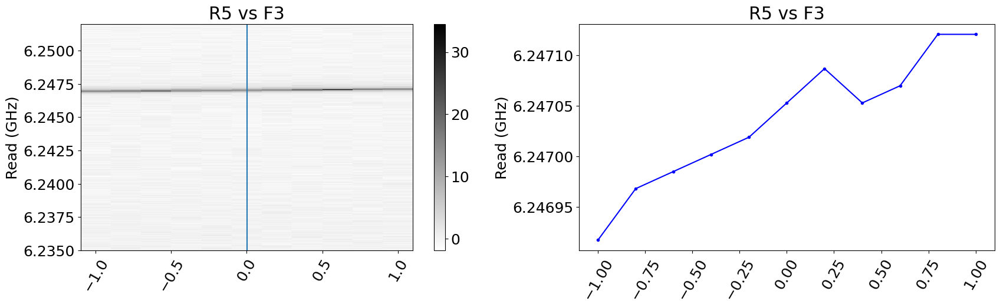

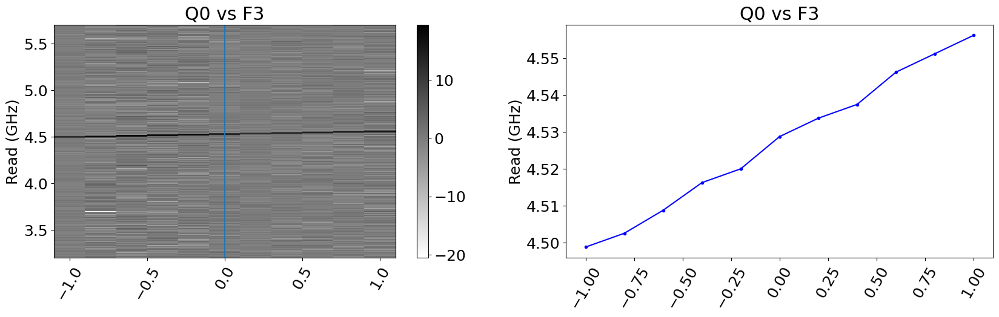

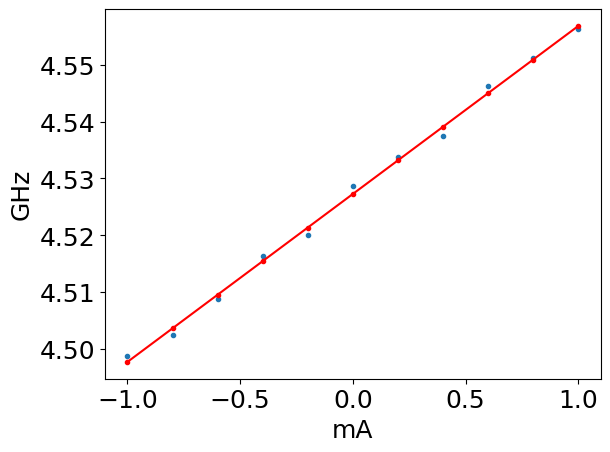

M =  0.0296022727272731
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f3measuring_q1_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f3measuring_q1_w_flux_q3.h5
minimum q freq 4.4675


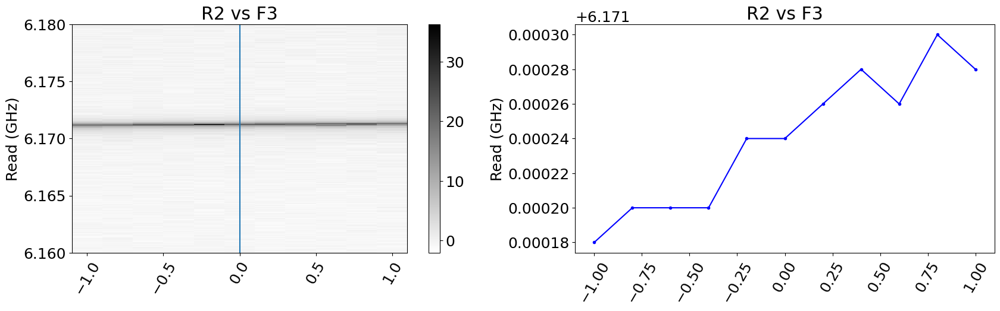

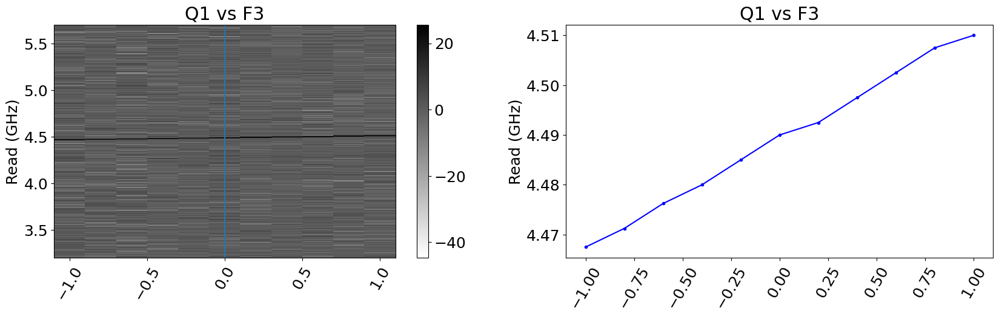

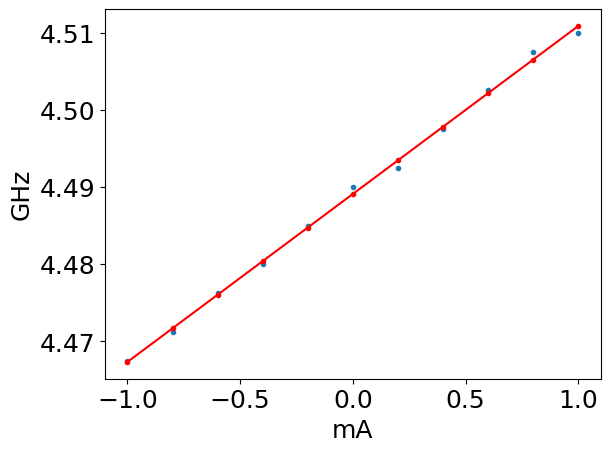

M =  0.021761363636364037
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f3measuring_q2_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f3measuring_q2_w_flux_q3.h5
minimum q freq 4.545


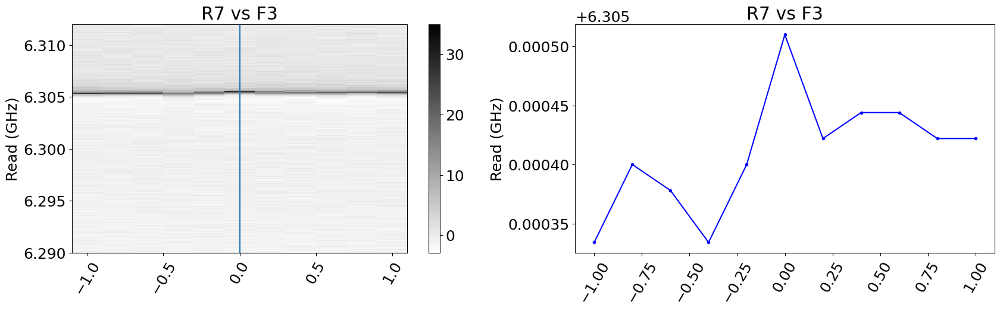

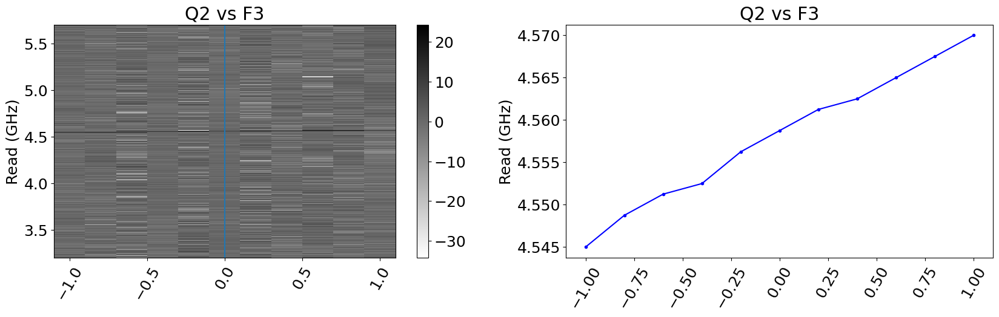

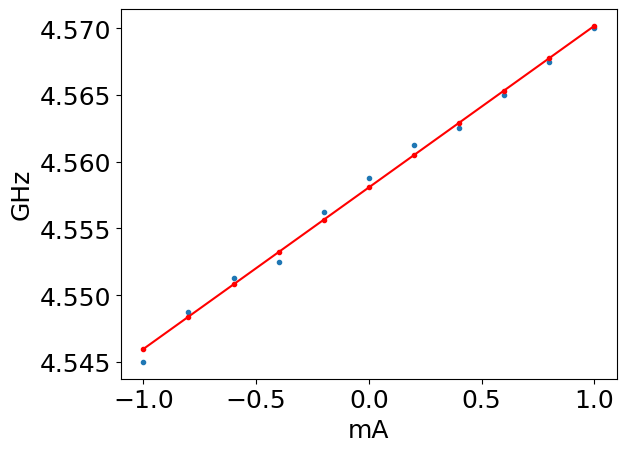

M =  0.012102272727273511
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f3measuring_q3_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f3measuring_q3_w_flux_q3.h5
minimum q freq 4.325


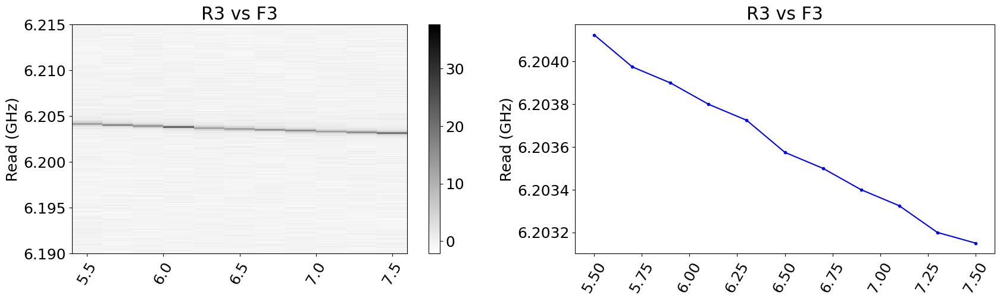

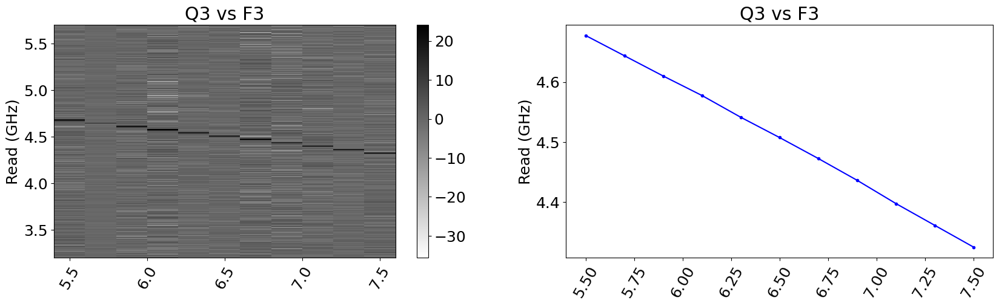

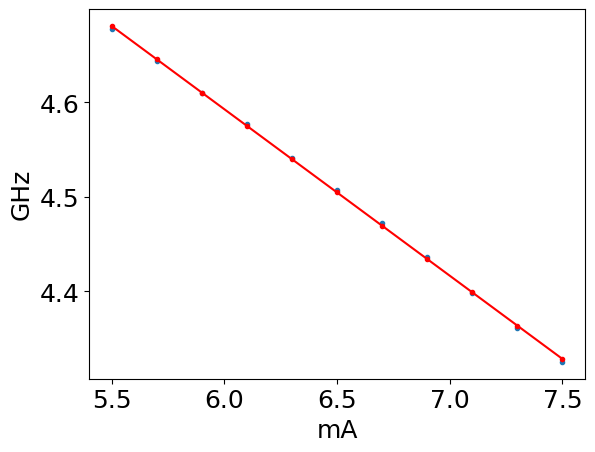

M =  -0.1764204545454541
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f3measuring_q4_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f3measuring_q4_w_flux_q3.h5
minimum q freq 4.4575


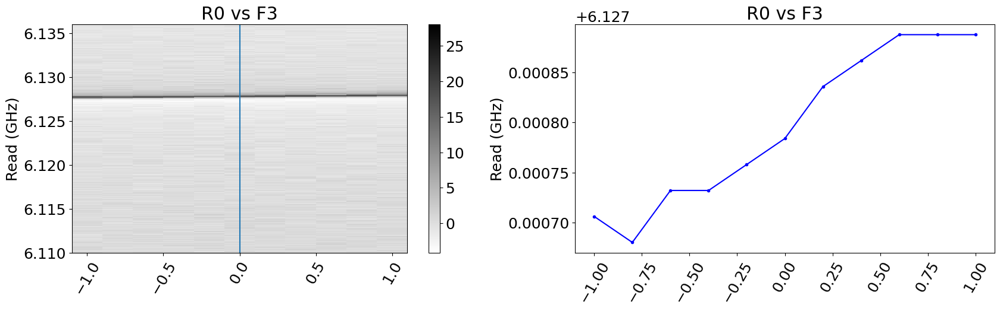

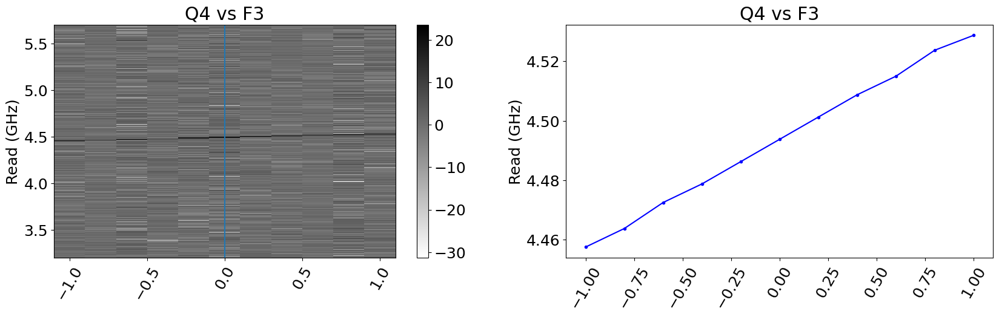

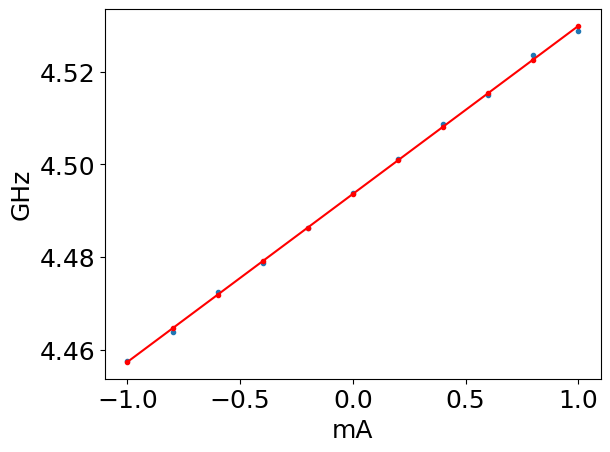

M =  0.036306818181818704
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f3measuring_q5_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f3measuring_q5_w_flux_q3.h5
minimum q freq 4.46375


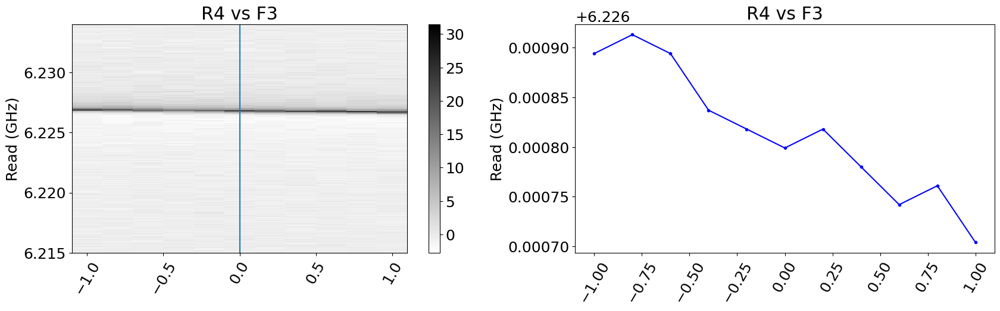

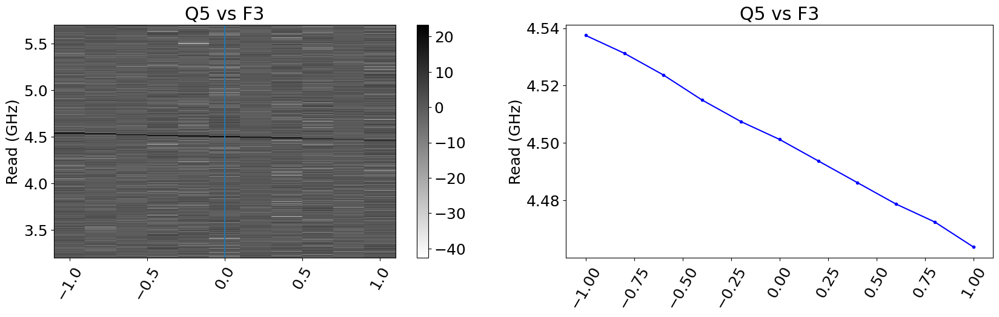

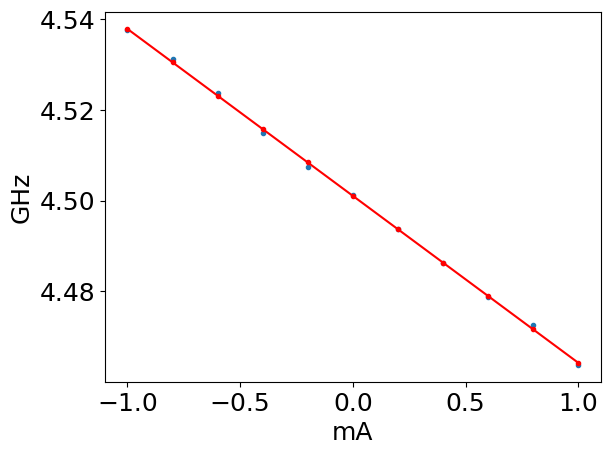

M =  -0.03681818181818106
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f3measuring_q6_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f3measuring_q6_w_flux_q3.h5
minimum q freq 4.48625


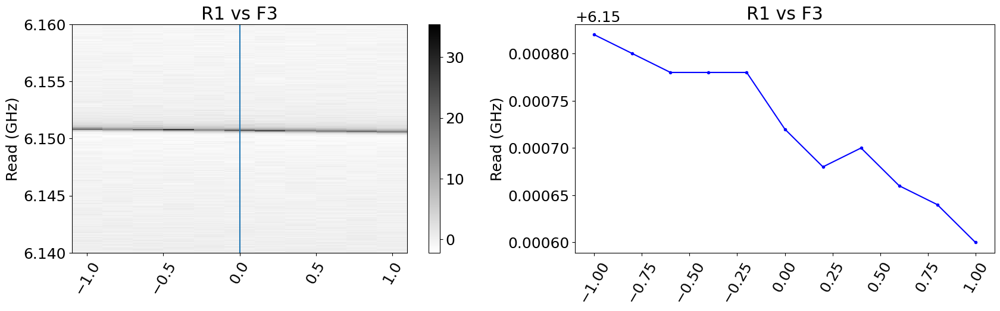

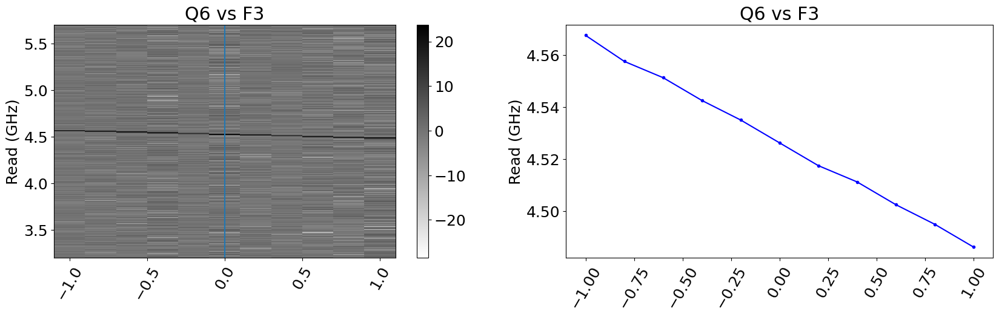

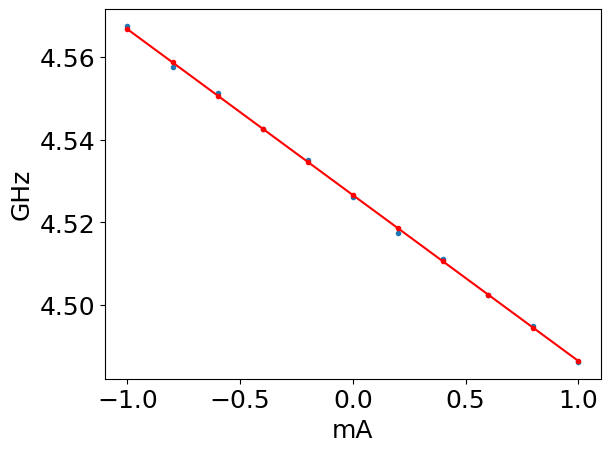

M =  -0.04011363636363567
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f3measuring_q7_w_flux_q3.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f3measuring_q7_w_flux_q3.h5
minimum q freq 4.46625


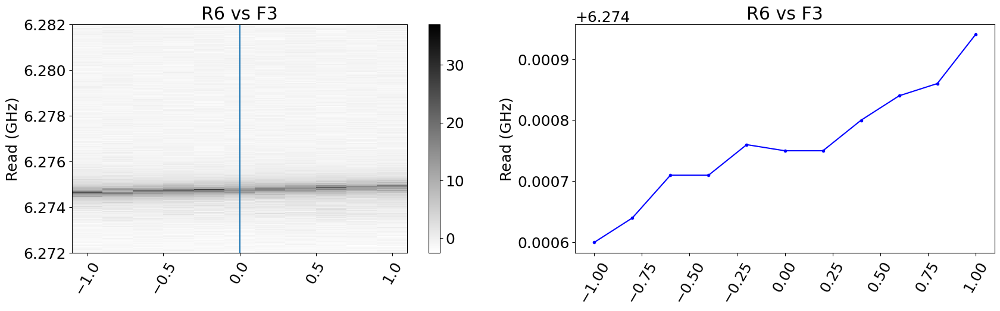

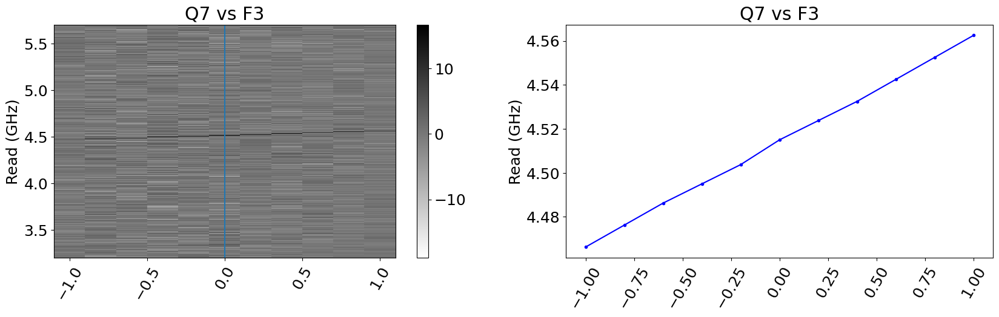

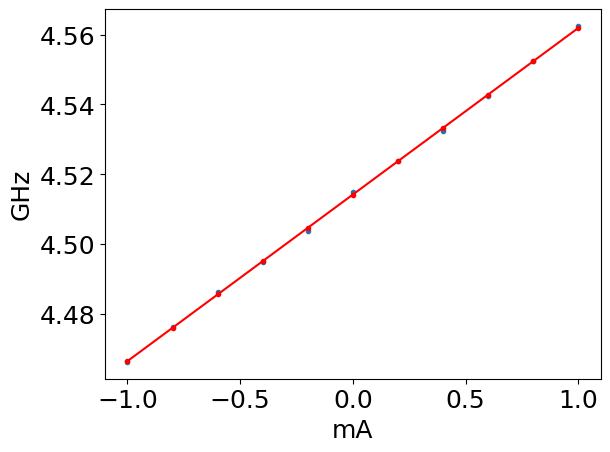

M =  0.0477272727272733


In [174]:
flux_ind = 3

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 4

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f4measuring_q0_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f4measuring_q0_w_flux_q4.h5
minimum q freq 4.49125


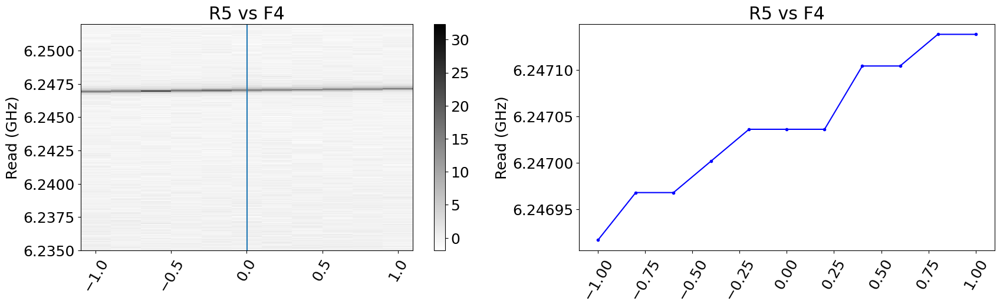

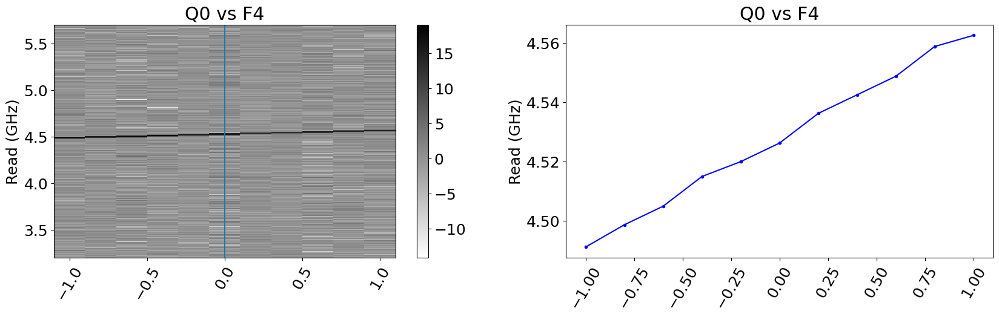

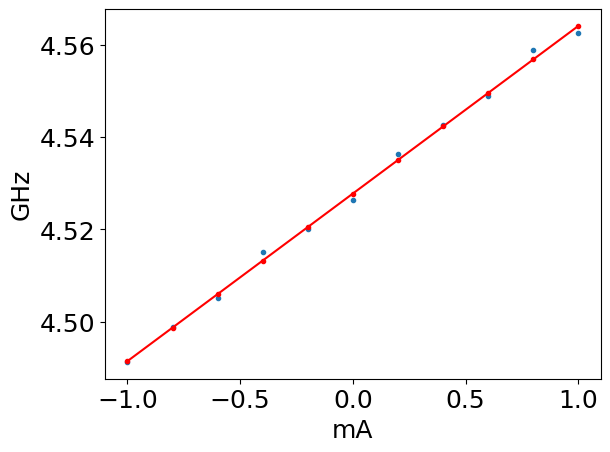

M =  0.03630681818181882
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f4measuring_q1_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f4measuring_q1_w_flux_q4.h5
minimum q freq 4.45


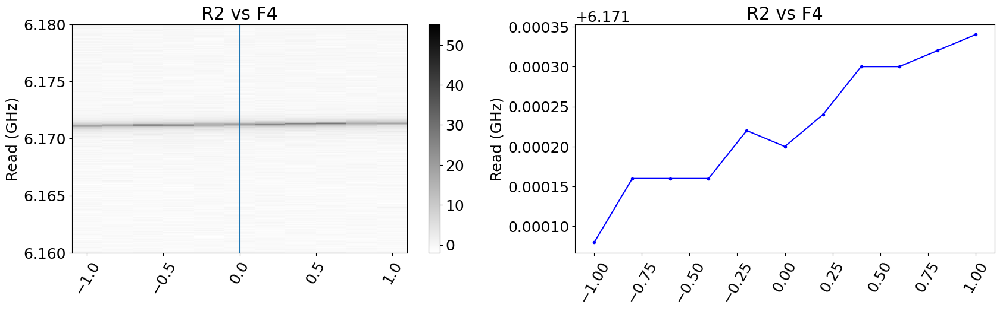

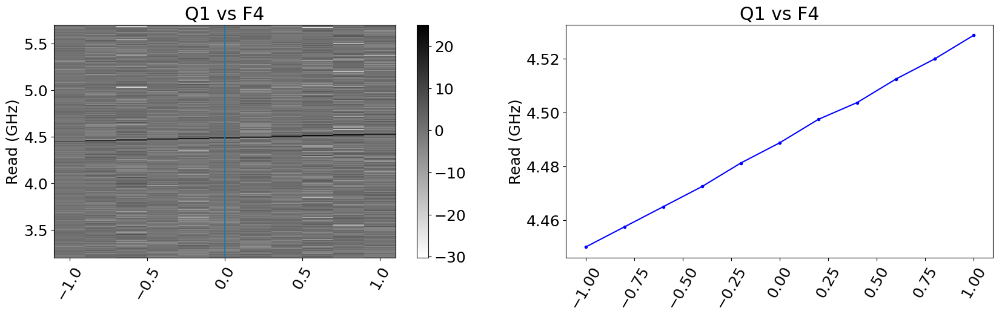

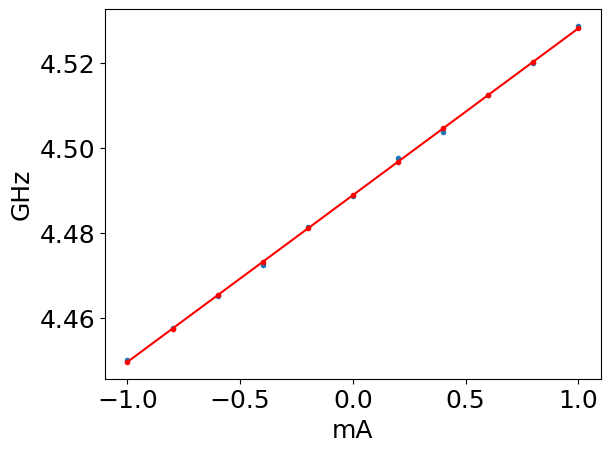

M =  0.03931818181818235
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f4measuring_q2_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f4measuring_q2_w_flux_q4.h5
minimum q freq 4.5175


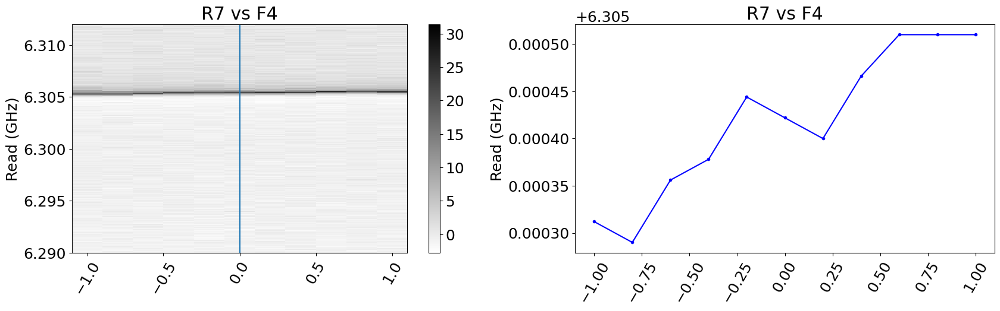

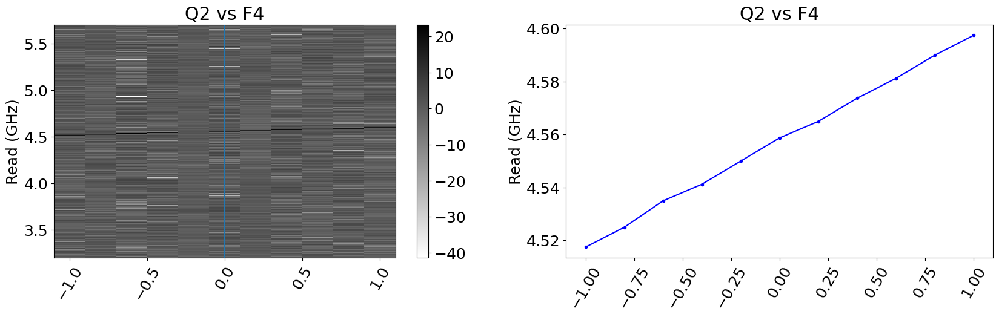

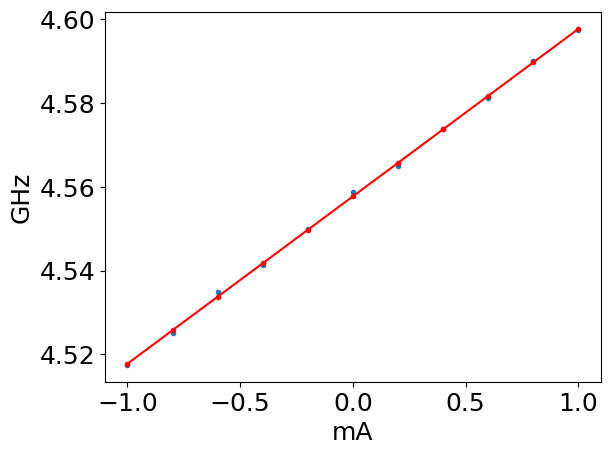

M =  0.03994318181818239
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f4measuring_q3_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f4measuring_q3_w_flux_q4.h5
minimum q freq 4.47375


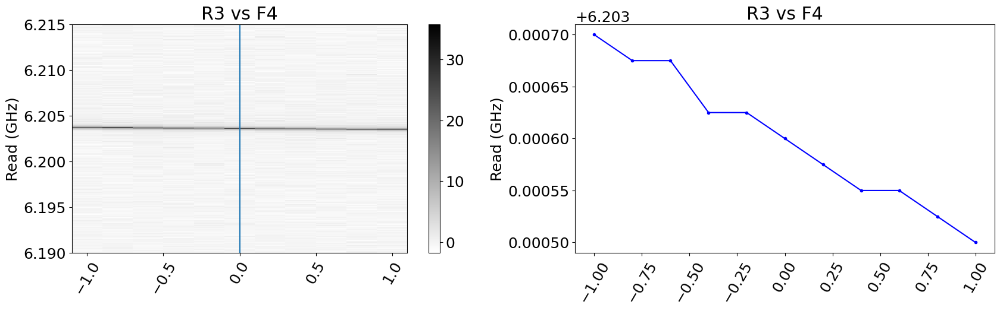

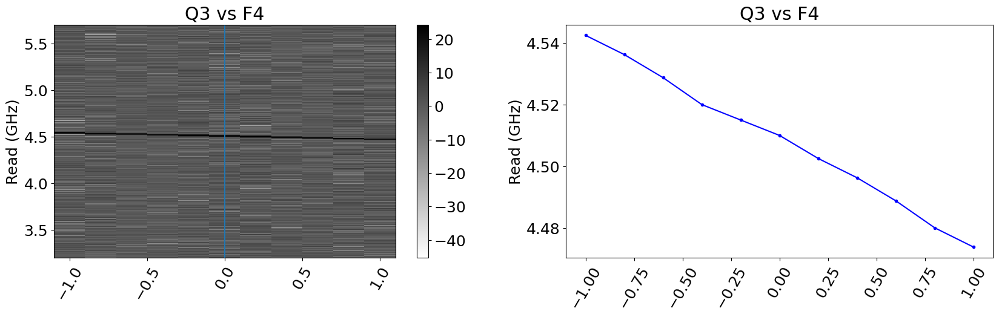

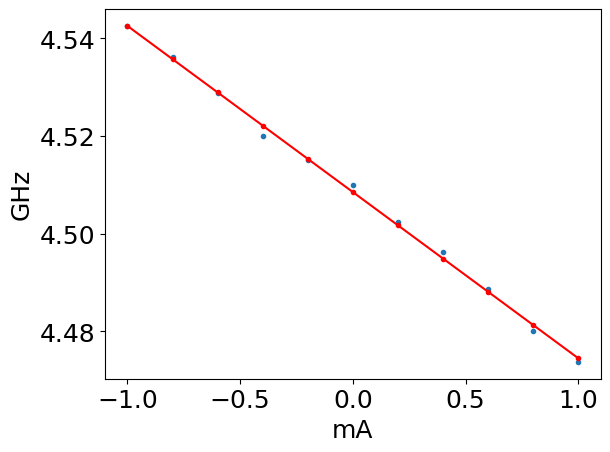

M =  -0.034034090909090195
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f4measuring_q4_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f4measuring_q4_w_flux_q4.h5
minimum q freq 4.3025


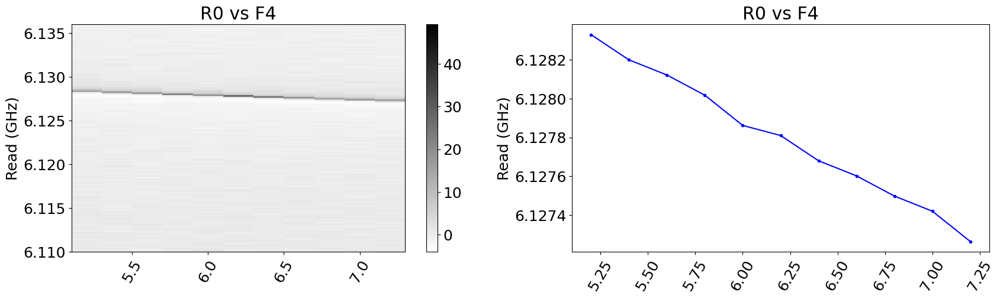

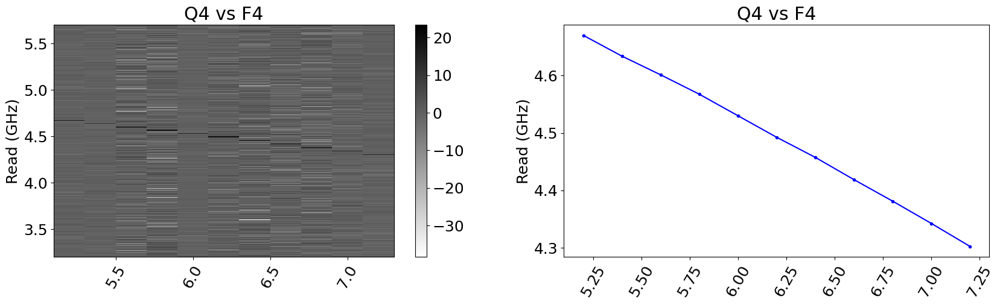

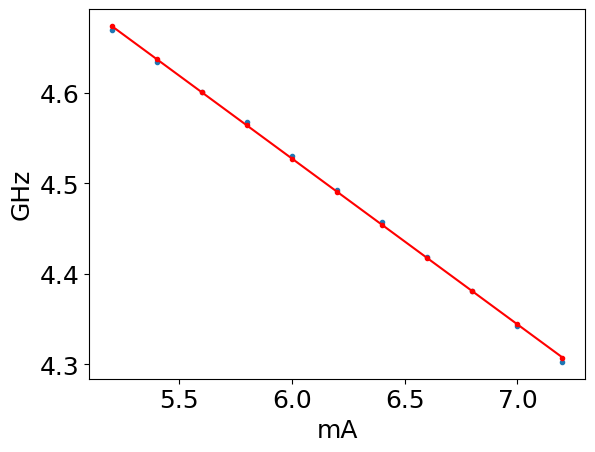

M =  -0.18329545454545476
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f4measuring_q5_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f4measuring_q5_w_flux_q4.h5
minimum q freq 4.4875


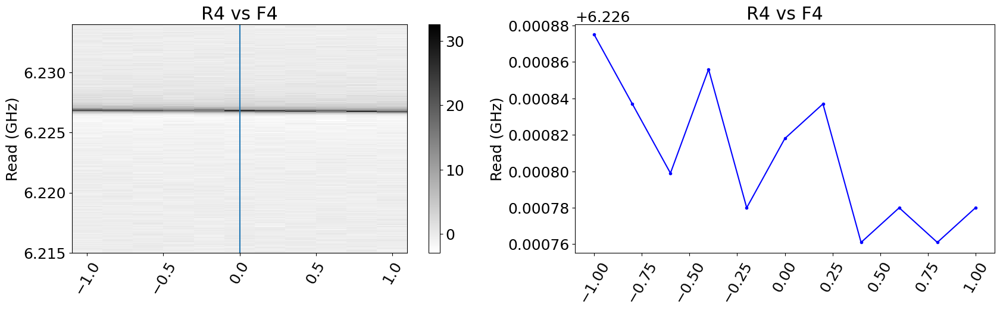

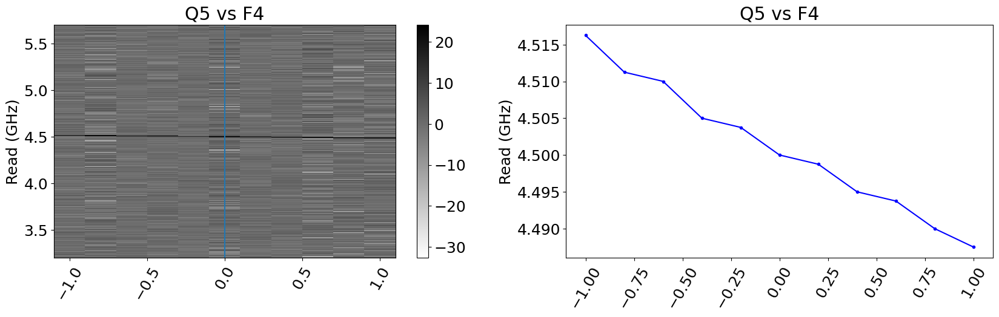

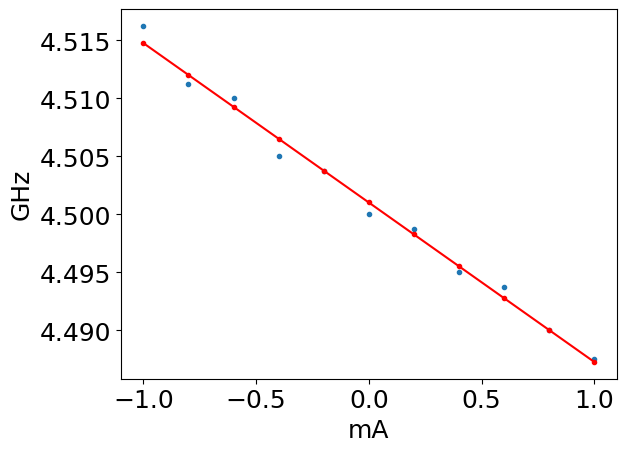

M =  -0.013749999999999511
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f4measuring_q6_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f4measuring_q6_w_flux_q4.h5
minimum q freq 4.50375


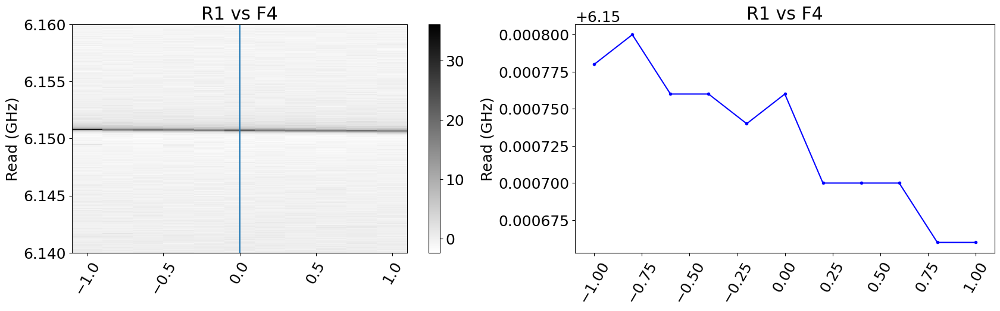

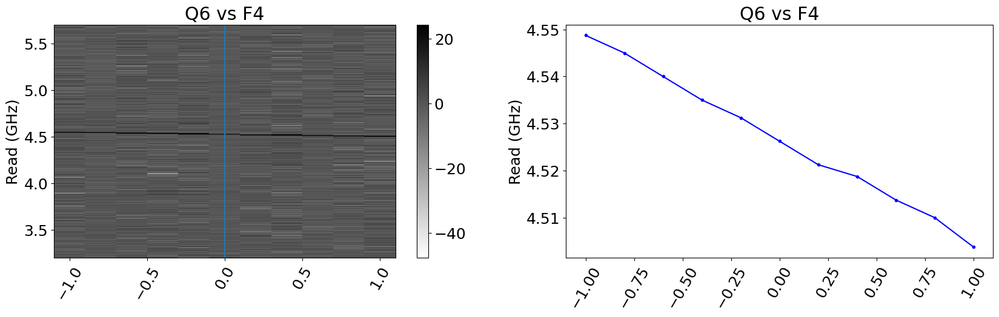

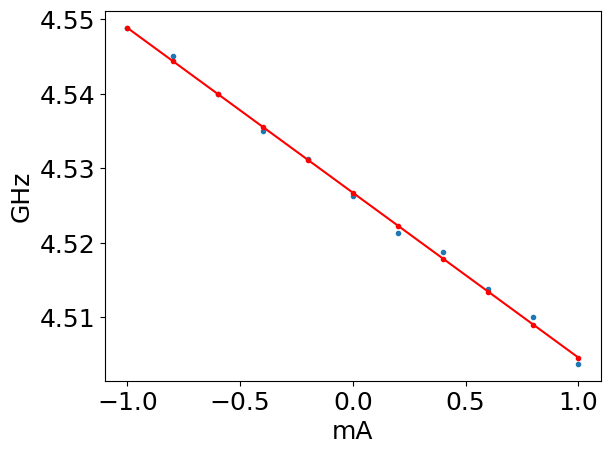

M =  -0.02210227272727221
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f4measuring_q7_w_flux_q4.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f4measuring_q7_w_flux_q4.h5
minimum q freq 4.47875


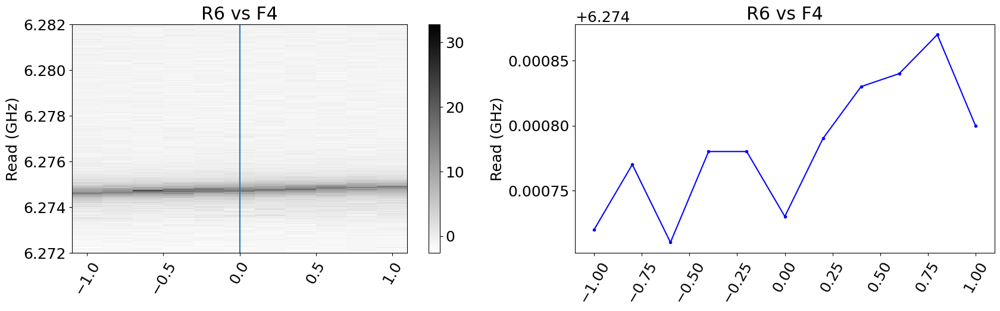

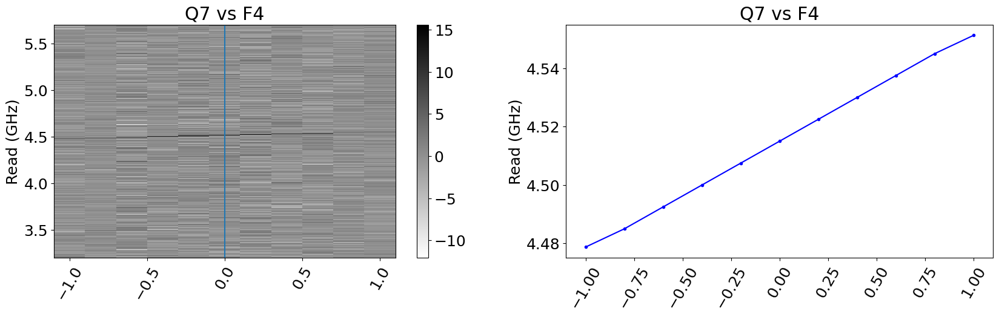

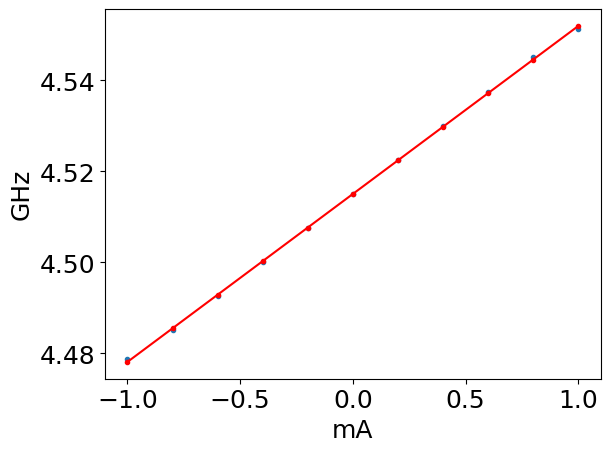

M =  0.036931818181818704


In [175]:
flux_ind = 4

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 5

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f5measuring_q0_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f5measuring_q0_w_flux_q5.h5
minimum q freq 4.4875


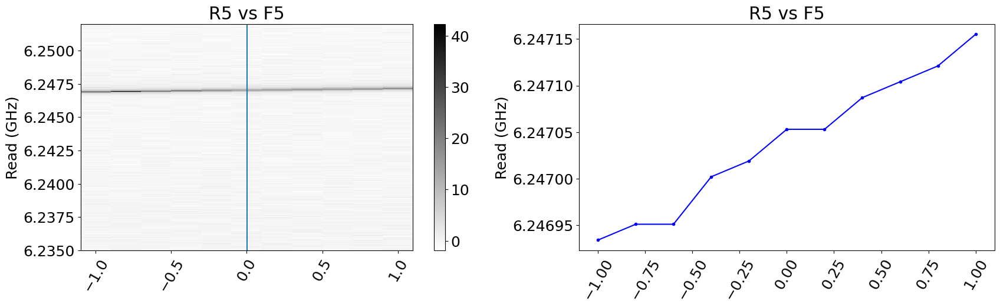

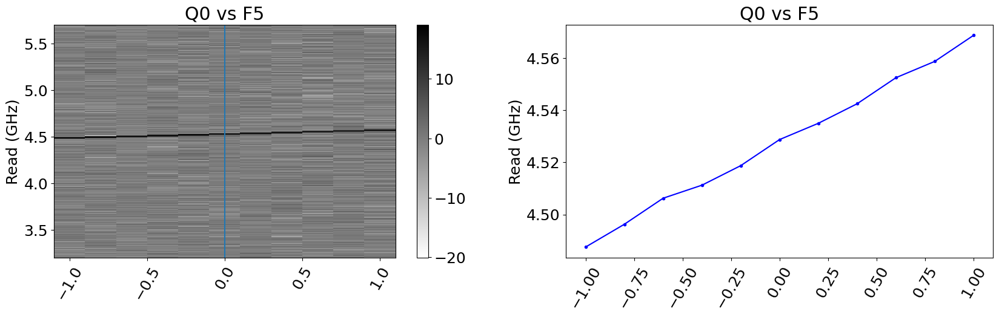

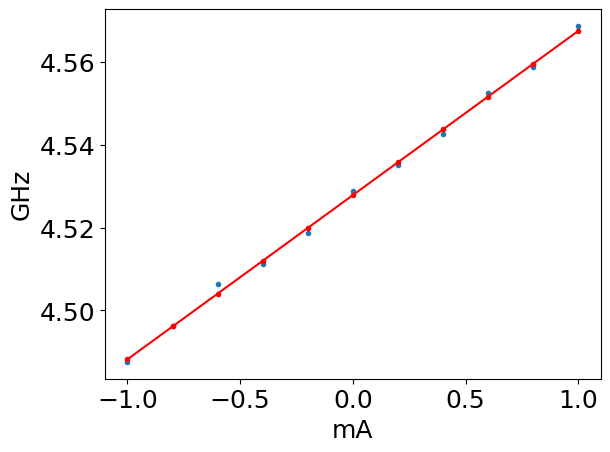

M =  0.03971590909090973
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f5measuring_q1_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f5measuring_q1_w_flux_q5.h5
minimum q freq 3.86


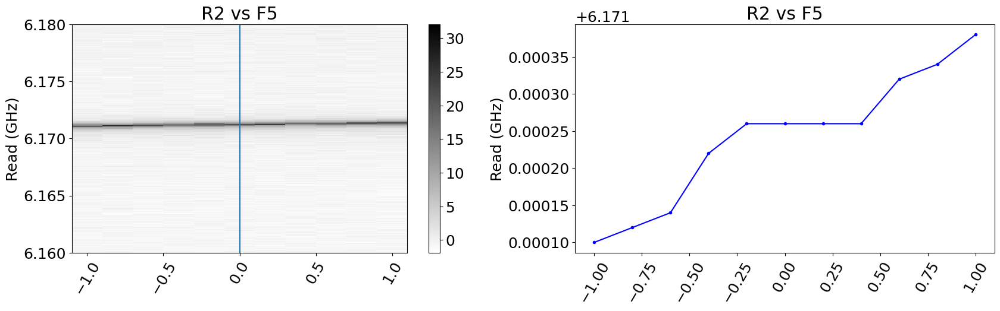

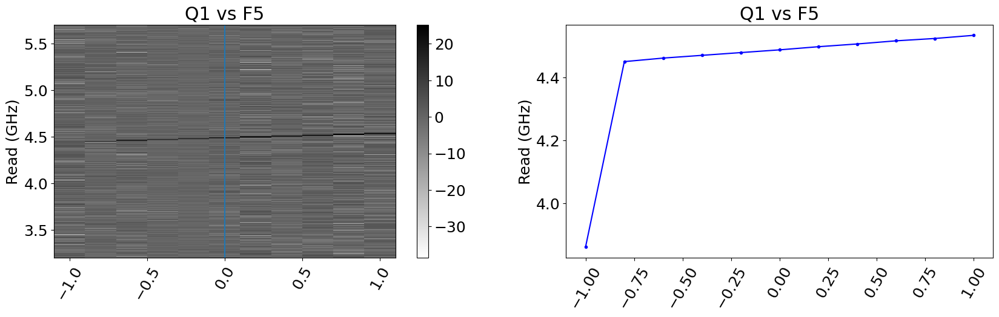

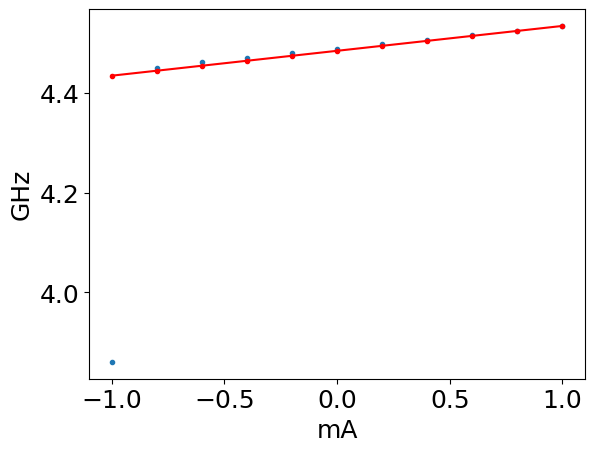

M =  0.04999999999999832
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f5measuring_q2_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f5measuring_q2_w_flux_q5.h5
minimum q freq 4.50625


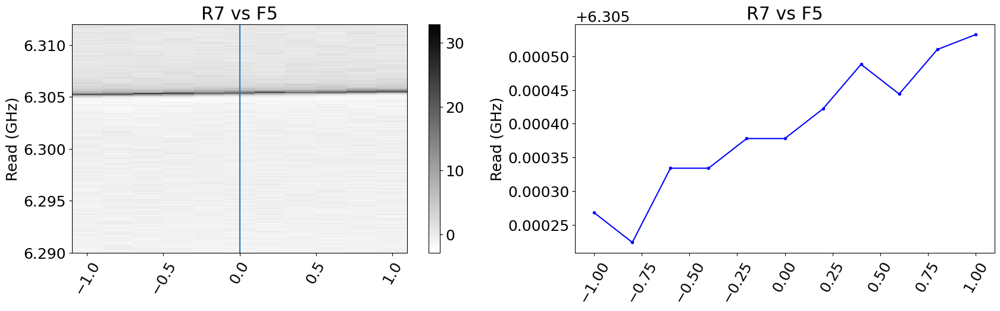

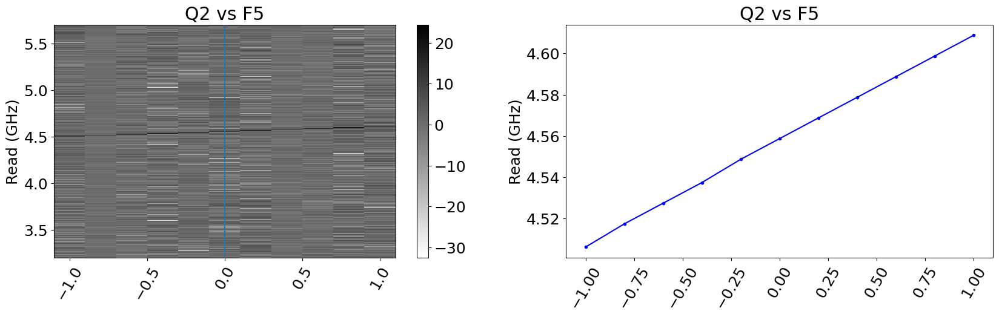

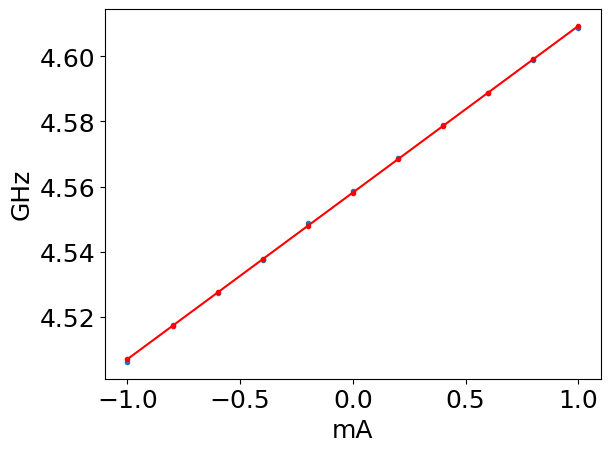

M =  0.05107954545454635
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f5measuring_q3_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f5measuring_q3_w_flux_q5.h5
minimum q freq 4.45375


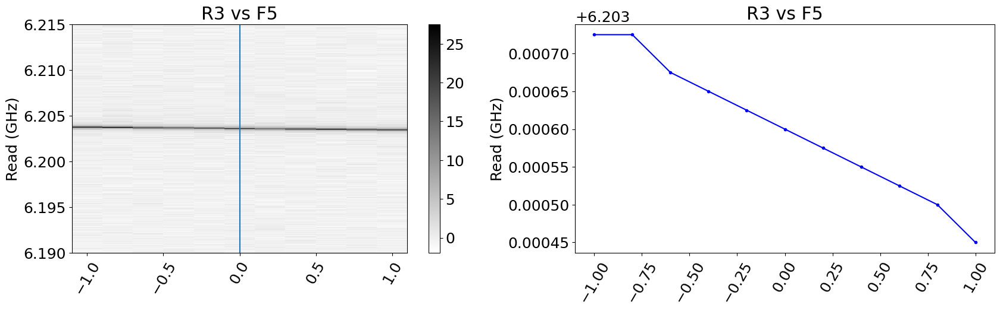

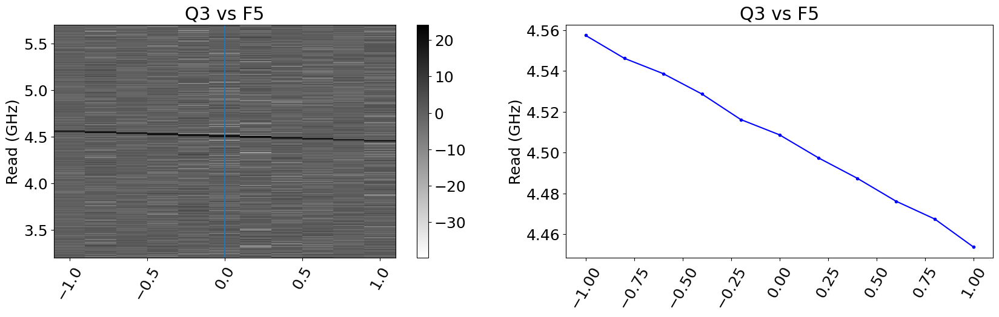

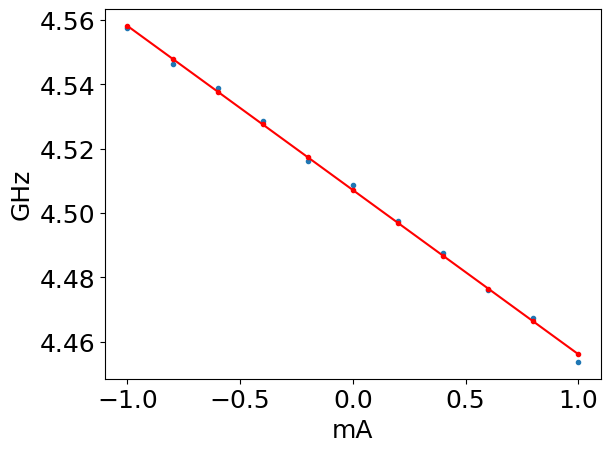

M =  -0.05102272727272661
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f5measuring_q4_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f5measuring_q4_w_flux_q5.h5
minimum q freq 4.4425


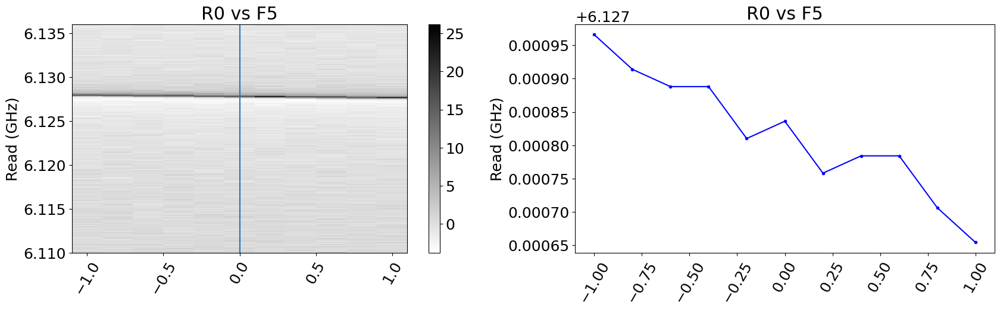

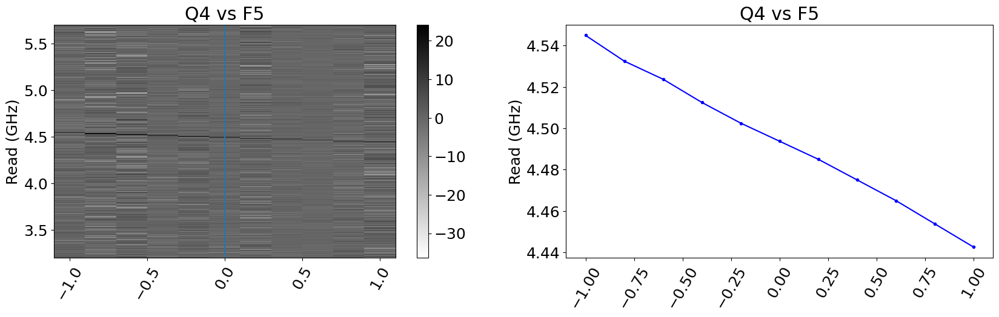

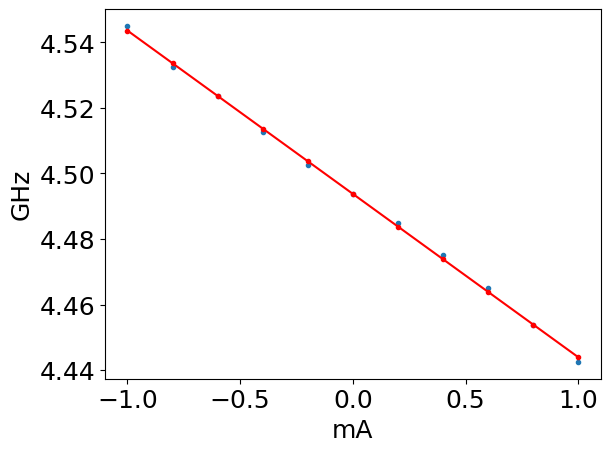

M =  -0.04982954545454502
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f5measuring_q5_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f5measuring_q5_w_flux_q5.h5
minimum q freq 4.275


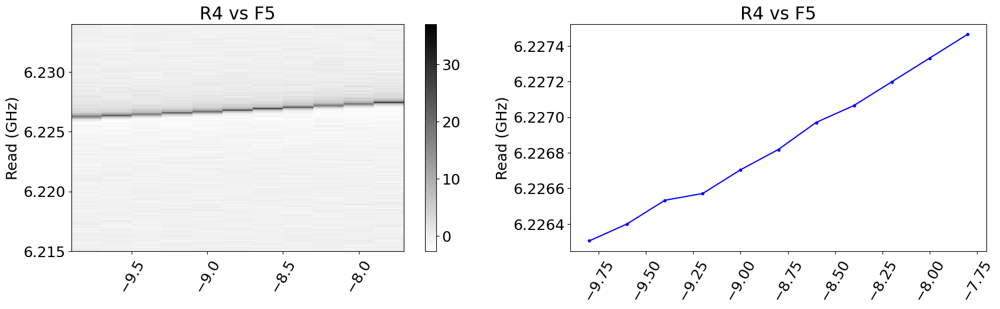

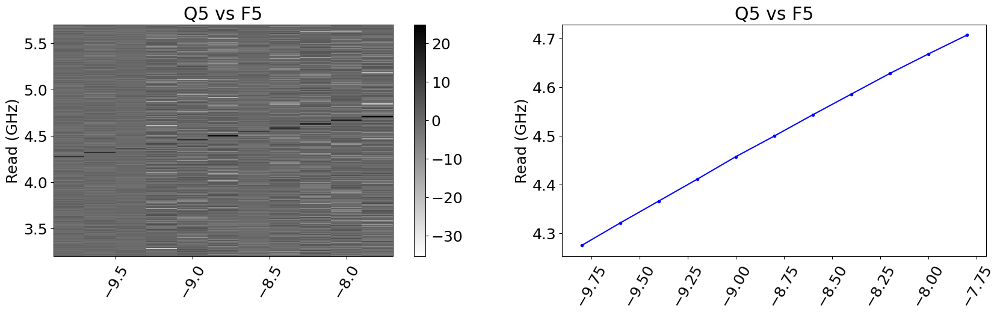

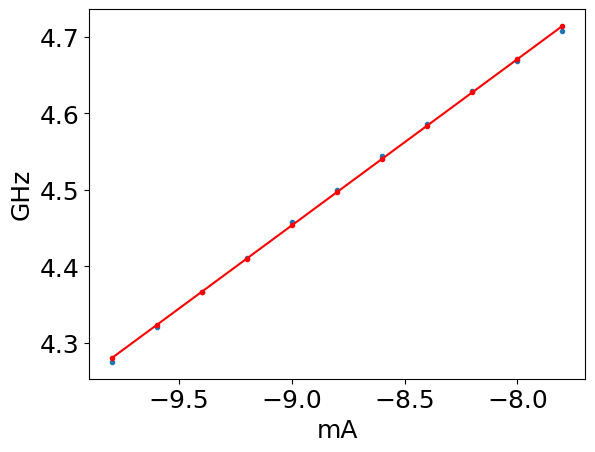

M =  0.21710227272727367
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f5measuring_q6_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f5measuring_q6_w_flux_q5.h5
minimum q freq 4.5175


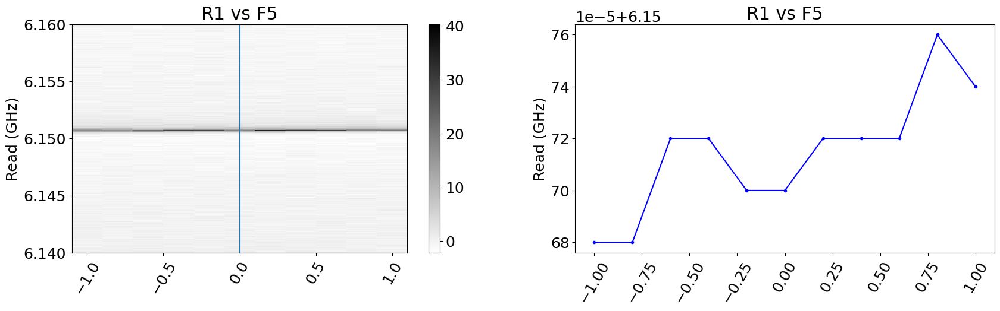

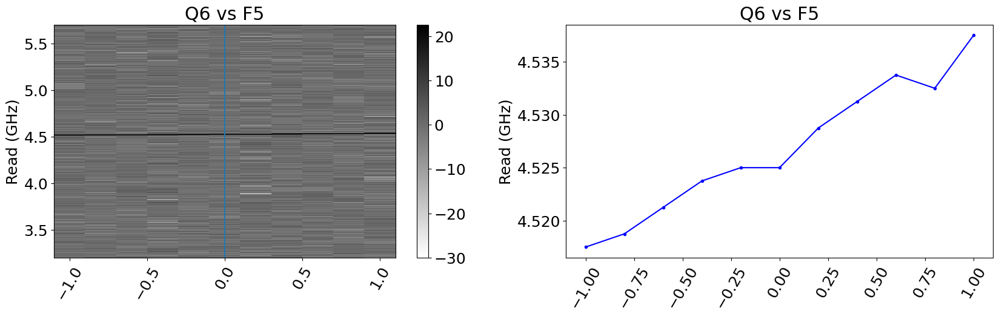

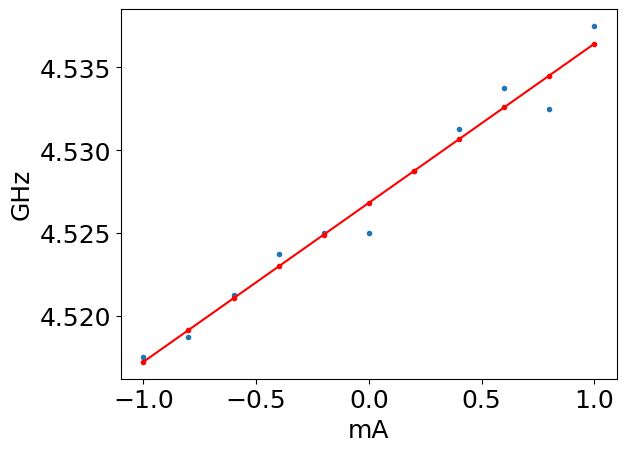

M =  0.009602272727273195
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f5measuring_q7_w_flux_q5.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f5measuring_q7_w_flux_q5.h5
minimum q freq 4.50625


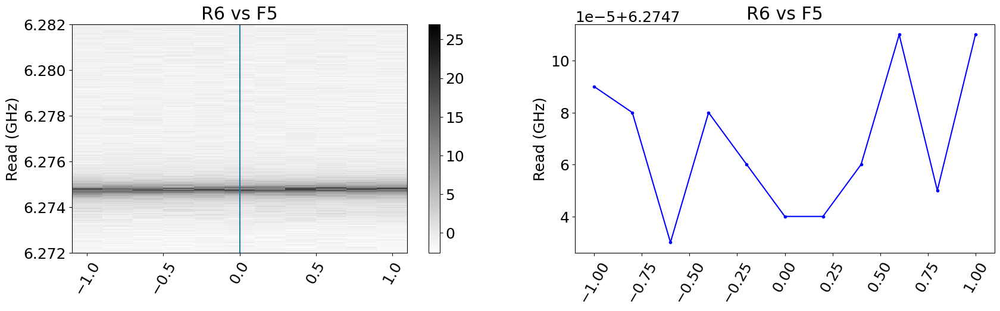

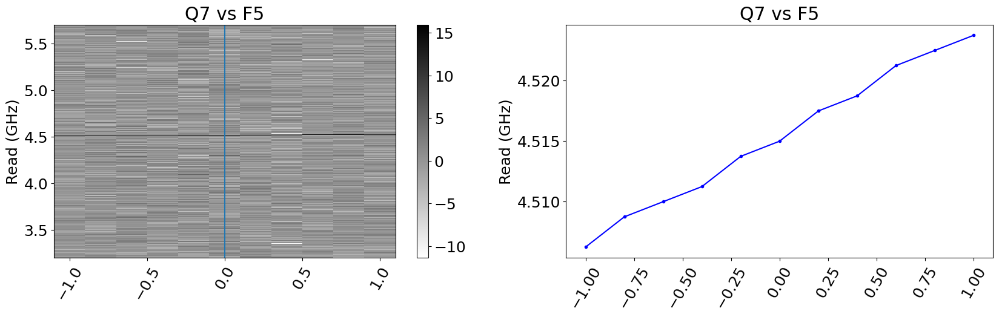

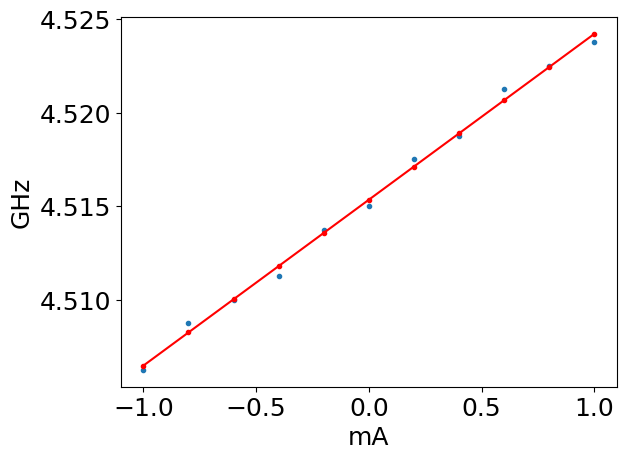

M =  0.008863636363637012


In [176]:
flux_ind = 5

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    if q_ind == 1:
        fit = np.polyfit(xdata[9:], ydata[9:], 1)
    else:
        fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 6

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f6measuring_q0_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f6measuring_q0_w_flux_q6.h5
minimum q freq 4.4875


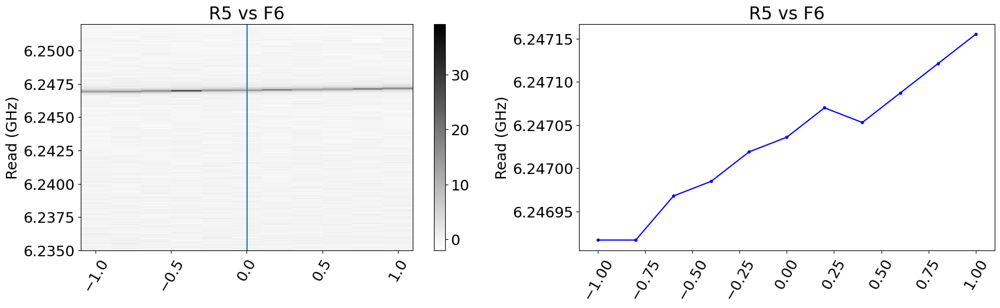

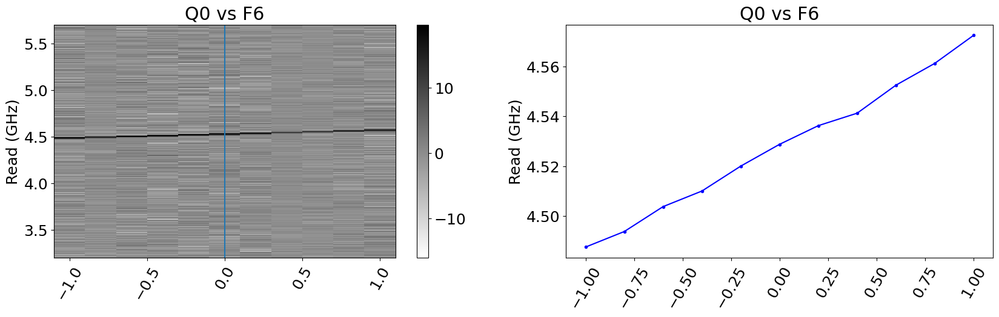

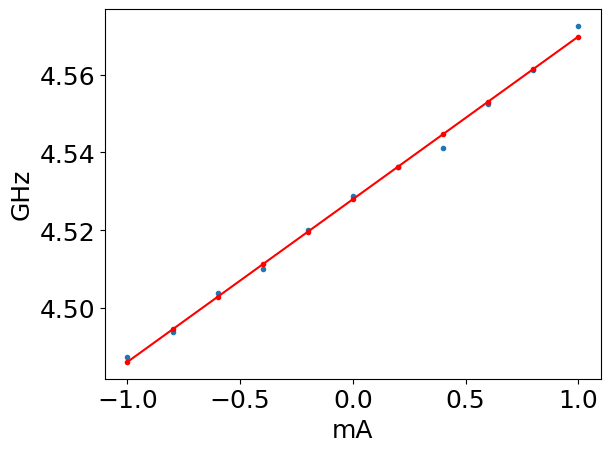

M =  0.04181818181818258
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f6measuring_q1_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f6measuring_q1_w_flux_q6.h5
minimum q freq 4.44875


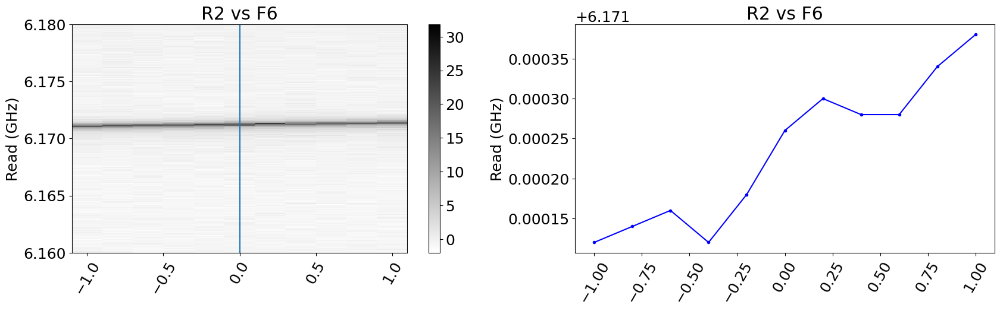

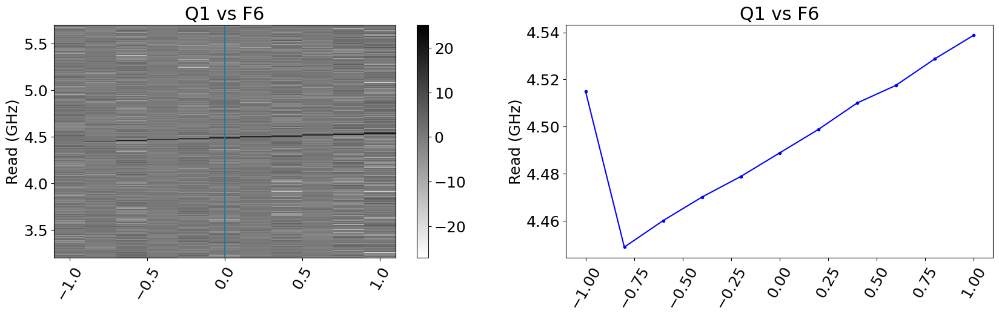

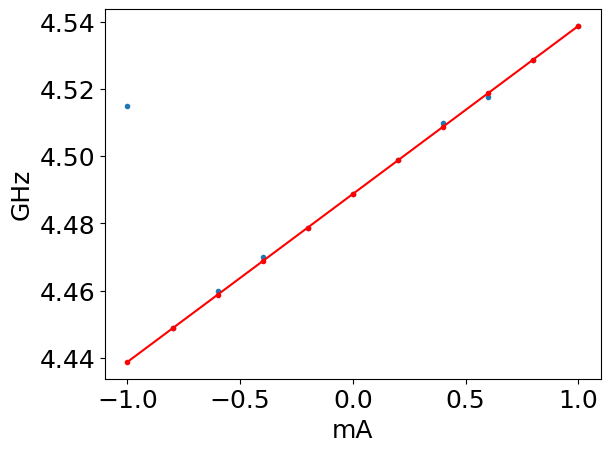

M =  0.05000000000000283
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f6measuring_q2_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f6measuring_q2_w_flux_q6.h5
minimum q freq 4.50125


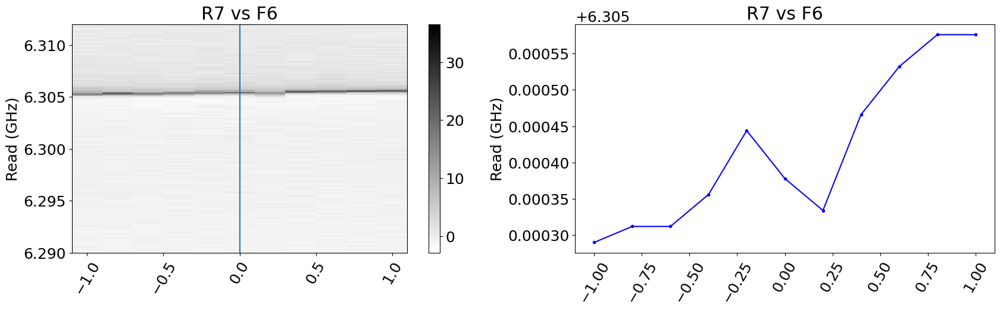

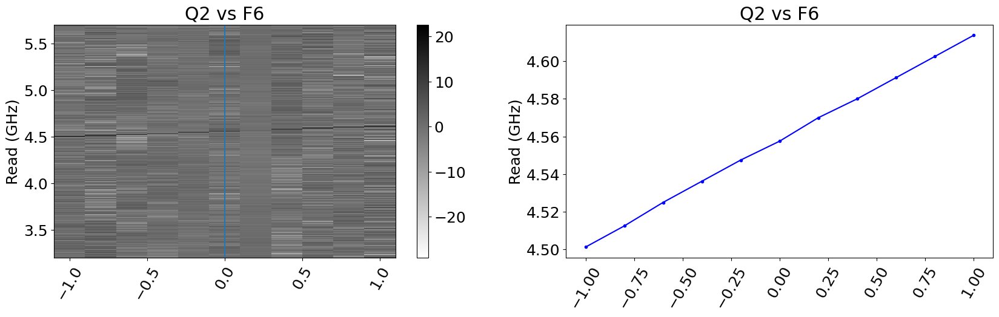

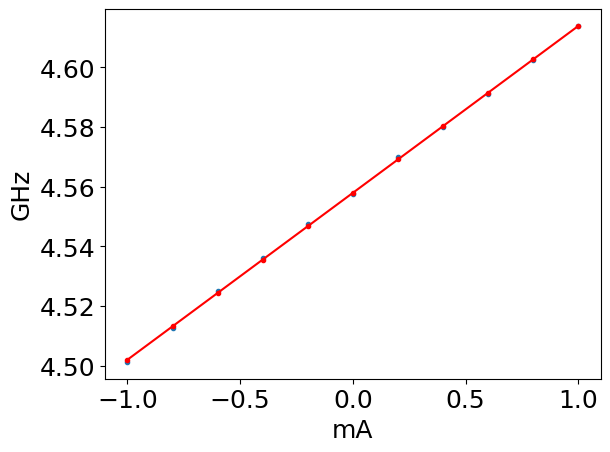

M =  0.055965909090909725
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f6measuring_q3_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f6measuring_q3_w_flux_q6.h5
minimum q freq 4.44625


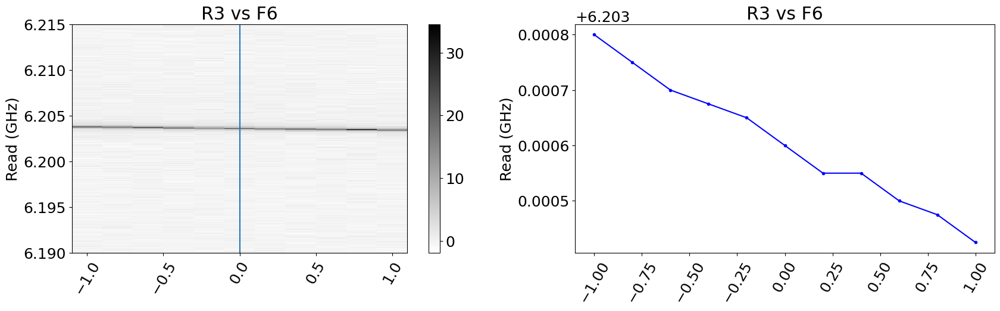

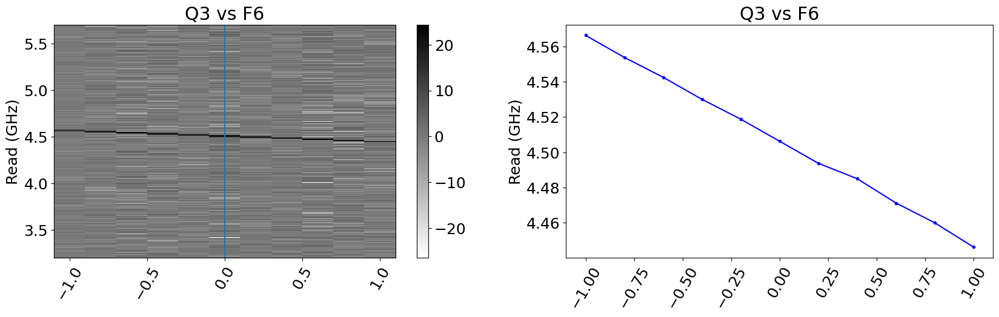

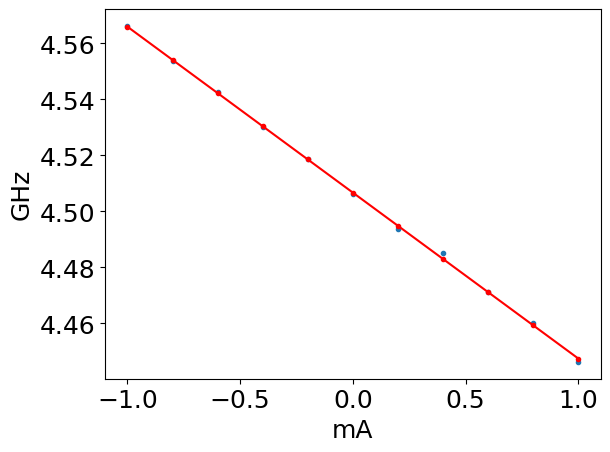

M =  -0.059261363636363
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f6measuring_q4_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f6measuring_q4_w_flux_q6.h5
minimum q freq 4.4325


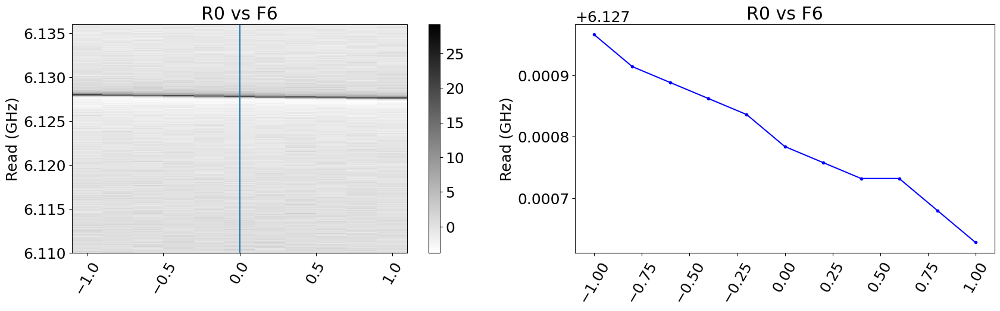

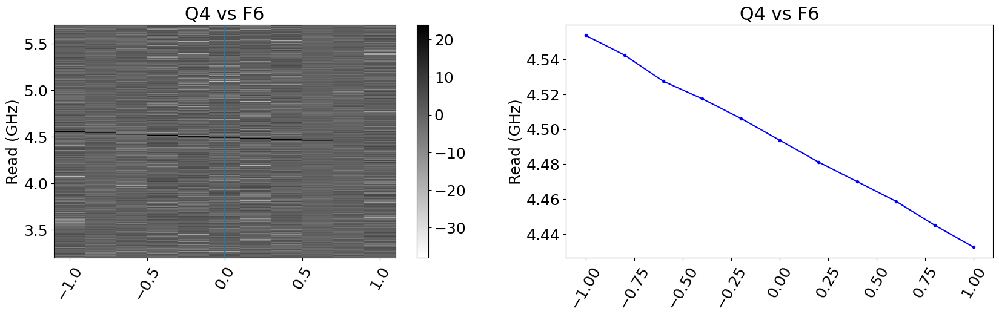

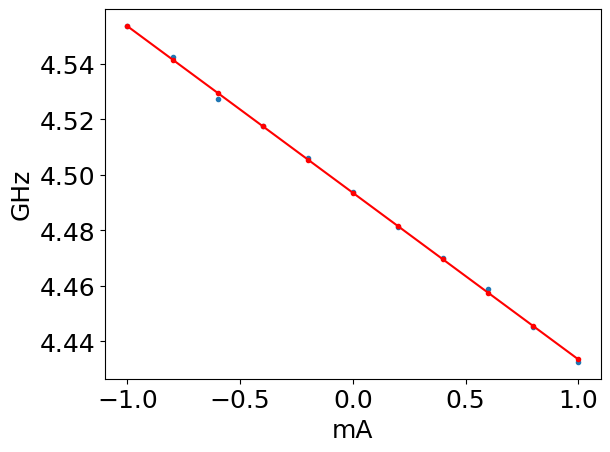

M =  -0.06011363636363575
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f6measuring_q5_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f6measuring_q5_w_flux_q6.h5
minimum q freq 4.44


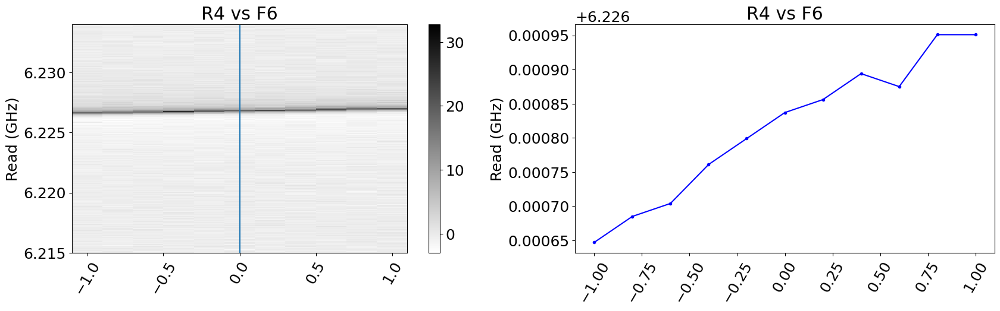

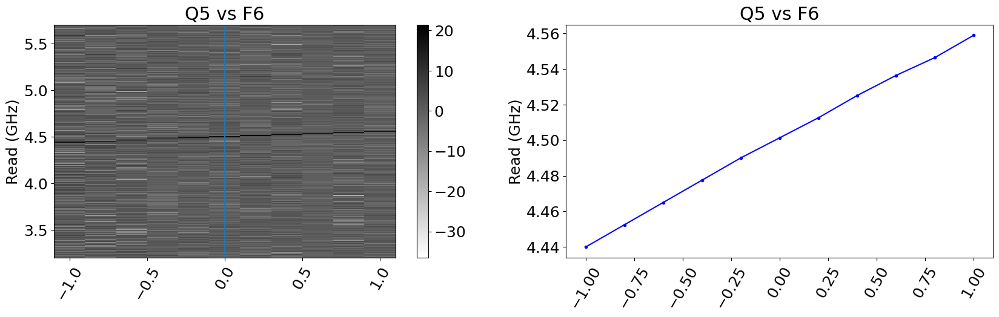

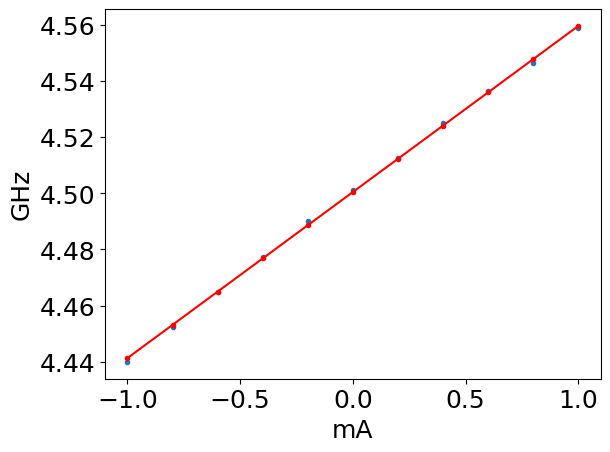

M =  0.05909090909090983
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f6measuring_q6_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f6measuring_q6_w_flux_q6.h5
minimum q freq 4.28125


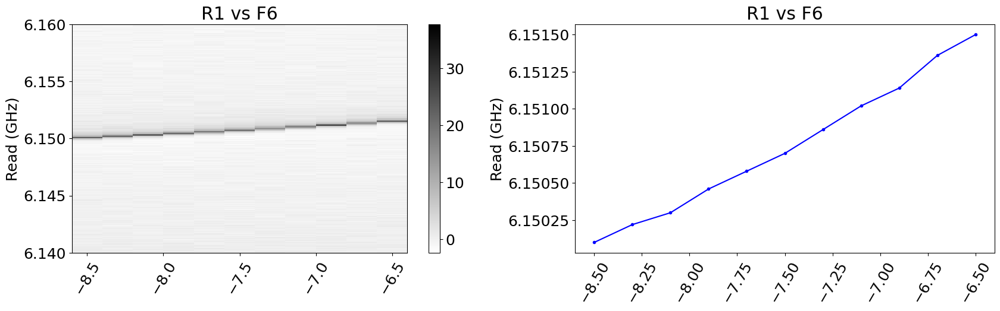

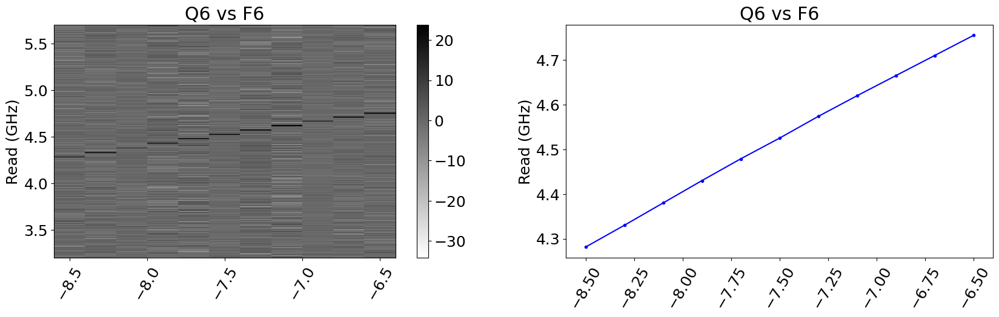

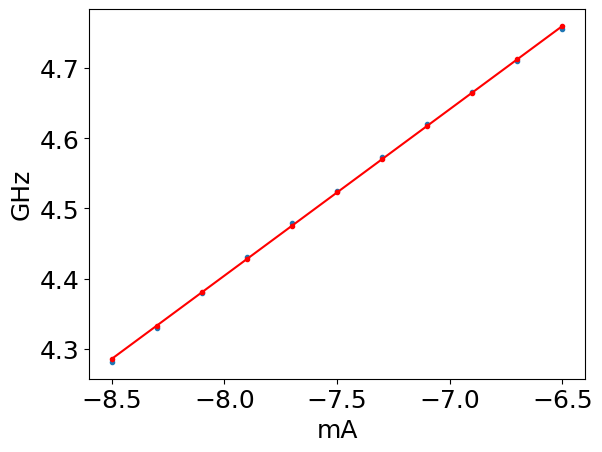

M =  0.23721590909090928
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f6measuring_q7_w_flux_q6.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f6measuring_q7_w_flux_q6.h5
minimum q freq 4.4925


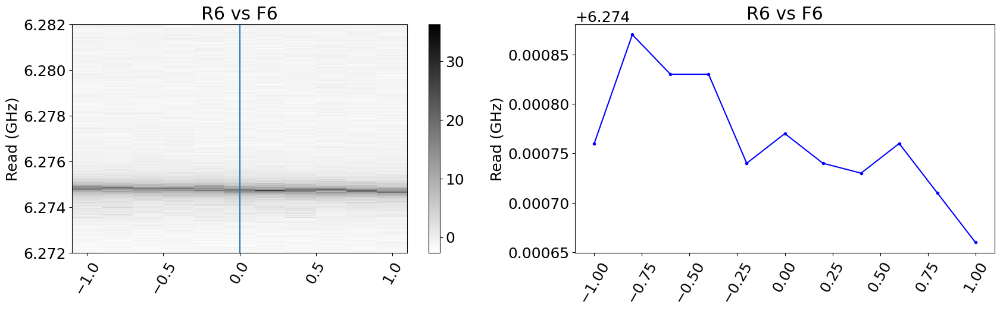

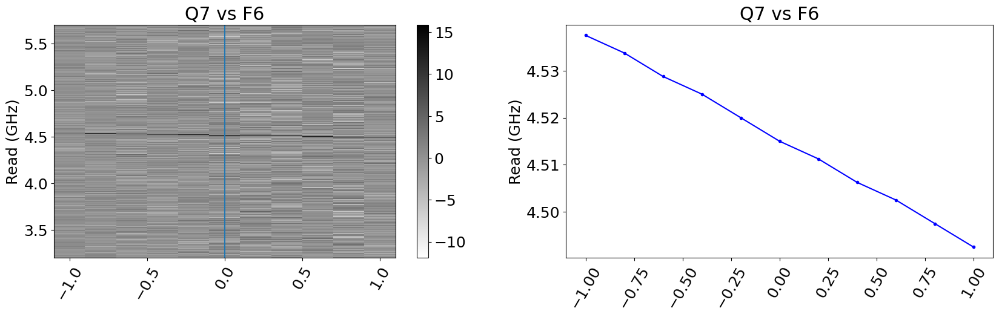

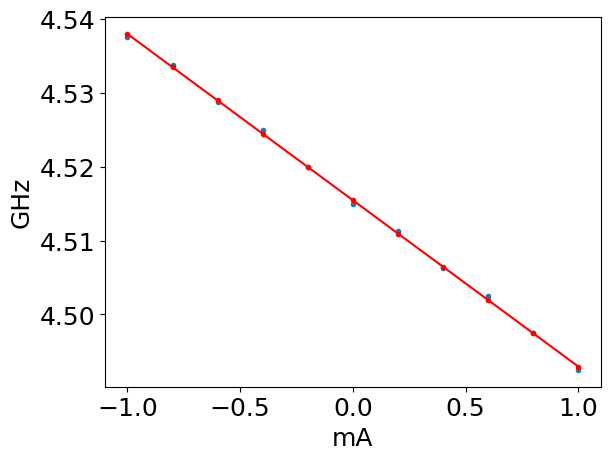

M =  -0.0224999999999995


In [177]:
flux_ind = 6

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    if q_ind == 1:
        fit = np.polyfit(xdata[9:], ydata[9:], 1)
    else:
        fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### Flux line 7

0
data_crosstalk\00000_flux_map-2025-01-17_r5_f7measuring_q0_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r5_f7measuring_q0_w_flux_q7.h5
minimum q freq 4.49


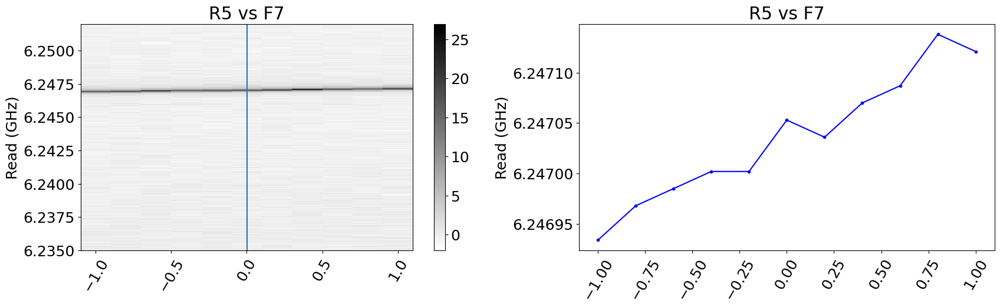

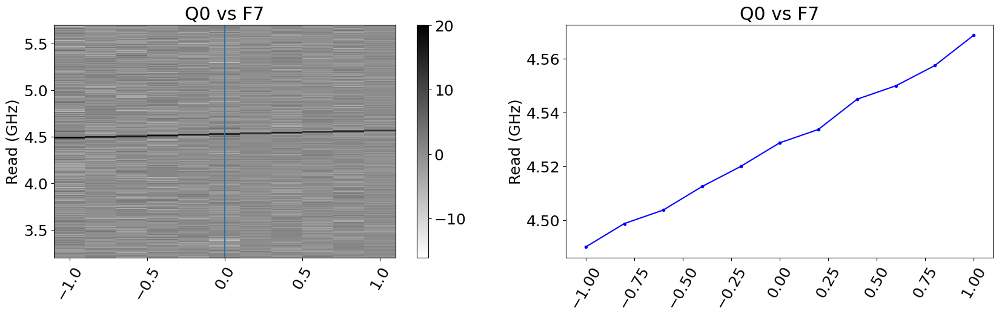

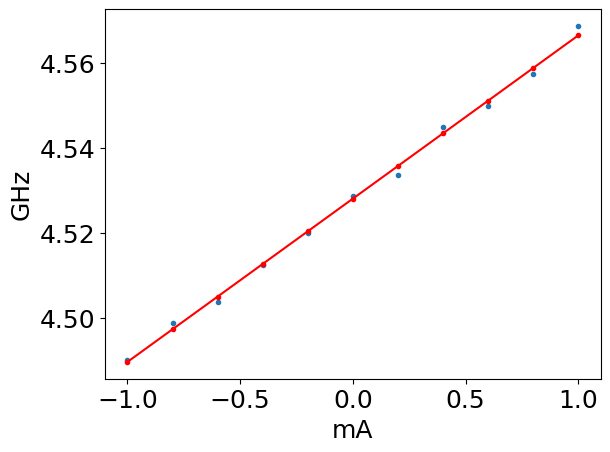

M =  0.0384659090909094
1
data_crosstalk\00000_flux_map-2025-01-17_r2_f7measuring_q1_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-17_r2_f7measuring_q1_w_flux_q7.h5
minimum q freq 3.75


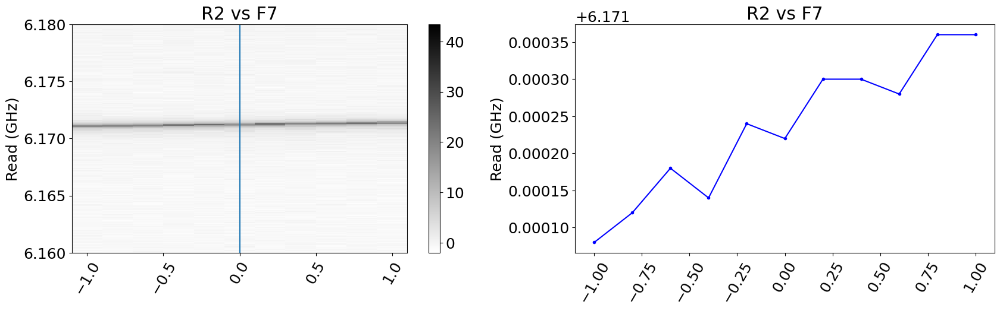

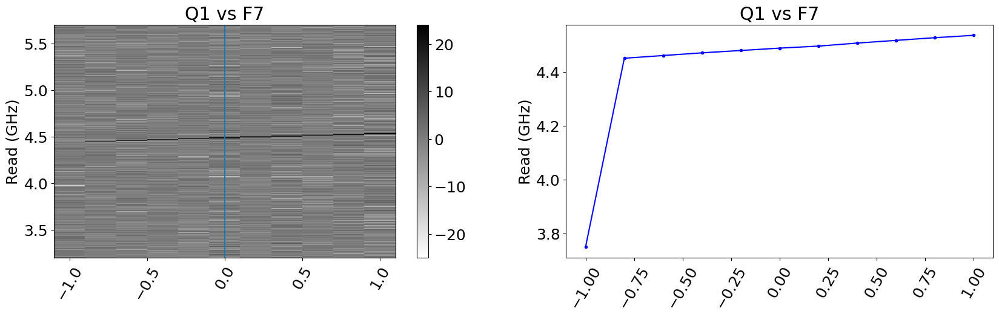

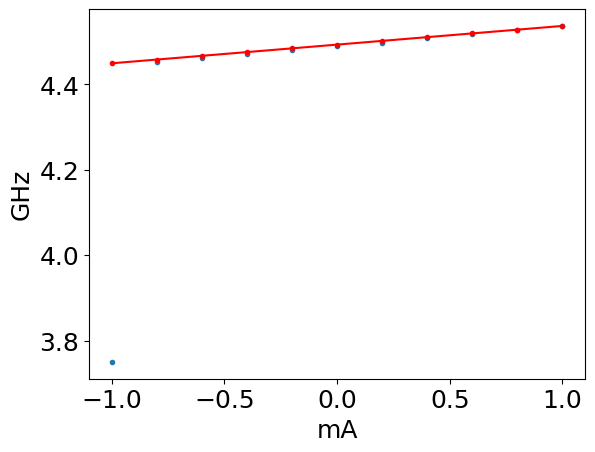

M =  0.043749999999999525
2
data_crosstalk\00000_flux_map-2025-01-18_r7_f7measuring_q2_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r7_f7measuring_q2_w_flux_q7.h5
minimum q freq 4.50125


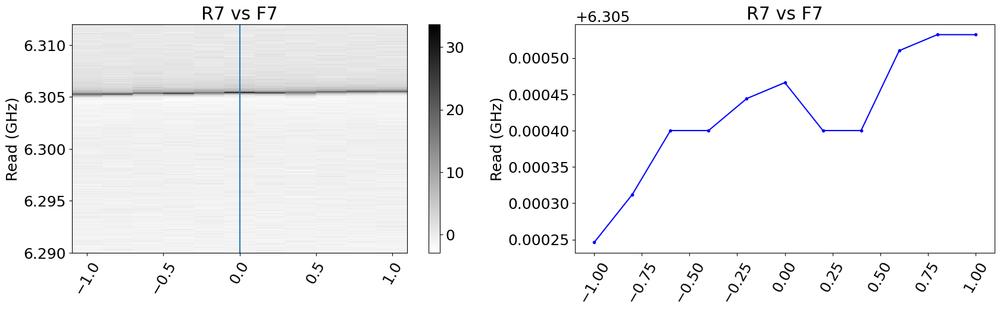

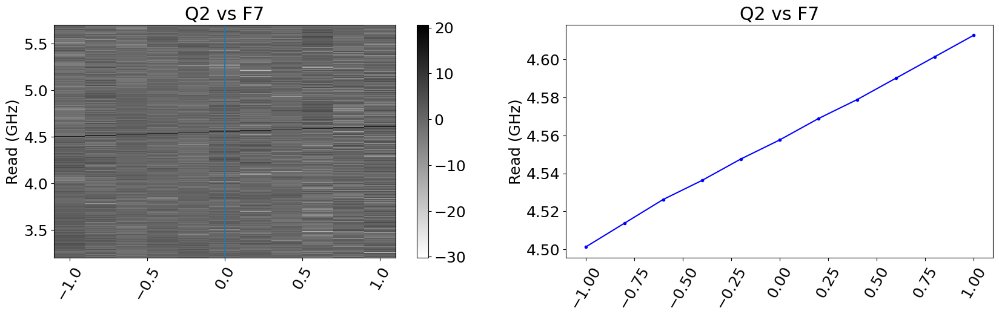

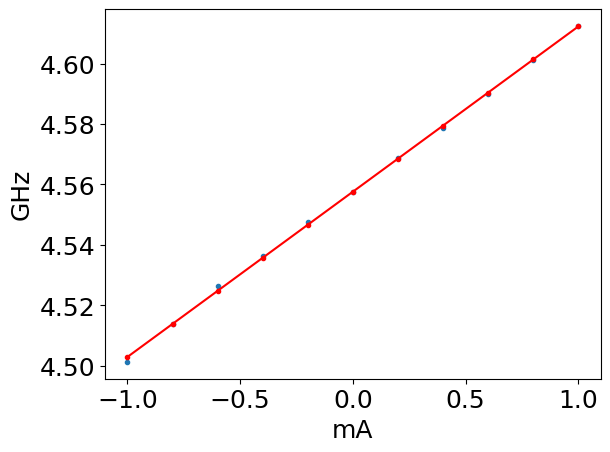

M =  0.05471590909090991
3
data_crosstalk\00000_flux_map-2025-01-18_r3_f7measuring_q3_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r3_f7measuring_q3_w_flux_q7.h5
minimum q freq 4.4475


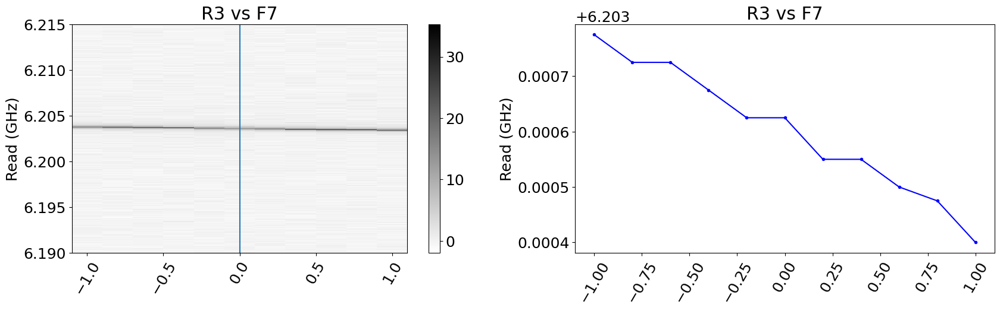

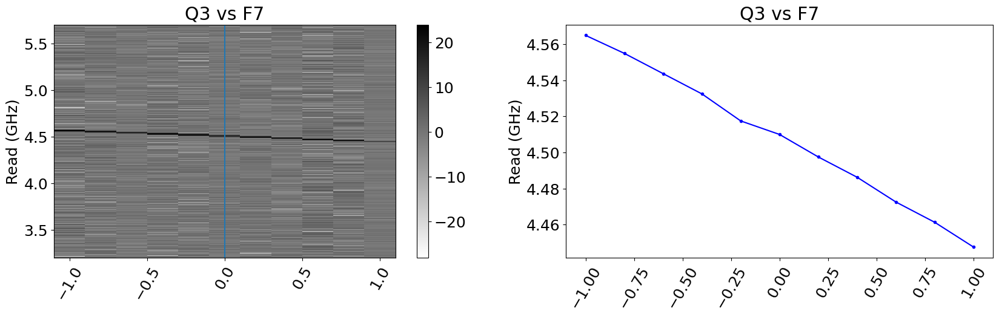

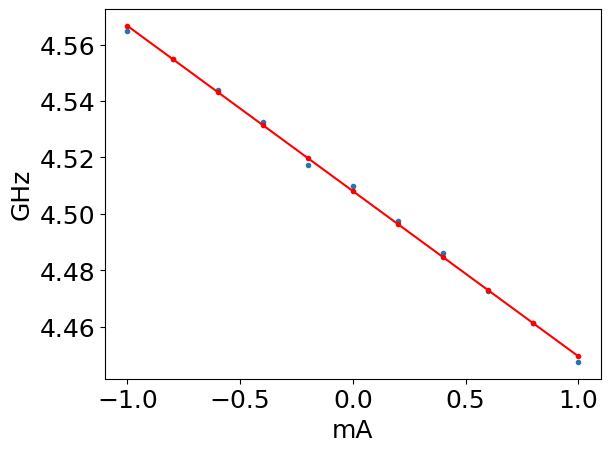

M =  -0.05857954545454474
4
data_crosstalk\00000_flux_map-2025-01-18_r0_f7measuring_q4_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r0_f7measuring_q4_w_flux_q7.h5
minimum q freq 4.4275


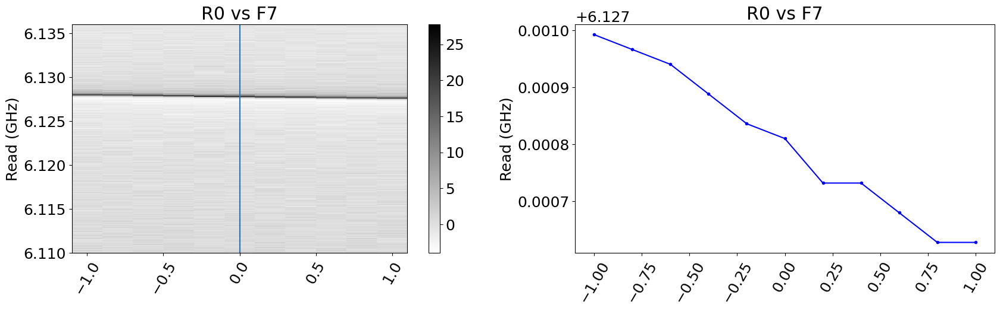

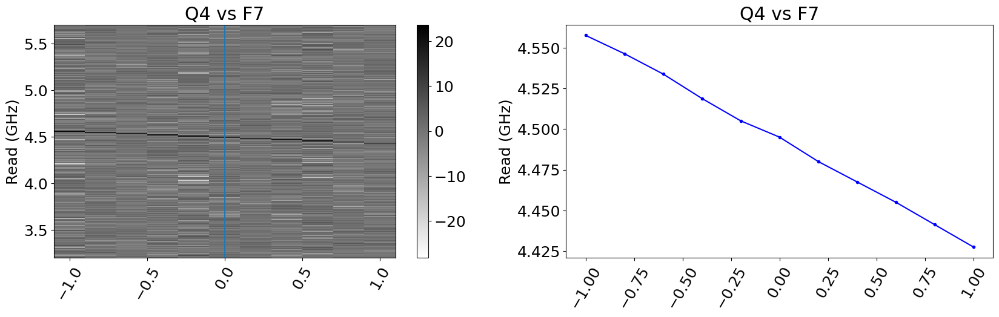

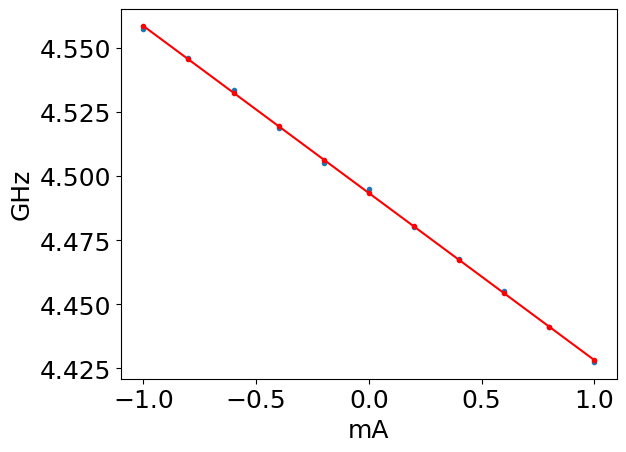

M =  -0.06517045454545388
5
data_crosstalk\00000_flux_map-2025-01-18_r4_f7measuring_q5_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r4_f7measuring_q5_w_flux_q7.h5
minimum q freq 4.43125


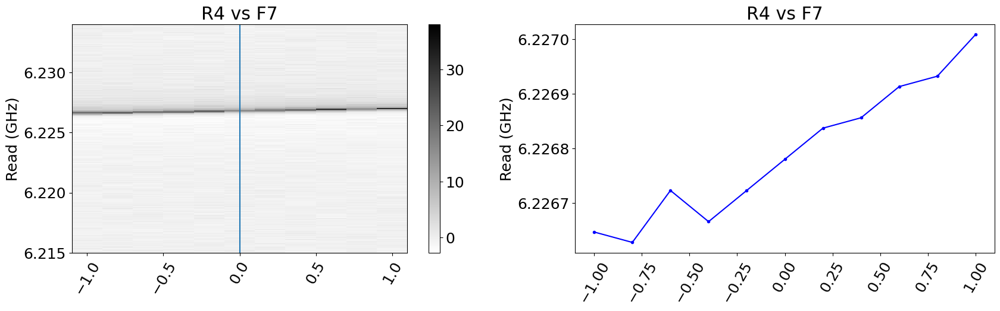

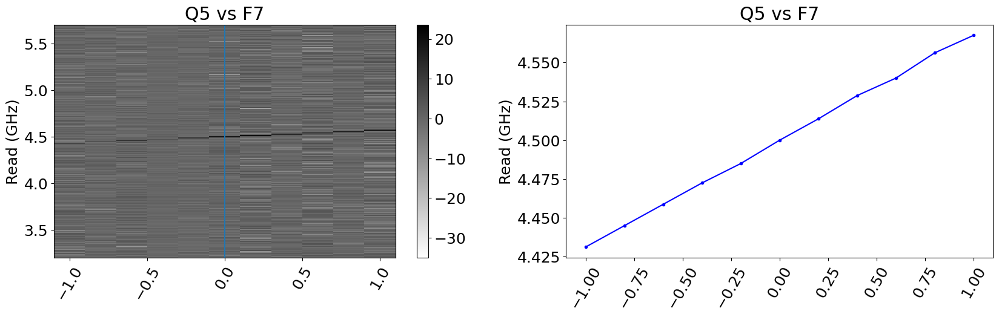

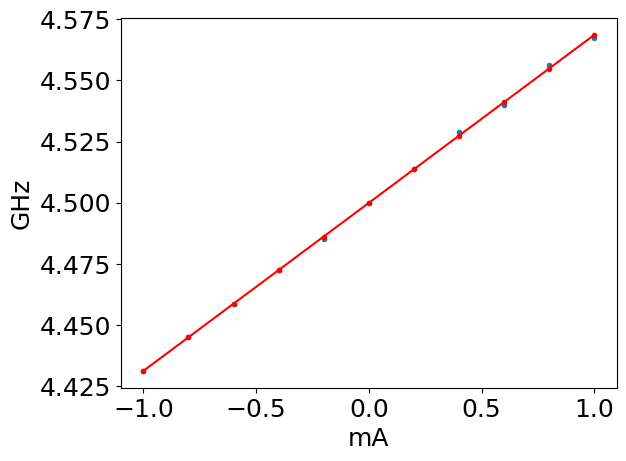

M =  0.06869318181818214
6
data_crosstalk\00000_flux_map-2025-01-18_r1_f7measuring_q6_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r1_f7measuring_q6_w_flux_q7.h5
minimum q freq 4.4475


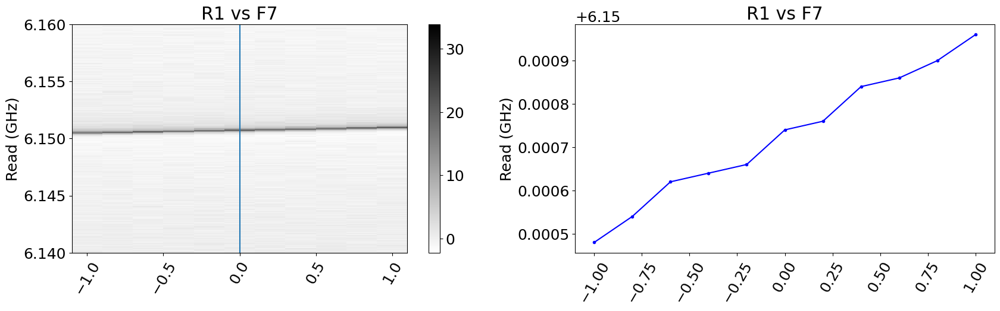

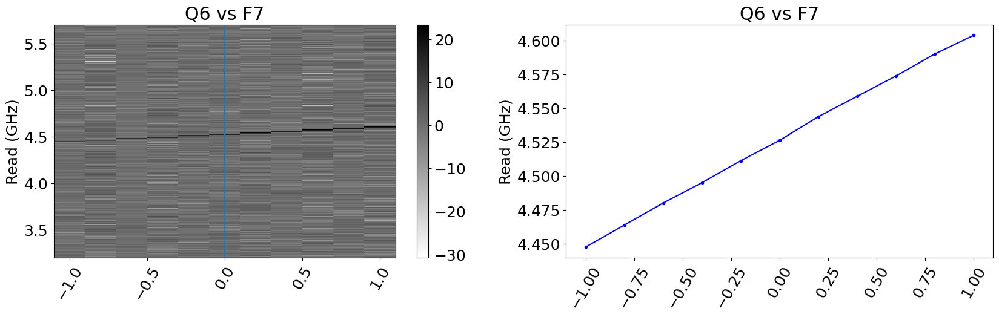

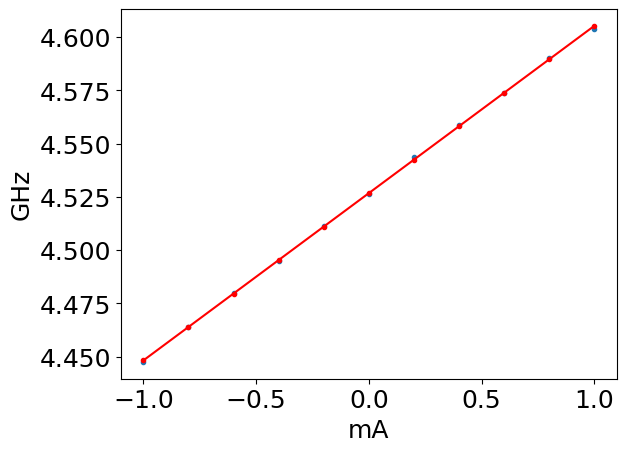

M =  0.07852272727272781
7
data_crosstalk\00000_flux_map-2025-01-18_r6_f7measuring_q7_w_flux_q7.h5
True
data_crosstalk\00000_flux_map-2025-01-18_r6_f7measuring_q7_w_flux_q7.h5
minimum q freq 4.2425


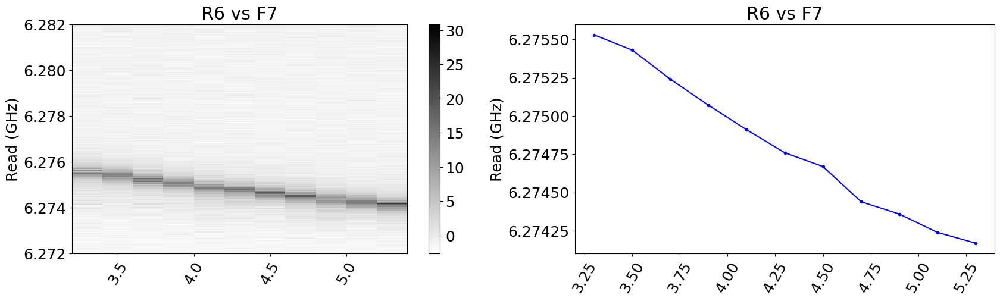

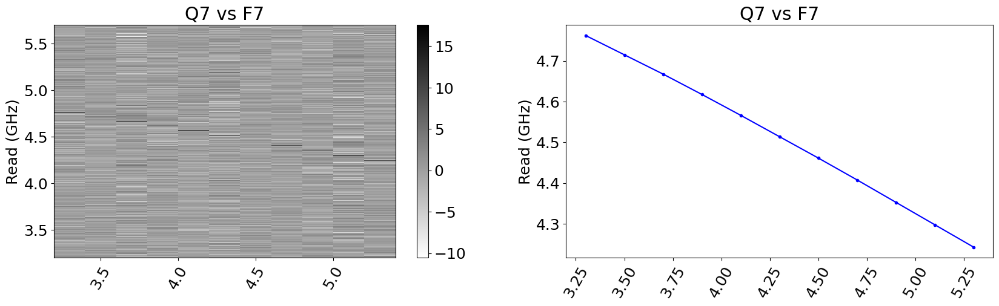

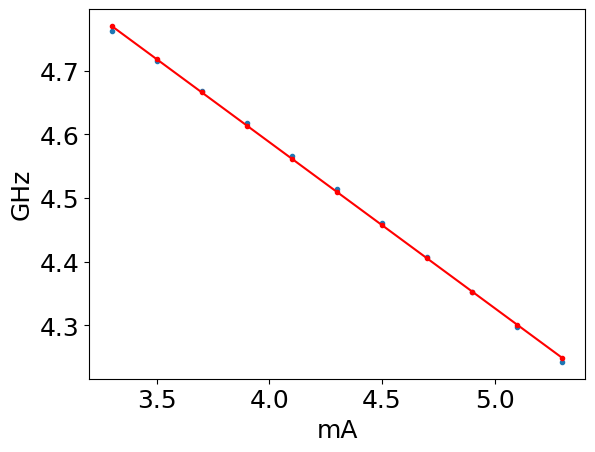

M =  -0.2609090909090913


In [169]:
flux_ind = 7

for q_ind in range(num_qubits):
    
    res_freqs = [0.0]*8
    lowss = [2.5e-3]*8
    diag_range = [0.0]*8

    for ii in [q_ind]:
        print(ii)
        jj = int(flux_ind)
        filename = sup_filename_list[q_ind][flux_ind]
        print(filename)
        print(os.path.isfile(filename))
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename,'r') as a:
                    print(filename)

                    for ss in ['R', 'Q']:
                        figure(figsize=(20,5))
                        if ss=='R':
                            title = ss + str(qubit_order[2][ii]) + ' vs F' + str(jj)
                        else:
                            title = ss + str(ii) + ' vs F' + str(jj)
                        subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        #freq_max = [fithanger_new_withQc(array(freq)/1e9,-data[ind]+max(data[ind]))[0] for ind in range(len(flux))]

                        pcolormesh(flux,freq/1e9,data.T,cmap=cm.gist_yarg)
                        colorbar()
                        plt.axis('tight')

                        axvline(lowss[ii-1])
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                        subplot(122,xlabel='',ylabel='Read (GHz)',title= title)
                        plot(flux,freq_max,'b.-')
                        axes = plt.gca()
                        for label in axes.get_xmajorticklabels():
                            label.set_rotation(60)
                            label.set_horizontalalignment("center")

                    print ('minimum q freq', (min(freq_max)))

    show()

    xdata = flux
    ydata = freq_max

    if q_ind == 1:
        fit = np.polyfit(xdata[9:], ydata[9:], 1)
    else:
        fit = np.polyfit(xdata, ydata, 1)
    plot(xdata,ydata,'.')
    plot(xdata,fit[0]*xdata + fit[1],'r.-')
    xlabel('mA')
    ylabel('GHz')
    show()

    print('M = ',fit[0])
    M[q_ind,flux_ind] = fit[0]

### M

In [178]:
M

array([[ 0.10034091, -0.02090909,  0.00840909,  0.02960227,  0.03630682,
         0.03971591,  0.04181818,  0.03846591],
       [-0.08519345,  0.125625  , -0.01232955,  0.02176136,  0.03931818,
         0.05      ,  0.05      ,  0.04375   ],
       [-0.07585227, -0.06573864,  0.15386364,  0.01210227,  0.03994318,
         0.05107955,  0.05596591,  0.05471591],
       [ 0.06806818,  0.05954545,  0.05375   , -0.17642045, -0.03403409,
        -0.05102273, -0.05926136, -0.05857955],
       [ 0.06232955,  0.05676136,  0.05056818,  0.03630682, -0.18329545,
        -0.04982955, -0.06011364, -0.06517045],
       [-0.05613636, -0.05295455, -0.04886364, -0.03681818, -0.01375   ,
         0.21710227,  0.05909091,  0.06869318],
       [-0.05267045, -0.05079545, -0.04846591, -0.04011364, -0.02210227,
         0.00960227,  0.23721591,  0.07852273],
       [ 0.054375  ,  0.05335227,  0.05181818,  0.04772727,  0.03693182,
         0.00886364, -0.0225    , -0.26090909]])

In [179]:
dc_crosstalk = np.zeros((num_qubits,num_qubits))
for i in range(num_qubits):
    dc_crosstalk[i,:] = M[i,:]/M[i,i]
  
print(dc_crosstalk*100)

[[100.         -20.8380521    8.38052095  29.50169875  36.18346546
   39.58097395  41.67610419  38.33522084]
 [-67.81568349 100.          -9.81456355  17.32247852  31.29805518
   39.80099502  39.80099502  34.82587065]
 [-49.29837518 -42.72525849 100.           7.86558346  25.96011817
   33.19793205  36.37370753  35.56129985]
 [-38.58293076 -33.75201288 -30.46698873 100.          19.29146538
   28.92109501  33.59098229  33.20450886]
 [-34.0049597  -30.96714197 -27.5883447  -19.80781153 100.
   27.18536888  32.79603224  35.55486671]
 [-25.85710547 -24.39152054 -22.50719707 -16.95891128  -6.33342057
  100.          27.21800576  31.64093169]
 [-22.20359281 -21.41317365 -20.43113772 -16.91017964  -9.31736527
    4.04790419 100.          33.10179641]
 [-20.84059233 -20.44860627 -19.86062718 -18.29268293 -14.15505226
   -3.39721254   8.62369338 100.        ]]


In [181]:
N =np.linalg.inv(M)
N

array([[ 6.83327086, -0.67552537, -1.27460971,  1.24393107,  0.74995104,
        -0.32311227, -0.17817878,  0.02154793],
       [ 1.78520137,  5.92718939, -0.97337771,  1.50498524,  1.25790103,
        -0.80342469, -0.4339359 ,  0.05872437],
       [ 1.51377262,  0.75028308,  4.9269114 ,  1.39384181,  1.47377141,
        -0.92733199, -0.60874706,  0.27379316],
       [ 1.48937322,  0.73575034,  0.22483848, -4.43460188,  1.59990918,
        -1.14989046, -0.84598993,  0.42877961],
       [ 1.68689477,  0.88667675,  0.25777888,  0.27184527, -4.51610162,
        -1.52562914, -1.16902284,  0.76494573],
       [ 1.64034361,  0.90509036,  0.31378668,  0.2115292 ,  0.58739724,
         4.22618573, -1.31178209,  0.98309086],
       [ 1.7211131 ,  0.97039352,  0.37594164,  0.12784644,  0.45017134,
        -0.73054324,  4.07870115,  1.38933153],
       [ 2.50831726,  1.42741718,  0.56969479,  0.06725003,  0.34076122,
        -0.63552871, -0.9632971 , -3.66157679]])

In [189]:
TRM = np.zeros((num_qubits,num_qubits))

for i in range(num_qubits):
    TRM[:,i] = N[:,i]/N[i,i]

TRM

array([[ 1.        , -0.11397061, -0.2587036 , -0.28050569, -0.1660616 ,
        -0.07645482, -0.04368518, -0.00588488],
       [ 0.26125137,  1.        , -0.19756347, -0.33937325, -0.27853692,
        -0.19010634, -0.10639071, -0.016038  ],
       [ 0.22152972,  0.12658328,  1.        , -0.31431047, -0.32633708,
        -0.21942528, -0.14925022, -0.07477466],
       [ 0.21795905,  0.1241314 ,  0.04563477,  1.        , -0.35426775,
        -0.27208706, -0.2074165 , -0.11710245],
       [ 0.24686491,  0.14959481,  0.05232058, -0.06130094,  1.        ,
        -0.36099434, -0.28661645, -0.20891156],
       [ 0.24005248,  0.15270144,  0.06368831, -0.0476997 , -0.13006732,
         1.        , -0.3216176 , -0.26848839],
       [ 0.25187251,  0.163719  ,  0.07630371, -0.02882929, -0.0996814 ,
        -0.17286113,  1.        , -0.37943531],
       [ 0.36707417,  0.2408253 ,  0.11562919, -0.01516484, -0.07545473,
        -0.15037879, -0.23617742,  1.        ]])

In [192]:
pt = [0, 0, 0, 1, 0, 0, 0, 0, 0]
pt[1:] * TRM[:, 2] + dac_offset

array([-0.002, -0.004,  0.997, -0.003, -0.004, -0.009, -0.02 , -0.024])

In [193]:
np.dot(TRM,pt[1:])

array([-0.2587036 , -0.19756347,  1.        ,  0.04563477,  0.05232058,
        0.06368831,  0.07630371,  0.11562919])

In [194]:
pt = [0, 0, 0, 1.5, 0, 0, 0, 0, 0]
np.dot(TRM,pt[1:])

array([-0.3880554 , -0.2963452 ,  1.5       ,  0.06845216,  0.07848087,
        0.09553247,  0.11445557,  0.17344379])

In [205]:
pt = [0, 0, 1, 0, 0, 0, 0, 0, 0]
np.dot(TRM,pt[1:])

array([-0.11397061,  1.        ,  0.12658328,  0.1241314 ,  0.14959481,
        0.15270144,  0.163719  ,  0.2408253 ])

In [219]:
pt = [0, 0, 1, 0, 0, 0, 0, 0, 0]

pt_target_sweep = np.linspace(-1, 1, 5)
pt_target_temp = copy(pt)
sweep_index = 1

for ii,sweep_target in enumerate(pt_target_sweep):
    print('\n\n')
    print('flux target =', sweep_target)
    pt_target_temp[sweep_index+1] = sweep_target
    print('unmodified pt', pt_target_temp)
    pt = np.dot(TRM,pt_target_temp[1:])
    pt = np.insert(pt, 0, pt_target_temp[0])
    print('With crosstalk correction!')
    print('flux actual =', pt)
    print('\n\n')




flux target = -1.0
unmodified pt [0, 0, -1.0, 0, 0, 0, 0, 0, 0]
With crosstalk correction!
flux actual = [ 0.          0.11397061 -1.         -0.12658328 -0.1241314  -0.14959481
 -0.15270144 -0.163719   -0.2408253 ]






flux target = -0.5
unmodified pt [0, 0, -0.5, 0, 0, 0, 0, 0, 0]
With crosstalk correction!
flux actual = [ 0.          0.0569853  -0.5        -0.06329164 -0.0620657  -0.0747974
 -0.07635072 -0.0818595  -0.12041265]






flux target = 0.0
unmodified pt [0, 0, 0.0, 0, 0, 0, 0, 0, 0]
With crosstalk correction!
flux actual = [0. 0. 0. 0. 0. 0. 0. 0. 0.]






flux target = 0.5
unmodified pt [0, 0, 0.5, 0, 0, 0, 0, 0, 0]
With crosstalk correction!
flux actual = [ 0.         -0.0569853   0.5         0.06329164  0.0620657   0.0747974
  0.07635072  0.0818595   0.12041265]






flux target = 1.0
unmodified pt [0, 0, 1.0, 0, 0, 0, 0, 0, 0]
With crosstalk correction!
flux actual = [ 0.         -0.11397061  1.          0.12658328  0.1241314   0.14959481
  0.15270144  0.16371

In [215]:
TRM
crosstalk = []
crosstalk.append(np.ones((num_qubits)))
for v in TRM:
    crosstalk.append(v)
crosstalk

[array([1., 1., 1., 1., 1., 1., 1., 1.]),
 array([ 1.        , -0.11397061, -0.2587036 , -0.28050569, -0.1660616 ,
        -0.07645482, -0.04368518, -0.00588488]),
 array([ 0.26125137,  1.        , -0.19756347, -0.33937325, -0.27853692,
        -0.19010634, -0.10639071, -0.016038  ]),
 array([ 0.22152972,  0.12658328,  1.        , -0.31431047, -0.32633708,
        -0.21942528, -0.14925022, -0.07477466]),
 array([ 0.21795905,  0.1241314 ,  0.04563477,  1.        , -0.35426775,
        -0.27208706, -0.2074165 , -0.11710245]),
 array([ 0.24686491,  0.14959481,  0.05232058, -0.06130094,  1.        ,
        -0.36099434, -0.28661645, -0.20891156]),
 array([ 0.24005248,  0.15270144,  0.06368831, -0.0476997 , -0.13006732,
         1.        , -0.3216176 , -0.26848839]),
 array([ 0.25187251,  0.163719  ,  0.07630371, -0.02882929, -0.0996814 ,
        -0.17286113,  1.        , -0.37943531]),
 array([ 0.36707417,  0.2408253 ,  0.11562919, -0.01516484, -0.07545473,
        -0.15037879, -0.2361774

## Trying the correction

### new data functions

In [254]:
# pt_target = [dc coil, f0, f1, f2, f3, f4, f5, f6, f7]
def flux_msmt_w_crosstalk(pt_target, fname_tag, msmt_index=0):
    

    print("Configuring the PNAX")
    # turning off the pulses
    nwa.write("SENS:PULS0 0")  # automatically sync ADC to pulse gen
    nwa.write("SENS:PULS1 0")
    nwa.write("SENS:PULS2 0")
    nwa.write("SENS:PULS3 0")
    nwa.write("SENS:PULS4 0")
    # turning on the inverting
    nwa.write("SENS:PULS1:INV 1")
    nwa.write("SENS:PULS2:INV 1")
    nwa.write("SENS:PULS3:INV 1")
    nwa.write("SENS:PULS4:INV 1")

    nwa.set_timeout(10E3)
    nwa.clear_traces()
    nwa.setup_measurement("S21")
    # nwa.set_ifbw(ifbw[Res_index])
    # nwa.set_sweep_points(sweep_pts)
    # nwa.setup_take(averages_state=True)
    # nwa.set_averages_and_group_count(avgs, True)
    # print "PNAX Configured. IFBW = %f Hz, NumPts = %d, Avgs = %d " %(ifbw[Res_index],sweep_pts,avgs)

    dummy_freq = 5.0e9
    dummy_power = -50

    if isTakeData:

        vary_param = "flux"
        print("Swept Parameter: %s" % (vary_param))

        fname_list = []
        for jj in range(num_qubits):
            Qind = jj
            prefix = "flux_map-" + str(datetime.date.today()) + "_r" + str(Qind) + fname_tag

            fname = get_next_filename(expt_path, prefix, suffix='.h5')
            print(fname)
            fname = os.path.join(expt_path, fname)
            fname_list = np.append(fname_list,fname)



        print('\n\n')
        print('flux target =', pt_target)
        pt = np.dot(TRM,pt_target_temp[1:])
        pt = np.insert(pt, 0, pt_target[0])
        print('With crosstalk correction!')
        print('flux actual =', pt)
        print('\n\n')

        if set_YOKO:
            drive_YOKO(pt)
        
        if set_DACs:
            drive_DACs(pt)

        print('\n\n')

        # sweep all qubits
        if measureAllQubits:
            for jj in range(num_qubits):

                Qind = jj

                with SlabFile(fname_list[jj], 'a') as f:
                    print("ISD:LJFJF")
                    print(nwa.get_settings())
                    f.save_settings(nwa.get_settings())

                print("Set up for a Single Tone Sweep")
                nwa.set_ifbw(ifbw[Qind])
                nwa.set_sweep_points(sweep_pts)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs, True)
                nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                probe_start=read_freq_start[Qind],
                                                probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                two_tone=0)

                data = nwa.take_one_in_mag_phase()

                fpoints = data[0]
                mags = data[1]
                phases = data[2]
                print("finished downloading")
                #time.sleep(na.get_query_sleep())

                freq_peak = fpoints[argmin(mags)]

                print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                nwa.set_ifbw(ifbw2[Qind])
                nwa.set_sweep_points(sweep_pts2)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs2, True)
                nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                read_power=read_power[Qind],
                                                probe_start=drive_freq_start[Qind],
                                                probe_stop=drive_freq_stop[Qind],
                                                probe_power=drive_power[Qind], two_tone=1)

                data = nwa.take_one_in_mag_phase()

                fpoints2 = data[0]
                mags2 = data[1]
                phases2 = data[2]
                print("finished downloading")
                print('\n')
                # time.sleep(na.get_query_sleep())

                #freq_peak_q = fpoints2[argmax(mags2)]
                #print "QubitFreq =", freq_peak_q

                with SlabFile(fname_list[Qind], 'a') as f:
                    f.append_pt((vary_param + 'dc_pts'), pt_target[0])
                    f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                    for ii in range(num_qubits):
                        f.append_pt((vary_param + str(ii) + '_pts'), pt_target[ii+1])
                        f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                    f.append_line('fpts-r', fpoints)
                    f.append_line('mags-r', mags)
                    f.append_line('phases-r', phases)
                    f.append_line('fpts-q', fpoints2)
                    f.append_line('mags-q', mags2)
                    f.append_line('phases-q', phases2)
                    # f.append_line('read_freq',read_freqs)
                    f.append_pt('read_power', read_power[Qind])
                    f.append_pt('probe_power', drive_power[Qind])
                    f.append_pt('read_freq', freq_peak)
        else: 
            jj = msmt_index
            Qind = jj

            with SlabFile(fname_list[jj], 'a') as f:
                print("ISD:LJFJF")
                print(nwa.get_settings())
                f.save_settings(nwa.get_settings())

            print("Set up for a Single Tone Sweep")
            nwa.set_ifbw(ifbw[Qind])
            nwa.set_sweep_points(sweep_pts)
            nwa.setup_take(averages_state=True)
            nwa.set_averages_and_group_count(avgs, True)
            nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                            probe_start=read_freq_start[Qind],
                                            probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                            two_tone=0)

            data = nwa.take_one_in_mag_phase()

            fpoints = data[0]
            mags = data[1]
            phases = data[2]
            print("finished downloading")
            #time.sleep(na.get_query_sleep())

            freq_peak = fpoints[argmin(mags)]

            print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
            nwa.set_ifbw(ifbw2[Qind])
            nwa.set_sweep_points(sweep_pts2)
            nwa.setup_take(averages_state=True)
            nwa.set_averages_and_group_count(avgs2, True)
            nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                            read_power=read_power[Qind],
                                            probe_start=drive_freq_start[Qind],
                                            probe_stop=drive_freq_stop[Qind],
                                            probe_power=drive_power[Qind], two_tone=1)

            data = nwa.take_one_in_mag_phase()

            fpoints2 = data[0]
            mags2 = data[1]
            phases2 = data[2]
            print("finished downloading")
            print('\n')
            # time.sleep(na.get_query_sleep())

            #freq_peak_q = fpoints2[argmax(mags2)]
            #print "QubitFreq =", freq_peak_q

            with SlabFile(fname_list[Qind], 'a') as f:
                f.append_pt((vary_param + 'dc_pts'), pt_target[0])
                f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                for ii in range(num_qubits):
                    f.append_pt((vary_param + str(ii) + '_pts'), pt_target[ii+1])
                    f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                f.append_line('fpts-r', fpoints)
                f.append_line('mags-r', mags)
                f.append_line('phases-r', phases)
                f.append_line('fpts-q', fpoints2)
                f.append_line('mags-q', mags2)
                f.append_line('phases-q', phases2)
                # f.append_line('read_freq',read_freqs)
                f.append_pt('read_power', read_power[Qind])
                f.append_pt('probe_power', drive_power[Qind])
                f.append_pt('read_freq', freq_peak)


        print(fname)

In [222]:
# pt_target = [dc coil, f0, f1, f2, f3, f4, f5, f6, f7]
def flux_msmt_sweep_w_crosstalk(pt_target, pt_target_sweep, fname_tag, sweep_index, msmt_index=0):
    

    print("Configuring the PNAX")
    # turning off the pulses
    nwa.write("SENS:PULS0 0")  # automatically sync ADC to pulse gen
    nwa.write("SENS:PULS1 0")
    nwa.write("SENS:PULS2 0")
    nwa.write("SENS:PULS3 0")
    nwa.write("SENS:PULS4 0")
    # turning on the inverting
    nwa.write("SENS:PULS1:INV 1")
    nwa.write("SENS:PULS2:INV 1")
    nwa.write("SENS:PULS3:INV 1")
    nwa.write("SENS:PULS4:INV 1")

    nwa.set_timeout(10E3)
    nwa.clear_traces()
    nwa.setup_measurement("S21")
    # nwa.set_ifbw(ifbw[Res_index])
    # nwa.set_sweep_points(sweep_pts)
    # nwa.setup_take(averages_state=True)
    # nwa.set_averages_and_group_count(avgs, True)
    # print "PNAX Configured. IFBW = %f Hz, NumPts = %d, Avgs = %d " %(ifbw[Res_index],sweep_pts,avgs)

    dummy_freq = 5.0e9
    dummy_power = -50
    pt_target_temp = copy(pt_target)

    if isTakeData:

        vary_param = "flux"
        print("Swept Parameter: %s" % (vary_param))

        fname_list = []
        for jj in range(num_qubits):
            Qind = jj
            prefix = "flux_map-" + str(datetime.date.today()) + "_r" + str(Qind) + "_f" + str(sweep_index) + fname_tag

            fname = get_next_filename(expt_path, prefix, suffix='.h5')
            print(fname)
            fname = os.path.join(expt_path, fname)
            fname_list = np.append(fname_list,fname)

        
        for ii,sweep_target in enumerate(pt_target_sweep):
            print('\n\n')
            print('flux target =', sweep_target)
            pt_target_temp[sweep_index+1] = sweep_target
            print('unmodified pt', pt_target_temp)
            pt = np.dot(TRM,pt_target_temp[1:])
            pt = np.insert(pt, 0, pt_target_temp[0])
            print('With crosstalk correction!')
            print('flux actual =', pt)
            print('\n\n')

            if sweep_index == -1:
                drive_YOKO(pt)
            else:
                drive_DACs(pt)

            print('\n\n')

            # sweep all qubits
            if measureAllQubits:
                for jj in range(num_qubits):

                    Qind = jj

                    with SlabFile(fname_list[jj], 'a') as f:
                        print("ISD:LJFJF")
                        print(nwa.get_settings())
                        f.save_settings(nwa.get_settings())

                    print("Set up for a Single Tone Sweep")
                    nwa.set_ifbw(ifbw[Qind])
                    nwa.set_sweep_points(sweep_pts)
                    nwa.setup_take(averages_state=True)
                    nwa.set_averages_and_group_count(avgs, True)
                    nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                    probe_start=read_freq_start[Qind],
                                                    probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                    two_tone=0)

                    data = nwa.take_one_in_mag_phase()

                    fpoints = data[0]
                    mags = data[1]
                    phases = data[2]
                    print("finished downloading")
                    #time.sleep(na.get_query_sleep())

                    freq_peak = fpoints[argmin(mags)]

                    print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                    nwa.set_ifbw(ifbw2[Qind])
                    nwa.set_sweep_points(sweep_pts2)
                    nwa.setup_take(averages_state=True)
                    nwa.set_averages_and_group_count(avgs2, True)
                    nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                    read_power=read_power[Qind],
                                                    probe_start=drive_freq_start[Qind],
                                                    probe_stop=drive_freq_stop[Qind],
                                                    probe_power=drive_power[Qind], two_tone=1)

                    data = nwa.take_one_in_mag_phase()

                    fpoints2 = data[0]
                    mags2 = data[1]
                    phases2 = data[2]
                    print("finished downloading")
                    print('\n')
                    # time.sleep(na.get_query_sleep())

                    #freq_peak_q = fpoints2[argmax(mags2)]
                    #print "QubitFreq =", freq_peak_q

                    with SlabFile(fname_list[Qind], 'a') as f:
                        f.append_pt((vary_param + 'dc_pts'), pt_target_temp[0])
                        f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                        for ii in range(num_qubits):
                            f.append_pt((vary_param + str(ii) + '_pts'), pt_target_temp[ii+1])
                            f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                        f.append_line('fpts-r', fpoints)
                        f.append_line('mags-r', mags)
                        f.append_line('phases-r', phases)
                        f.append_line('fpts-q', fpoints2)
                        f.append_line('mags-q', mags2)
                        f.append_line('phases-q', phases2)
                        # f.append_line('read_freq',read_freqs)
                        f.append_pt('read_power', read_power[Qind])
                        f.append_pt('probe_power', drive_power[Qind])
                        f.append_pt('read_freq', freq_peak)
            else: 
                jj = msmt_index
                Qind = jj

                with SlabFile(fname_list[jj], 'a') as f:
                    print("ISD:LJFJF")
                    print(nwa.get_settings())
                    f.save_settings(nwa.get_settings())

                print("Set up for a Single Tone Sweep")
                nwa.set_ifbw(ifbw[Qind])
                nwa.set_sweep_points(sweep_pts)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs, True)
                nwa.setup_two_tone_measurement(read_frequency=dummy_freq, read_power=read_power[Qind],
                                                probe_start=read_freq_start[Qind],
                                                probe_stop=read_freq_stop[Qind], probe_power=dummy_power,
                                                two_tone=0)

                data = nwa.take_one_in_mag_phase()

                fpoints = data[0]
                mags = data[1]
                phases = data[2]
                print("finished downloading")
                #time.sleep(na.get_query_sleep())

                freq_peak = fpoints[argmin(mags)]

                print("Set up for Two Tone Measurement, ReadFreq =", freq_peak)
                nwa.set_ifbw(ifbw2[Qind])
                nwa.set_sweep_points(sweep_pts2)
                nwa.setup_take(averages_state=True)
                nwa.set_averages_and_group_count(avgs2, True)
                nwa.setup_two_tone_measurement(read_frequency=freq_peak,
                                                read_power=read_power[Qind],
                                                probe_start=drive_freq_start[Qind],
                                                probe_stop=drive_freq_stop[Qind],
                                                probe_power=drive_power[Qind], two_tone=1)

                data = nwa.take_one_in_mag_phase()

                fpoints2 = data[0]
                mags2 = data[1]
                phases2 = data[2]
                print("finished downloading")
                print('\n')
                # time.sleep(na.get_query_sleep())

                #freq_peak_q = fpoints2[argmax(mags2)]
                #print "QubitFreq =", freq_peak_q

                with SlabFile(fname_list[Qind], 'a') as f:
                    f.append_pt((vary_param + 'dc_pts'), pt_target_temp[0])
                    f.append_pt((vary_param + 'dc_actual_pts'), pt[0])
                    for ii in range(num_qubits):
                        f.append_pt((vary_param + str(ii) + '_pts'), pt_target_temp[ii+1])
                        f.append_pt((vary_param + str(ii) + '_actual_pts'), pt[ii+1])
                    f.append_line('fpts-r', fpoints)
                    f.append_line('mags-r', mags)
                    f.append_line('phases-r', phases)
                    f.append_line('fpts-q', fpoints2)
                    f.append_line('mags-q', mags2)
                    f.append_line('phases-q', phases2)
                    # f.append_line('read_freq',read_freqs)
                    f.append_pt('read_power', read_power[Qind])
                    f.append_pt('probe_power', drive_power[Qind])
                    f.append_pt('read_freq', freq_peak)

        

        print(fname)

### test

In [223]:
measureAllQubits = 1
sweep = linspace(-1, 1, 5)
expt_path = os.getcwd() + '\data_crosstalk_testing'
fname_tag = '_crosstalk_test_1'
drive_Yoko_and_DACs(zero_flux)
flux_msmt_sweep_w_crosstalk(zero_flux, sweep, fname_tag, 1)

Driving YOKO at (0.000) mA
Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  -1.00006103515625
target 131072
end of ramp - None


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  3
Driving DAC at (0.003) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  4
Driving DAC at (0.004) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  5
Driving DAC at (0.009) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  6
Driving DAC at (0.020) mA
old reading =  0.0
target 131072
end of ramp - RAMP


Flux line for qubit  7
Driving DAC at (0.024) mA
old reading =  0.0
target 131072
end of ramp - RAMP
Configuring the PNAX
Swept Parameter: flux
00000_flux_map-2

In [233]:
f = 1
filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f'+str(f)+fname_tag+'.h5')
print(filename_list)


['data_crosstalk_testing\\00000_flux_map-2025-01-19_r0_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r1_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r2_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r3_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r4_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r5_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r6_f1_crosstalk_test_1.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r7_f1_crosstalk_test_1.h5']


[array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ])]
[array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,  0. ,  0.5,  1. ]), array([-1. , -0.5,

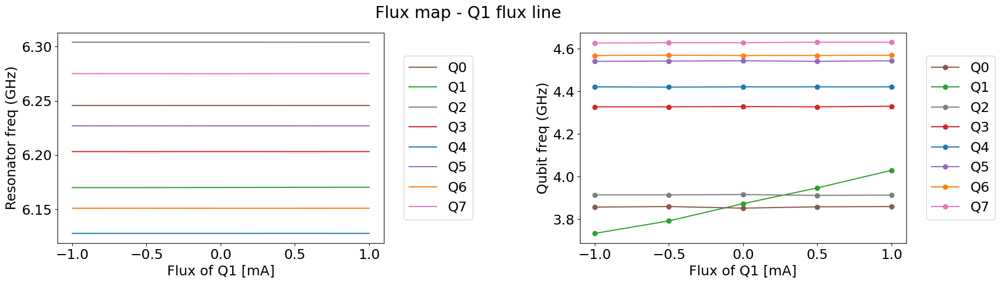

In [240]:
flux_list = []
wr_list = []
wq_list = []
jj = 1 # flux line

for ii in range(num_qubits):

    
    filename = filename_list[ii]
    
    if os.path.isfile(filename):
        if os.path.getsize(filename) > 1000*10:  #in bytes
            with SlabFile(filename) as a:
                # print(filename)

                for ss in ['R', 'Q']:
#                     figure(figsize=(12,4))
#                     title = ss + str(4-ii) + ' vs F' + str(jj+1)
#                     subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                    flux = array(a['flux'+str(jj)+'_actual_pts'])
                    freq = array(a['fpts-'+ss.lower()])[0]
                    data = array(a['mags-'+ss.lower()])
                    data1=data.T
                    if ss=='R':
                        data1 = -(data1-mean(data1,axis=0))
                    else:
                        data1 = +(data1-mean(data1,axis=0))
                    data=data1.T

                    data_max = [argmax(i) for i in data]
                    freq_max = [freq[i]/1e9 for i in data_max]
                    
                    flux_list.append(flux)
                    print(flux_list)
                    
                    if ss == 'R':
                        wr_list.append(freq_max)
                    else:
                        wq_list.append(freq_max)

figure(figsize=(20,5))
subplots_adjust(wspace=0.6, hspace=0.3)
suptitle('Flux map - Q'+str(jj)+' flux line')

subplot(121,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Resonator freq (GHz)')
for ii in range(num_qubits):
    plot(flux_list[0],wr_list[ii],  color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))

# reordering the labels 
handles, labels = plt.gca().get_legend_handles_labels() 

# specify order 
order = [5, 2, 7, 3, 0, 4, 1, 6] 

# pass handle & labels lists along with order as below 
plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
# legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')
    
subplot(122,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Qubit freq (GHz)')
for ii in range(num_qubits):
    plot(flux_list[0],wq_list[ii],'-o',color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))
    
# reordering the labels 
handles, labels = plt.gca().get_legend_handles_labels() 

# specify order 
order = [5, 2, 7, 3, 0, 4, 1, 6] 

# pass handle & labels lists along with order as below 
plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
# legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')

PUUUURRRRRRR, i slayed

looks like Q0, brown, moved bc of the voided crossing which is to be expected

### Full tests

In [237]:
zero_flux

[0, 0, 0, 0, 0, 0, 0, 0, 0]

In [241]:
measureAllQubits = 1
sweep = linspace(-1, 1, 11)
expt_path = os.getcwd() + '\data_crosstalk_testing'
fname_tag_crosstalk = '_w_crosstalk'
fname_tag_no = '_no_crosstalk'
for f in range(num_qubits):
    drive_Yoko_and_DACs(zero_flux)
    flux_msmt_sweep(zero_flux, sweep, fname_tag_no, f)
    flux_msmt_sweep_w_crosstalk(zero_flux, sweep, fname_tag_crosstalk, f)
drive_Yoko_and_DACs(zero_flux)

Driving YOKO at (0.000) mA
Driving DAC at ( 0.000, 0.000, 0.000, 0.000,0.000, 0.000, 0.000, 0.000 ) mA


Flux line for qubit  0
Driving DAC at (0.002) mA
old reading =  -0.113983154296875
target 131072
end of ramp - None


Flux line for qubit  1
Driving DAC at (0.004) mA
old reading =  0.9999847412109375
target 131072
end of ramp - None


Flux line for qubit  2
Driving DAC at (0.003) mA
old reading =  0.1265716552734375
target 131072
end of ramp - None


Flux line for qubit  3
Driving DAC at (0.003) mA
old reading =  0.1241302490234375
target 131072
end of ramp - None


Flux line for qubit  4
Driving DAC at (0.004) mA
old reading =  0.1495361328125
target 131072
end of ramp - None


Flux line for qubit  5
Driving DAC at (0.009) mA
old reading =  0.1526641845703125
target 131072
end of ramp - None


Flux line for qubit  6
Driving DAC at (0.020) mA
old reading =  0.1636505126953125
target 131072
end of ramp - None


Flux line for qubit  7
Driving DAC at (0.024) mA
old reading =  0.240783

### W crosstalk

In [249]:
sup_filename_list = []

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f0'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f1'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f2'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f3'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f4'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f5'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f6'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f7'+fname_tag_crosstalk+'.h5')
sup_filename_list.append(filename_list)

for qubit_filename in sup_filename_list:
    print(qubit_filename)

['data_crosstalk_testing\\00000_flux_map-2025-01-19_r0_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r1_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r2_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r3_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r4_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r5_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r6_f0_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r7_f0_w_crosstalk.h5']
['data_crosstalk_testing\\00000_flux_map-2025-01-19_r0_f1_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r1_f1_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r2_f1_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r3_f1_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r4_f1_w_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_

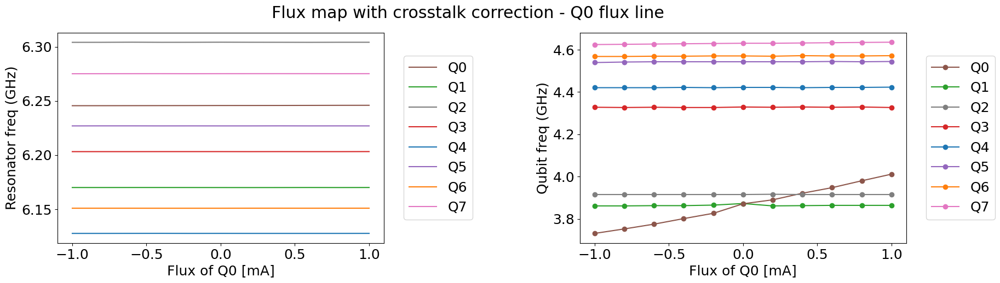

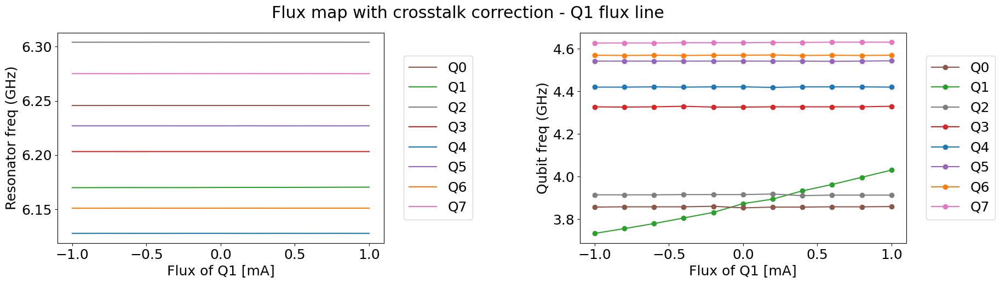

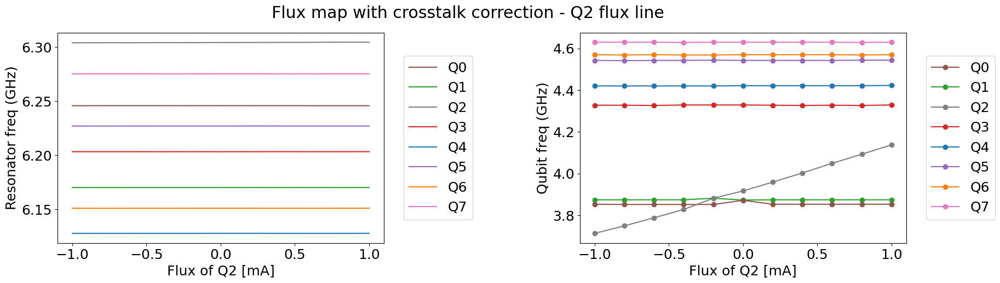

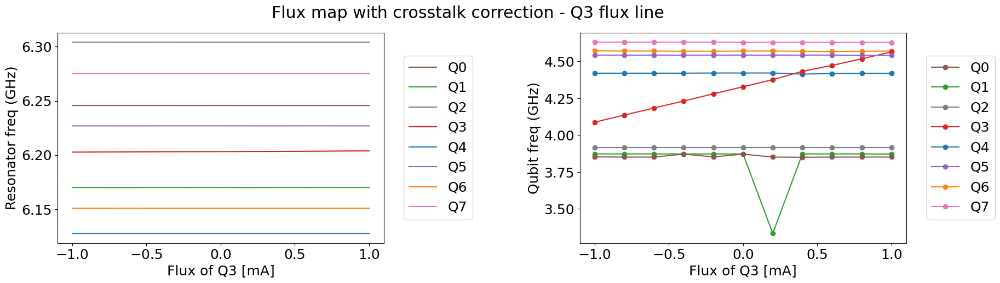

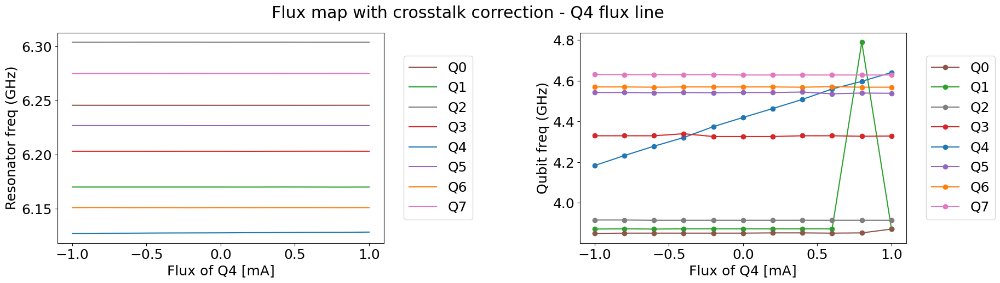

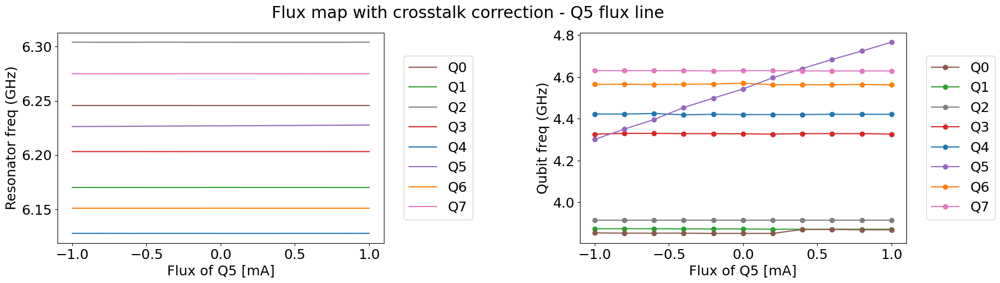

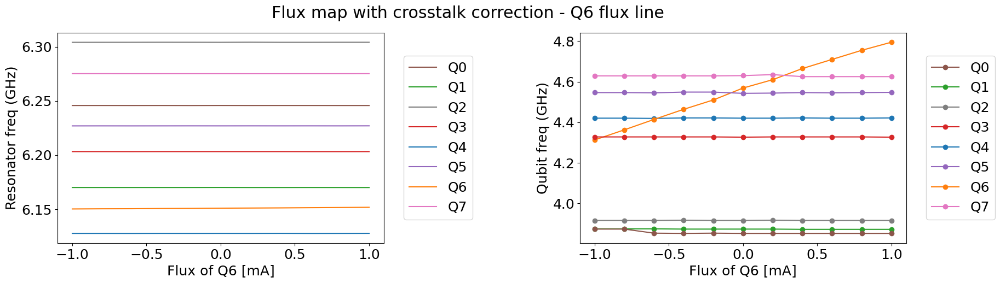

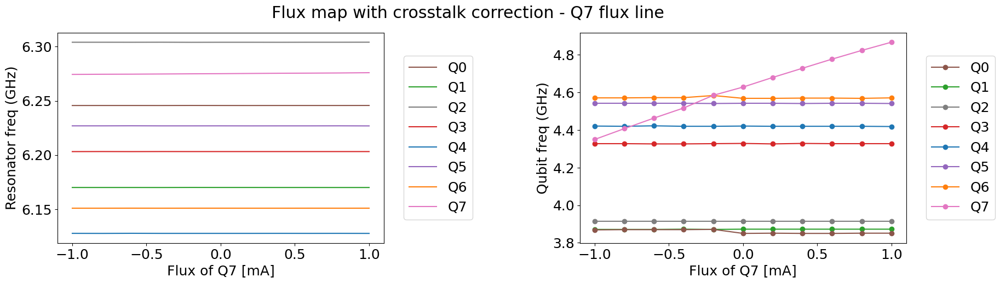

In [250]:
for jj in range(num_qubits):

    flux_list = []
    wr_list = []
    wq_list = []

    for ii in range(num_qubits):
        # jj = 0
        
        filename = sup_filename_list[jj][ii]
        
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename) as a:
                    # print(filename)

                    for ss in ['R', 'Q']:
    #                     figure(figsize=(12,4))
    #                     title = ss + str(4-ii) + ' vs F' + str(jj+1)
    #                     subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_actual_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        
                        flux_list.append(flux)
                        # print(flux_list)
                        
                        if ss == 'R':
                            wr_list.append(freq_max)
                        else:
                            wq_list.append(freq_max)

    figure(figsize=(20,5))
    subplots_adjust(wspace=0.6, hspace=0.3)
    suptitle('Flux map with crosstalk correction - Q'+str(jj)+' flux line')

    subplot(121,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Resonator freq (GHz)')
    for ii in range(num_qubits):
        plot(flux_list[0],wr_list[ii],  color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))

    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')
        
    subplot(122,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Qubit freq (GHz)')
    for ii in range(num_qubits):
        plot(flux_list[0],wq_list[ii],'-o',color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))
        
    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')

### No crosstalk

In [251]:
sup_filename_list = []

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f0'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f1'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f2'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-19_r'+str(q)+'_f3'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f4'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f5'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f6'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

filename_list = []
for q in range(num_qubits):
    filename_list.append(r'data_crosstalk_testing\00000_flux_map-2025-01-20_r'+str(q)+'_f7'+fname_tag_no+'.h5')
sup_filename_list.append(filename_list)

for qubit_filename in sup_filename_list:
    print(qubit_filename)

['data_crosstalk_testing\\00000_flux_map-2025-01-19_r0_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r1_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r2_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r3_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r4_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r5_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r6_f0_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r7_f0_no_crosstalk.h5']
['data_crosstalk_testing\\00000_flux_map-2025-01-19_r0_f1_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r1_f1_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r2_f1_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r3_f1_no_crosstalk.h5', 'data_crosstalk_testing\\00000_flux_map-2025-01-19_r4_f1_no_crosstalk.h5', 'data_crosstalk_testing

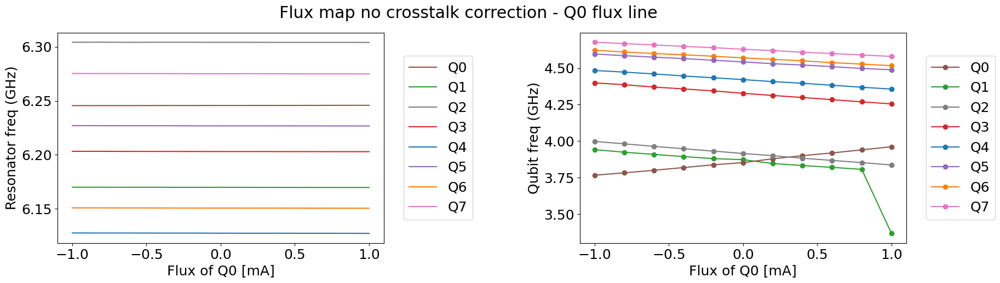

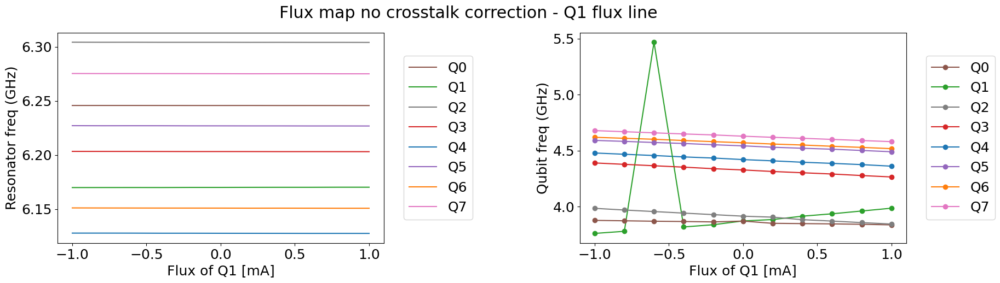

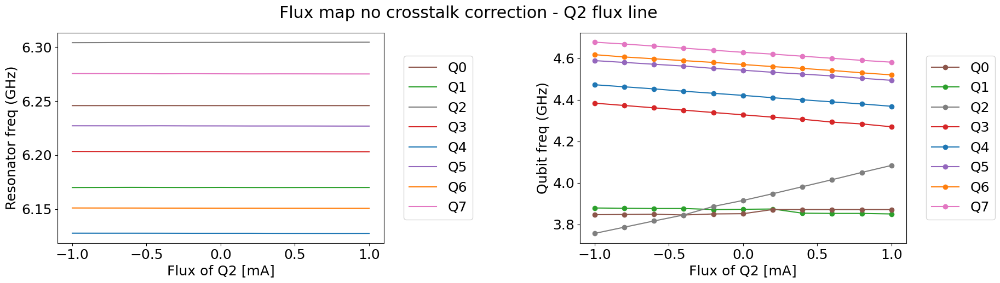

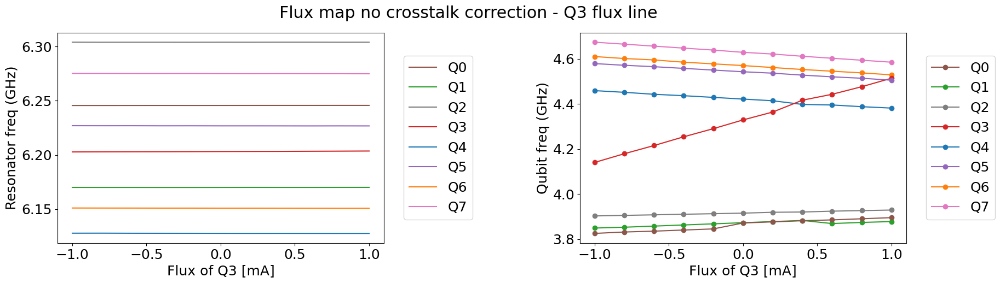

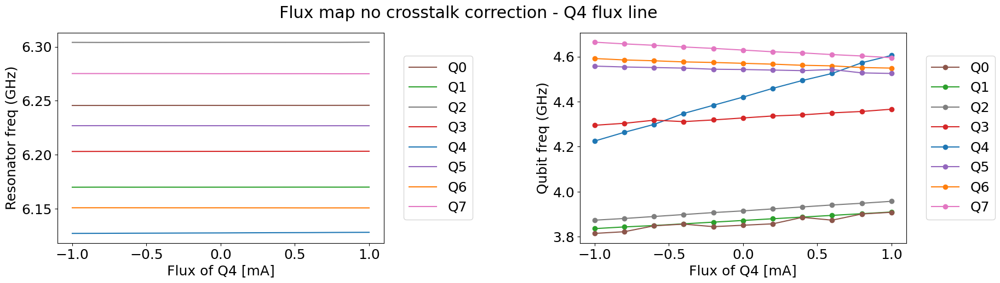

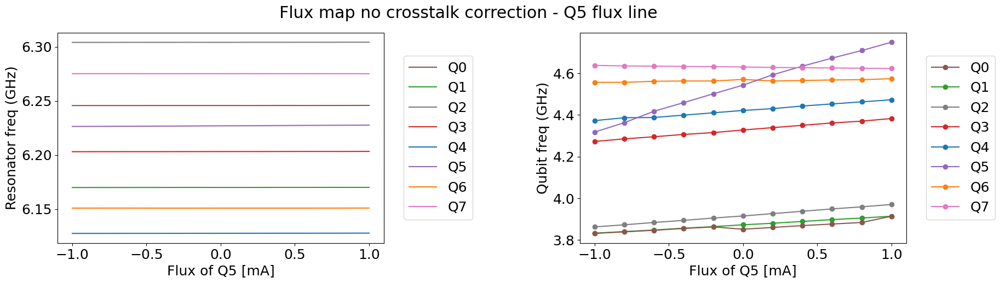

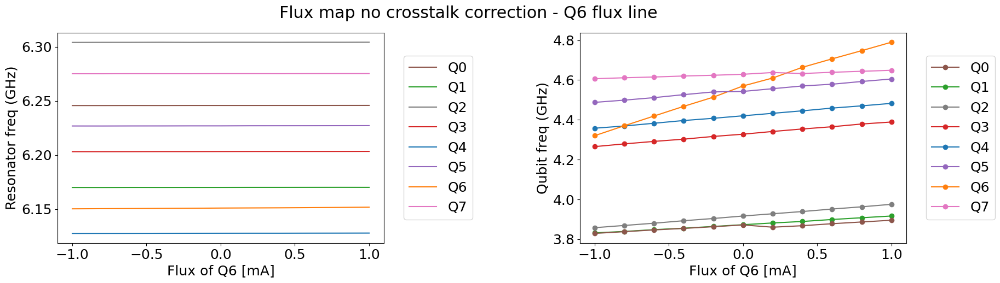

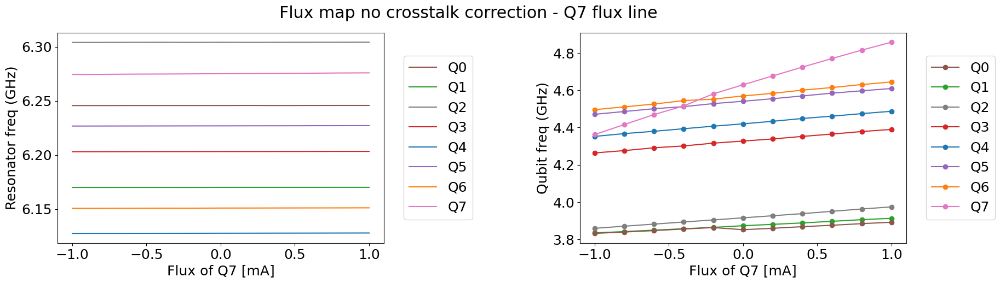

In [252]:
for jj in range(num_qubits):

    flux_list = []
    wr_list = []
    wq_list = []

    for ii in range(num_qubits):
        # jj = 0
        
        filename = sup_filename_list[jj][ii]
        
        if os.path.isfile(filename):
            if os.path.getsize(filename) > 1000*10:  #in bytes
                with SlabFile(filename) as a:
                    # print(filename)

                    for ss in ['R', 'Q']:
    #                     figure(figsize=(12,4))
    #                     title = ss + str(4-ii) + ' vs F' + str(jj+1)
    #                     subplot(121,xlabel='',ylabel='Read (GHz)',title= title)

                        flux = array(a['flux'+str(jj)+'_actual_pts'])
                        freq = array(a['fpts-'+ss.lower()])[0]
                        data = array(a['mags-'+ss.lower()])
                        data1=data.T
                        if ss=='R':
                            data1 = -(data1-mean(data1,axis=0))
                        else:
                            data1 = +(data1-mean(data1,axis=0))
                        data=data1.T

                        data_max = [argmax(i) for i in data]
                        freq_max = [freq[i]/1e9 for i in data_max]
                        
                        flux_list.append(flux)
                        # print(flux_list)
                        
                        if ss == 'R':
                            wr_list.append(freq_max)
                        else:
                            wq_list.append(freq_max)

    figure(figsize=(20,5))
    subplots_adjust(wspace=0.6, hspace=0.3)
    suptitle('Flux map no crosstalk correction - Q'+str(jj)+' flux line')

    subplot(121,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Resonator freq (GHz)')
    for ii in range(num_qubits):
        plot(flux_list[0],wr_list[ii],  color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))

    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')
        
    subplot(122,xlabel='Flux of Q'+str(jj)+' [mA]',ylabel='Qubit freq (GHz)')
    for ii in range(num_qubits):
        plot(flux_list[0],wq_list[ii],'-o',color = 'C'+str(ii), label = 'Q'+str(qubit_order[1][ii]))
        
    # reordering the labels 
    handles, labels = plt.gca().get_legend_handles_labels() 

    # specify order 
    order = [5, 2, 7, 3, 0, 4, 1, 6] 

    # pass handle & labels lists along with order as below 
    plt.legend([handles[i] for i in order], [labels[i] for i in order],bbox_to_anchor = (1.04,0.5),loc = 'center left') 
    # legend(bbox_to_anchor = (1.04,0.5),loc = 'center left')